# Feature Regression Analysis for HeLa cell morphomic data 

Data: Extracted from CellProfiler pipeline '2D_3Channel_HeLa_simple'. Raw data files: /Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/

Images: 20240815_HeLa_TMI_40X - Max projections

Groups= Treatments:
   
    Ble - Blebbistatin - Deactivates myosin motors; decreases contractility in actin

    H11 - H1152 - selective ROCK inhibitor; decreases actomyosin contractility

    Y27 - Y27632 - ROCK inhibitor; decreases actomyosin contractility


Questions: what are correlations telling us about how cell and nuclear shape effect eachother?

Units: All measurements are originally in pixels. Resolution is 2.8963 pixels/micron

Image Metadata:
Width:  353.5542 microns (1024)
Height:  353.5542 microns (1024)
Size:  1MB
Resolution:  2.8963 pixels per micron
Pixel size: 0.3453x0.3453 micron^2
ID: -87
Bits per pixel: 8 (grayscale LUT)
Display range: 0-255
Pixel value range: 0-255
No threshold
Magnification: 0.75

This notebook is found here: /Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Scripts_analysis/Feature_Regression_analysis_20240815_HeLa_TMI_40X.ipynb


    

## Install libraries

In [1]:
#!pip install pingouin
#!pip install plotly

import matplotlib.pyplot as plt
import math
import numpy as np
import os
import pandas as pd
import pingouin as pg
import plotly.graph_objects as go
import seaborn as sns
import statsmodels.api as sm
import time

from matplotlib.colors import LinearSegmentedColormap
from matplotlib.patches import ConnectionPatch
from scipy import stats
from scipy.stats import f
from scipy.stats import f_oneway
from scipy.stats import probplot, shapiro
from scipy.stats import levene, bartlett
from scipy.stats import kruskal
from scipy.stats import pearsonr
from scipy.stats import norm
from scipy.stats import ttest_ind
from sklearn.ensemble import RandomForestRegressor
from sklearn.inspection import permutation_importance
from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from tabulate import tabulate


## Get the data 

In [2]:
# Define the file path
file_path = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/"

# Load the CSV files using the full path
nuc_df = pd.read_csv(file_path + "2D_3Channel_Output_FilteredNucleiMyo.csv")
myo_df = pd.read_csv(file_path + "2D_3Channel_Output_cellsMyo.csv")
#act_df = pd.read_csv(file_path + "2D_3channel_Output_cellsAct.csv")

# check the shape of the dataframes - must have the same number of rows
print("Nuc DF shape:", nuc_df.shape)
print("Myo DF shape:", myo_df.shape)
#print("Act DF shape:", act_df.shape)

# function to add prefix to column names and subset columns
def rename_and_subset(df, prefix, keep_columns=None):
    # Rename columns with prefix
    df = df.rename(columns={col: f"{prefix}_{col}" for col in df.columns if col not in keep_columns})
    # Drop columns that start with "FileName" except for the ones in keep_columns
    df = df.loc[:, ~df.columns.str.startswith("FileName") | df.columns.isin(keep_columns)]
    return df

# Columns to keep from one of the CSV files
keep_columns = ['ImageNumber', 'ObjectNumber', 'FileName_Act']

# Rename and subset columns for myo_df and act_df with prefixes
myo_df = rename_and_subset(myo_df, "myo", keep_columns)
#act_df = rename_and_subset(act_df, "act", keep_columns)
nuc_df = rename_and_subset(nuc_df, "nuc", keep_columns)

# Combine the three dataframes (excluding the first 8 columns of nuc_df)
combined_df = pd.concat([nuc_df[keep_columns], nuc_df.iloc[:, 8:], myo_df.iloc[:, 8:]], axis=1) #put this actin code back in after the myo [], if also using the actin channel data: act_df.iloc[:, 3:]

# Add a "group" column based on the values in FileName_Act
combined_df['group'] = combined_df['FileName_Act'].apply(
    lambda x: 'Ble' if pd.notna(x) and 'Ble_' in x else (
        'H11' if pd.notna(x) and 'H11_' in x else (
            'Y27' if pd.notna(x) and 'Y27_' in x else (
                'Ctl' if pd.notna(x) and 'Ctl_' in x else None
            )
        )
    )
)
# Convert the group column to a categorical type
combined_df['group'] = combined_df['group'].astype('category')

# Get the column names of the combined dataframe
column_names = combined_df.columns.tolist()

print(combined_df.shape)
column_names


Nuc DF shape: (9571, 134)
Myo DF shape: (9571, 92)
(9571, 214)


['ImageNumber',
 'ObjectNumber',
 'FileName_Act',
 'nuc_AreaShape_Area',
 'nuc_AreaShape_BoundingBoxArea',
 'nuc_AreaShape_BoundingBoxMaximum_X',
 'nuc_AreaShape_BoundingBoxMaximum_Y',
 'nuc_AreaShape_BoundingBoxMinimum_X',
 'nuc_AreaShape_BoundingBoxMinimum_Y',
 'nuc_AreaShape_Center_X',
 'nuc_AreaShape_Center_Y',
 'nuc_AreaShape_CentralMoment_0_0',
 'nuc_AreaShape_CentralMoment_0_1',
 'nuc_AreaShape_CentralMoment_0_2',
 'nuc_AreaShape_CentralMoment_0_3',
 'nuc_AreaShape_CentralMoment_1_0',
 'nuc_AreaShape_CentralMoment_1_1',
 'nuc_AreaShape_CentralMoment_1_2',
 'nuc_AreaShape_CentralMoment_1_3',
 'nuc_AreaShape_CentralMoment_2_0',
 'nuc_AreaShape_CentralMoment_2_1',
 'nuc_AreaShape_CentralMoment_2_2',
 'nuc_AreaShape_CentralMoment_2_3',
 'nuc_AreaShape_Compactness',
 'nuc_AreaShape_ConvexArea',
 'nuc_AreaShape_Eccentricity',
 'nuc_AreaShape_EquivalentDiameter',
 'nuc_AreaShape_EulerNumber',
 'nuc_AreaShape_Extent',
 'nuc_AreaShape_FormFactor',
 'nuc_AreaShape_HuMoment_0',
 'nuc_AreaS

# Data Cleaning

In [3]:
# Remove problematic rows (identified by visual inspection of images, poorly segmented images)

# List of FileName_Act rows to remove
problematic_files = [
    "Ble_repA_011.czi_MAX_C2.tiff",
    "Ble_repA_012.czi_MAX_C2.tiff",
    "Ble_repA_015.czi_MAX_C2.tiff",
    "Ble_repA_018.czi_MAX_C2.tiff",
    "Ble_repA_021.czi_MAX_C2.tiff",
    "Ble_repA_022.czi_MAX_C2.tiff",
    "Ble_repA_026.czi_MAX_C2.tiff",
    "Ble_repA_027.czi_MAX_C2.tiff",
    "Ble_repA_034.czi_MAX_C2.tiff",
    "Ble_repA_035.czi_MAX_C2.tiff",
    "Ble_repA_039.czi_MAX_C2.tiff",
    "Ble_repA_040.czi_MAX_C2.tiff",
    "Ble_repA_046.czi_MAX_C2.tiff",
    "Ble_repA_047.czi_MAX_C2.tiff",
    "Ble_repA_051.czi_MAX_C2.tiff",
    "Ble_repA_052.czi_MAX_C2.tiff",
    "Ctl_repA_011.czi_MAX_C2.tiff",
    "Ctl_repA_015.czi_MAX_C2.tiff",
    "Ctl_repB_006.czi_MAX_C2.tiff",
    "Ctl_repB_009.czi_MAX_C2.tiff",
    "Ctl_repB_013.czi_MAX_C2.tiff",
    "Ctl_repB_014.czi_MAX_C2.tiff",
    "Ctl_repB_016.czi_MAX_C2.tiff",
    "Ctl_repB_019.czi_MAX_C2.tiff",
    "Ctl_repB_020.czi_MAX_C2.tiff",
    "Ctl_repB_021.czi_MAX_C2.tiff",
    "Ctl_repB_025.czi_MAX_C2.tiff",
    "Ctl_repB_026.czi_MAX_C2.tiff",
    "Ctl_repB_027.czi_MAX_C2.tiff",
    "Ctl_repB_028.czi_MAX_C2.tiff",
    "Ctl_repB_030.czi_MAX_C2.tiff",
    "Ctl_repB_031.czi_MAX_C2.tiff",
    "H11_repA_003.czi_MAX_C2.tiff",
    "H11_repA_008.czi_MAX_C2.tiff",
    "H11_repA_017.czi_MAX_C2.tiff",
    "H11_repA_019.czi_MAX_C2.tiff",
    "H11_repA_020.czi_MAX_C2.tiff",
    "H11_repA_021.czi_MAX_C2.tiff",
    "H11_repA_022.czi_MAX_C2.tiff",
    "H11_repA_023.czi_MAX_C2.tiff",
    "H11_repA_024.czi_MAX_C2.tiff",
    "H11_repA_025.czi_MAX_C2.tiff",
    "H11_repA_026.czi_MAX_C2.tiff",
    "H11_repA_029.czi_MAX_C2.tiff",
    "Y27_repB_006.czi_MAX_C2.tiff",
    "Y27_repB_007.czi_MAX_C2.tiff",
    "Y27_repB_010.czi_MAX_C2.tiff",
    "Y27_repB_018.czi_MAX_C2.tiff",
    "Y27_repB_019.czi_MAX_C2.tiff",
    "Y27_repB_023.czi_MAX_C2.tiff",
    "Y27_repB_024.czi_MAX_C2.tiff",
    "Y27_repB_025.czi_MAX_C2.tiff",
    "Y27_repB_026.czi_MAX_C2.tiff",
    "Y27_repB_032.czi_MAX_C2.tiff",
    "Y27_repB_033.czi_MAX_C2.tiff",
    "Y27_repB_037.czi_MAX_C2.tiff",
    "Y27_repB_038.czi_MAX_C2.tiff",
    "Y27_repB_040.czi_MAX_C2.tiff",
    "Y27_repB_042.czi_MAX_C2.tiff",
    "Y27_repB_043.czi_MAX_C2.tiff",
    "Y27_repB_044.czi_MAX_C2.tiff",
    "Y27_repB_045.czi_MAX_C2.tiff",
    "Y27_repB_046.czi_MAX_C2.tiff",
    "Y27_repB_048.czi_MAX_C2.tiff"
]

# Remove the problematic rows
combined_df = combined_df[~combined_df['FileName_Act'].isin(problematic_files)]

len(problematic_files)
# print number of rows and columns
print(combined_df.shape)
print(len(problematic_files))

(6124, 214)
64


## add group column

In [4]:
# add group column
group = "group"

#get uniques from cell line column
group_list = combined_df[group].unique().tolist() 
print(group_list)

#get size of unique list
print(len(combined_df[group].unique()))

# Check for NaN values in the 'group' column
nan_count = combined_df[group].isnull().sum()
print(f"Number of NaN values in 'group' column: {nan_count}")

# Remove rows with NaN values in the 'group' column
df_clean = combined_df.dropna(subset=[group]).copy()

# Ensure all values in 'group' are strings
df_clean[group] = df_clean[group].astype(str)

# Remove rows with NaN values in any column
df_clean = combined_df.dropna(axis=1, how='all').copy()

#display(combined_df_clean)
print(df_clean.head())

# Print counts and NaNs for the 'Group' column
print("Counts in 'group' column:", df_clean['group'].value_counts())
print("Number of NaN values in 'group' column:", df_clean['group'].isnull().sum())

# Filter the DataFrame for rows where the 'group' column is NaN
nan_rows = combined_df[combined_df['group'].isna()]

# Select the 'ImageNumber' and 'ObjectNumber' columns
nan_info = nan_rows[['ImageNumber', 'ObjectNumber']]

# Convert to a list of tuples
nan_info_list = nan_info.values.tolist()

# Print the list
print(nan_info_list)
print(df_clean.shape)


['Ble', 'Ctl', 'H11', 'Y27']
4
Number of NaN values in 'group' column: 0
   ImageNumber  ObjectNumber                  FileName_Act  \
0            1             1  Ble_repA_001.czi_MAX_C2.tiff   
1            1             2  Ble_repA_001.czi_MAX_C2.tiff   
2            1             3  Ble_repA_001.czi_MAX_C2.tiff   
3            1             4  Ble_repA_001.czi_MAX_C2.tiff   
4            1             5  Ble_repA_001.czi_MAX_C2.tiff   

   nuc_AreaShape_Area  nuc_AreaShape_BoundingBoxArea  \
0                1983                           2700   
1                1762                           2401   
2                1627                           2120   
3                1941                           2436   
4                1841                           2394   

   nuc_AreaShape_BoundingBoxMaximum_X  nuc_AreaShape_BoundingBoxMaximum_Y  \
0                                 430                                 285   
1                                 336                          

## organize data

remove unneessary columns

make lists of column categories for inspection

In [6]:
# trim data to desired columns

# identify feature columns for each  channel
cols_area_shape = df_clean.filter(regex=r'_AreaShape_').columns.tolist()

# list of strings to exclude from the columns
exclude_strings = ['Bounding',
                'Center',
                'Tensor',
                'Number',
                'Factor',
                'Intensity',
                ]

exclude_cols = {col for col in cols_area_shape if any(exclude in col for exclude in exclude_strings)}

# Filter out columns with the exclude strings
cols_area_shape_filtered = list(set(cols_area_shape) - exclude_cols)

# Group column to identify classes
cols_group = 'group'

# Identification columns (first three columns of df_clean)
identification_cols = df_clean.columns[:3].tolist()

# Combine all selected columns for later use
feature_cols = identification_cols + cols_area_shape_filtered + [cols_group]

# Debug print to check the combined columns
print("Selected Columns:", feature_cols)

# Create the new DataFrame with the selected columns
df_features = df_clean[feature_cols].copy()

# Display the new DataFrame
print(df_features.head())
print(df_features.shape)

# get min, max and mean values for nuc area and perimeter
nuc_area_min = df_features['nuc_AreaShape_Area'].min()
nuc_area_max = df_features['nuc_AreaShape_Area'].max()
nuc_area_mean = df_features['nuc_AreaShape_Area'].mean()
nuc_perimeter_min = df_features['nuc_AreaShape_Perimeter'].min()
nuc_perimeter_max = df_features['nuc_AreaShape_Perimeter'].max()
nuc_perimeter_mean = df_features['nuc_AreaShape_Perimeter'].mean()

# display the values
print(f"Min Nucleus Area: {nuc_area_min}")
print(f"Max Nucleus Area: {nuc_area_max}")
print(f"Mean Nucleus Area: {nuc_area_mean}")
print(f"Min Nucleus Perimeter: {nuc_perimeter_min}")
print(f"Max Nucleus Perimeter: {nuc_perimeter_max}")
print(f"Mean Nucleus Perimeter: {nuc_perimeter_mean}")


Selected Columns: ['ImageNumber', 'ObjectNumber', 'FileName_Act', 'nuc_AreaShape_Orientation', 'nuc_AreaShape_ConvexArea', 'myo_AreaShape_CentralMoment_2_3', 'nuc_AreaShape_NormalizedMoment_0_2', 'myo_AreaShape_HuMoment_1', 'myo_AreaShape_HuMoment_4', 'nuc_AreaShape_NormalizedMoment_3_1', 'myo_AreaShape_CentralMoment_1_3', 'myo_AreaShape_SpatialMoment_2_3', 'nuc_AreaShape_HuMoment_3', 'myo_AreaShape_HuMoment_3', 'myo_AreaShape_CentralMoment_1_1', 'myo_AreaShape_NormalizedMoment_0_3', 'myo_AreaShape_SpatialMoment_0_1', 'myo_AreaShape_NormalizedMoment_1_2', 'nuc_AreaShape_HuMoment_2', 'nuc_AreaShape_NormalizedMoment_2_3', 'myo_AreaShape_MeanRadius', 'nuc_AreaShape_MinFeretDiameter', 'myo_AreaShape_HuMoment_6', 'nuc_AreaShape_SpatialMoment_0_2', 'nuc_AreaShape_NormalizedMoment_2_0', 'myo_AreaShape_Area', 'nuc_AreaShape_NormalizedMoment_1_1', 'nuc_AreaShape_SpatialMoment_2_3', 'nuc_AreaShape_Perimeter', 'myo_AreaShape_NormalizedMoment_0_2', 'nuc_AreaShape_NormalizedMoment_1_2', 'myo_AreaSh

## convert pixels to microns or microns squared

In [7]:
# Pixel to micron Conversion  ###########################################################

# Resolution in pixels per micron
resolution = 2.8963  # pixels per micron

# Calculate the conversion factor from pixels to microns
conversion_factor = 1 / resolution  # microns per pixel
conversion_factor_squared = conversion_factor ** 2  # microns squared per pixel squared

# List of columns to convert
strings_for_converting = [ 
    '_AreaShape_BoundingBoxArea',
    '_AreaShape_ConvexArea', 
    '_AreaShape_EquivalentDiameter',
    '_AreaShape_MajorAxisLength', 
    '_AreaShape_MaxFeretDiameter', 
    '_AreaShape_MaximumRadius',
    '_AreaShape_MeanRadius', 
    '_AreaShape_MedianRadius', 
    '_AreaShape_MinFeretDiameter',
    '_AreaShape_MinorAxisLength', 
    '_AreaShape_Perimeter', 
]

# List of columns that represent area (in square microns)
area_strings = [
    '_AreaShape_Area', 
    '_AreaShape_BoundingBoxArea', 
    '_AreaShape_ConvexArea'
]

columns_to_convert = []

# Apply conversion factor to the selected columns
for col in df_features.columns:
        if any(substring in col for substring in strings_for_converting):
            df_features[col] = df_features[col] * conversion_factor
        elif any(substring in col for substring in area_strings):
            df_features[col] = df_features[col] * conversion_factor_squared

# # Display the updated DataFrame - if needed
#print(df_features.head())
print(len(df_features))

# get min, max and mean values for nuc area and perimeter
nuc_area_min = df_features['nuc_AreaShape_Area'].min()
nuc_area_max = df_features['nuc_AreaShape_Area'].max()
nuc_area_mean = df_features['nuc_AreaShape_Area'].mean()
nuc_perimeter_min = df_features['nuc_AreaShape_Perimeter'].min()
nuc_perimeter_max = df_features['nuc_AreaShape_Perimeter'].max()
nuc_perimeter_mean = df_features['nuc_AreaShape_Perimeter'].mean()

# display the values
print(f"Min Nucleus Area (microns^2): {nuc_area_min}")
print(f"Max Nucleus Area (microns^2): {nuc_area_max}")
print(f"Mean Nucleus Area (microns^2): {nuc_area_mean}")
print(f"Min Nucleus Perimeter (microns): {nuc_perimeter_min}")
print(f"Max Nucleus Perimeter (microns): {nuc_perimeter_max}")
print(f"Mean Nucleus Perimeter (microns): {nuc_perimeter_mean}")


6124
Min Nucleus Area (microns^2): 0.11921006134729764
Max Nucleus Area (microns^2): 784.4022036652185
Mean Nucleus Area (microns^2): 189.59534896967455
Min Nucleus Perimeter (microns): 0.0
Max Nucleus Perimeter (microns): 122.29082237993647
Mean Nucleus Perimeter (microns): 51.78677809268365


## remove outliers

### First look at distributions of select data to estimate thresholds

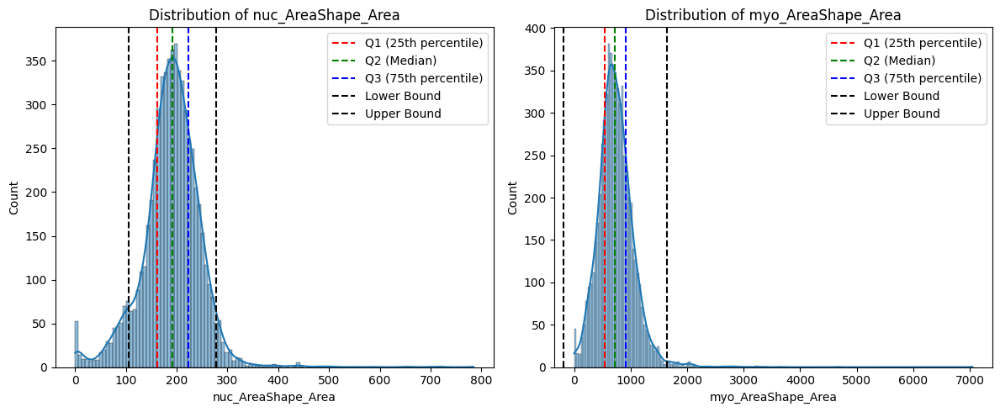

In [8]:
# plot the distribution of select columns 

# columns to plot
filter_cols = [
    "nuc_AreaShape_Area",
    "myo_AreaShape_Area"
]

multipliers = [0.9, 2.0]

# Plot the distribution of selected columns
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

for i, col in enumerate(filter_cols):
    sns.histplot(data=df_features, x=col, kde=True, ax=axes[i])
    axes[i].set_title(f"Distribution of {col}")

    # Calculate quartiles
    Q1 = df_features[col].quantile(0.25)
    Q2 = df_features[col].quantile(0.50)  # Median
    Q3 = df_features[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - multipliers[i] * IQR
    upper_bound = Q3 + multipliers[i] * IQR

    # Add vertical lines for quartiles
    axes[i].axvline(Q1, color='r', linestyle='--', label='Q1 (25th percentile)')
    axes[i].axvline(Q2, color='g', linestyle='--', label='Q2 (Median)')
    axes[i].axvline(Q3, color='b', linestyle='--', label='Q3 (75th percentile)')
    axes[i].axvline(lower_bound, color='k', linestyle='--', label='Lower Bound')
    axes[i].axvline(upper_bound, color='k', linestyle='--', label='Upper Bound')

    # Add legend
    axes[i].legend()
    
plt.tight_layout()
plt.show()


### Outlier removal using IQR of select columns

In [ ]:
# remove outleirs using Interquartile Range (IQR) based on two specified columns

# function to remove outliers using interquartile range (IQR) method
def remove_outliers(df, columns, multipliers):
    for i, col in enumerate(columns):
        if col in df.columns:
            Q1 = df[col].quantile(0.25)
            Q3 = df[col].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - multipliers[i] * IQR
            upper_bound = Q3 + multipliers[i] * IQR
            df = df[(df[col] >= lower_bound) & (df[col] <= upper_bound)]
    return df

# List of columns to exclude from outlier removal
exclude_columns = ['nuc_AreaShape_AspectRatio', 'myo_AreaShape_AspectRatio']

# Remove outliers from select columns
filter_cols = [
     "nuc_AreaShape_Area",
    "myo_AreaShape_Area"
]

multipliers = [1.5, 2.0]

# remove outliers
df_cleaned = remove_outliers(df_features, filter_cols, multipliers)

# show how many rows were removed
rows_removed = df_features.shape[0] - df_cleaned.shape[0]
print(f"Rows removed: {rows_removed}, of {len(df_features)} total")

# Save the DataFrame to the same directory as the original data
output_path = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/combined_converted_cleaned_data.csv"  # Replace with the actual path
df_cleaned.to_csv(output_path, index=False)
print(len(df_cleaned))

# print counts for each group
print(df_cleaned['group'].value_counts())

Rows removed: 312, of 6124 total
5812
group
Ble    2139
Y27    1458
H11    1240
Ctl     975
Name: count, dtype: int64


### test outlier removal consistancy

In [11]:
# Test consistency of outlier removal by comparing to outlier removal using Z-score method from nuclear minor axis and integrated intensity

# function to remove outliers using Z-score method
def remove_outliers_zscore(df, columns, threshold=4.0):
    for col in columns:
        if col in df.columns:
            z_scores = stats.zscore(df[col])
            df = df[abs(z_scores) < threshold]
    return df

# Remove outliers from all numerical columns using Z-score method
df_cleaned_zscore = remove_outliers_zscore(df_features, filter_cols, threshold=3.0)

# Show how many rows were removed
rows_removed_zscore = df_features.shape[0] - df_cleaned_zscore.shape[0]
print(f"Rows removed: {rows_removed}")

# Get the removed rows for both methods
removed_rows_iqr = df_features[~df_features.index.isin(df_cleaned.index)]
removed_rows_zscore = df_features[~df_features.index.isin(df_cleaned_zscore.index)]

# Check if the same rows are removed 
same_rows_removed = removed_rows_iqr.index.equals(removed_rows_zscore.index)
print(f"Same rows removed by both methods: {same_rows_removed}")

Rows removed: 312
Same rows removed by both methods: False


### visualize before and after outlier removal 

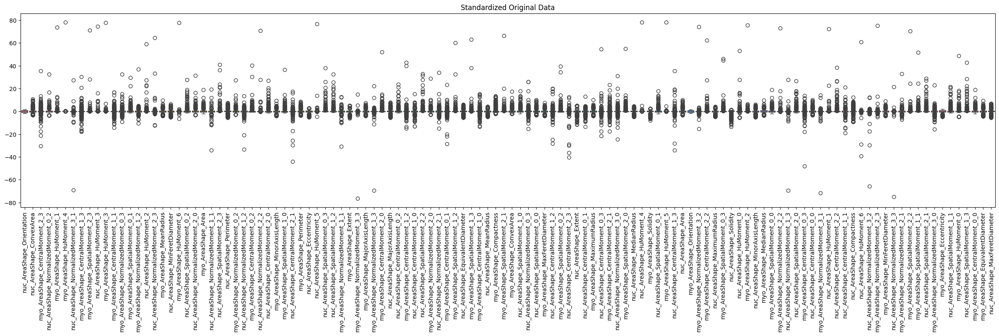

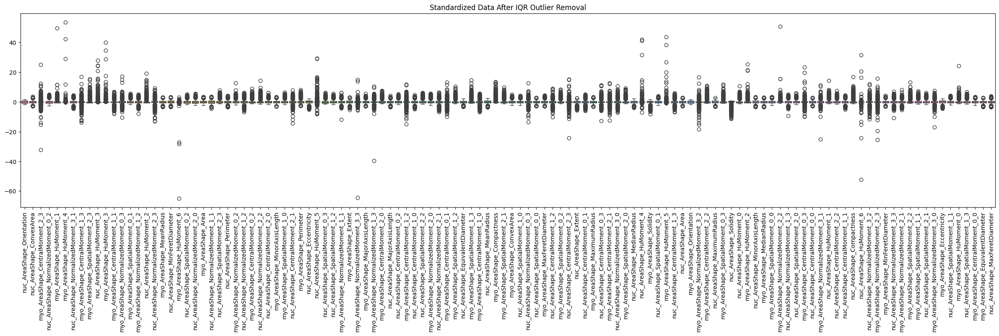

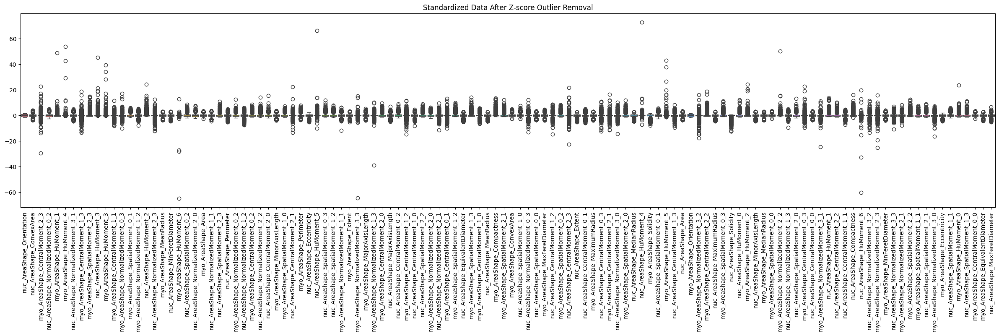

In [12]:
# let's plot the data before and after removing outliers so we can see if outliers are really outliers

# Function to plot data excluding identifier columns
def plot_data(df, title, id_columns=None):
    if id_columns:
        df = df.drop(columns=id_columns)
    plt.figure(figsize=(30, 6))
    sns.boxplot(data=df)
    plt.title(title)
    plt.xticks(rotation=90)
    plt.show()

# Columns to exclude from the plots
id_columns = ['ImageNumber', 'ObjectNumber', 'FileName_Act', 'group']

# Standardize the data
scaler = StandardScaler()
df_standardized = pd.DataFrame(scaler.fit_transform(df_features.drop(columns=id_columns)), columns=df_features.drop(columns=id_columns).columns)

# Plot standardized original data excluding identifier columns
plot_data(df_standardized, "Standardized Original Data", id_columns=None)

# Standardize the cleaned data (IQR method)
df_cleaned_standardized = pd.DataFrame(scaler.fit_transform(df_cleaned.drop(columns=id_columns)), columns=df_cleaned.drop(columns=id_columns).columns)

# Plot standardized data after IQR outlier removal excluding identifier columns
plot_data(df_cleaned_standardized, "Standardized Data After IQR Outlier Removal", id_columns=None)

# Standardize the cleaned data (Z-score method)
df_cleaned_zscore_standardized = pd.DataFrame(scaler.fit_transform(df_cleaned_zscore.drop(columns=id_columns)), columns=df_cleaned_zscore.drop(columns=id_columns).columns)

# Plot standardized data after Z-score outlier removal excluding identifier columns
plot_data(df_cleaned_zscore_standardized, "Standardized Data After Z-score Outlier Removal", id_columns=None)

## Summary stats

In [15]:
# summary stats before normalization
summary_stats_converted = df_cleaned.describe().T
summary_stats_converted.to_csv("/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/summary_stats_IQR_converted.csv")
print(summary_stats_converted)


                                     count          mean           std  \
ImageNumber                         5812.0  9.562732e+01  6.252344e+01   
ObjectNumber                        5812.0  3.383379e+01  2.751424e+01   
nuc_AreaShape_SpatialMoment_0_2     5812.0  1.139485e+06  5.690452e+05   
myo_AreaShape_NormalizedMoment_1_1  5812.0  6.430809e-05  2.906287e-02   
nuc_AreaShape_CentralMoment_1_1     5812.0  1.971234e+02  5.595408e+04   
...                                    ...           ...           ...   
myo_AreaShape_HuMoment_4            5812.0  2.953830e-07  8.040975e-06   
nuc_AreaShape_CentralMoment_2_2     5812.0  2.418378e+07  1.569187e+07   
nuc_AreaShape_HuMoment_4            5812.0  8.536113e-10  1.725611e-08   
myo_AreaShape_Orientation           5812.0 -5.379701e-01  5.251336e+01   
myo_AreaShape_SpatialMoment_0_3     5812.0  1.881875e+09  2.049715e+09   

                                             min           25%           50%  \
ImageNumber                    

## Normalize data

In [13]:
# Normalize the columns ###########################################################

def normalize_columns(df, columns):
    """
    Normalize the specified columns in a DataFrame using Min-Max scaling.
    """
    # Copy the input DataFrame
    df_normalized = df_cleaned.copy()
    
    # Initialize the Min-Max scaler
    scaler = MinMaxScaler()
    
    # Normalize the specified columns
    df_normalized[columns] = scaler.fit_transform(df_normalized[columns])
    
    return df

numeric_cols = df_cleaned.select_dtypes(include=['number']).columns.tolist()

# Calling the function to Normalize the selected columns in features dataframe
normalized_df = df_cleaned.copy() # copy the features dataframe
group_col = normalized_df['group'] #preserve ID column
normalized_df = normalize_columns(normalized_df, numeric_cols)
normalized_df['group'] = group_col # re-add ID columns to DF

# save the normalized dataframe
normalized_df.to_csv("/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/normalized_data.csv", index=False)

# Display the new DataFrame
print(normalized_df.head())

unique_groups = normalized_df['group'].unique()
print(f"Unique groups in the normalized DataFrame: {unique_groups}")

   ImageNumber  ObjectNumber                  FileName_Act  \
0            1             1  Ble_repA_001.czi_MAX_C2.tiff   
1            1             2  Ble_repA_001.czi_MAX_C2.tiff   
2            1             3  Ble_repA_001.czi_MAX_C2.tiff   
3            1             4  Ble_repA_001.czi_MAX_C2.tiff   
4            1             5  Ble_repA_001.czi_MAX_C2.tiff   

   nuc_AreaShape_Orientation  nuc_AreaShape_ConvexArea  \
0                  88.813538                700.894244   
1                 -48.684911                621.137313   
2                  88.821807                574.526120   
3                   6.202739                682.940303   
4                 -80.758384                647.377689   

   myo_AreaShape_CentralMoment_2_3  nuc_AreaShape_NormalizedMoment_0_2  \
0                    -5.536594e+10                            0.108245   
1                    -2.419094e+10                            0.088817   
2                     3.710430e+10                      

## Summary stata after normalization

In [17]:
# summary stats after normalization

summary_stats_normalized = normalized_df.describe().T
summary_stats_normalized.to_csv("/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/summary_stats_IQR_normalized.csv")
print("Normalized", summary_stats_normalized.describe())

print("Before Normalization", summary_stats_converted.describe())

Normalized         count          mean           std           min           25%  \
count   122.0  1.220000e+02  1.220000e+02  1.220000e+02  1.220000e+02   
mean   5812.0  6.077556e+10  9.276442e+10 -1.708855e+10  1.226953e+10   
std       0.0  6.507195e+11  9.943356e+11  1.848679e+11  1.302039e+11   
min    5812.0 -5.241814e+07  4.240676e-12 -2.041777e+12 -7.636561e+09   
25%    5812.0  5.116762e-05  6.267716e-03 -1.076333e-02 -4.369135e-04   
50%    5812.0  3.024120e+00  2.326931e+00  2.967316e-01  6.625482e-01   
75%    5812.0  3.749542e+04  2.367736e+05  5.750000e+02  1.736065e+03   
max    5812.0  7.187993e+12  1.098409e+13  4.237096e+09  1.438096e+12   

                50%           75%           max  
count  1.220000e+02  1.220000e+02  1.220000e+02  
mean   3.050010e+10  7.176983e+10  1.501613e+12  
std    3.239732e+11  7.656664e+11  1.609071e+13  
min   -8.451406e+06  2.302158e-12  2.165734e-11  
25%    1.787333e-05  3.433283e-03  5.984904e-02  
50%    3.044872e+00  1.819816e+

### comparison of stats before and after normalization

In [18]:
# Compare summary stats before and after normalization 
# check for range of values (after normalization should be between 0 and 1)
# mean and std deviation (after normalization mean is typically about 0.5 and std is reduced)
# min and max (after normalization min is 0 and max is 1)
# distribution of values (after normalization should be uniform, scaled depending on normalization method)

# Add a new column to indicate the state
summary_stats_converted['State'] = 'Before Normalization'
summary_stats_normalized['State'] = 'After Normalization'

# Concatenate the DataFrames along the rows
summary_stats_comparison = pd.concat([summary_stats_converted, summary_stats_normalized], axis=0)

# Reset the index to include the column names as a regular column
summary_stats_comparison.reset_index(inplace=True)

# Save the comparison to a CSV file
output_path = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/summary_stats_IQR_comparison.csv"
summary_stats_comparison.to_csv(output_path, index=False)

# Print the comparison DataFrame
#print(summary_stats_comparison)

# Split data into two separate dataframes based on the state: 'Before' and 'After' normalization
before_norm = summary_stats_comparison[summary_stats_comparison['State'] == 'Before Normalization']
after_norm = summary_stats_comparison[summary_stats_comparison['State'] == 'After Normalization']

# Merge both dataframes on the 'index' column to compare before and after statistics
comparison_df = before_norm.merge(after_norm, on='index', suffixes=('_before', '_after'))

# Select the columns for comparison
columns_to_compare = ['mean', 'std', 'min', '25%', '50%', '75%', 'max']

# Calculate the percentage change between before and after normalization for each feature
for col in columns_to_compare:
    comparison_df[f'{col}_change(%)'] = ((comparison_df[f'{col}_after'] - comparison_df[f'{col}_before']) / 
                                         comparison_df[f'{col}_before']) * 100

# Filter and organize the columns for clarity
stat_comparison_df = comparison_df[['index'] + [f'{col}_change(%)' for col in columns_to_compare]]

# Save the comparison to a CSV file
output_path = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/stat_comparison_IQR.csv"
stat_comparison_df.to_csv(output_path, index=False)

stat_comparison_df.head()


,index,mean_change(%),std_change(%),min_change(%),25%_change(%),50%_change(%),75%_change(%),max_change(%)
0,ImageNumber,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ObjectNumber,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,nuc_AreaShape_SpatialMoment_0_2,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,myo_AreaShape_NormalizedMoment_1_1,0.0,0.0,-0.0,-0.0,-0.0,0.0,0.0
4,nuc_AreaShape_CentralMoment_1_1,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0


## Add Aspect Ratio 

In [14]:
# Get the column names of the feature dataframe
feature_column_names = df_cleaned.columns.tolist()
#feature_column_names

# add columns for aspect ratio
df_cleaned["nuc_AreaShape_AspectRatio"] = df_cleaned['nuc_AreaShape_MinorAxisLength'] / df_cleaned['nuc_AreaShape_MajorAxisLength']
df_cleaned["myo_AreaShape_AspectRatio"] = df_cleaned['myo_AreaShape_MinorAxisLength'] / df_cleaned['myo_AreaShape_MajorAxisLength']

# add columns for circularity
df_cleaned["nuc_AreaShape_Circularity"] = 4 * np.pi * df_cleaned['nuc_AreaShape_Area'] / (df_cleaned['nuc_AreaShape_Perimeter'] ** 2)
df_cleaned["myo_AreaShape_Circularity"] = 4 * np.pi * df_cleaned['myo_AreaShape_Area'] / (df_cleaned['myo_AreaShape_Perimeter'] ** 2)

# add eccentricity columns
df_cleaned["nuc_AreaShape_Eccentricity"] = np.sqrt(1 - (df_cleaned['nuc_AreaShape_MinorAxisLength'] / df_cleaned['nuc_AreaShape_MajorAxisLength']) ** 2)
df_cleaned["myo_AreaShape_Eccentricity"] = np.sqrt(1 - (df_cleaned['myo_AreaShape_MinorAxisLength'] / df_cleaned['myo_AreaShape_MajorAxisLength']) ** 2)

# Add all new columns to the list of feature columns
feature_column_names.extend(["nuc_AreaShape_AspectRatio", "myo_AreaShape_AspectRatio", "nuc_AreaShape_Circularity", "myo_AreaShape_Circularity", "nuc_AreaShape_Eccentricity", "myo_AreaShape_Eccentricity"])

# print df_cleaned column names as a list
print(df_cleaned.columns)


Index(['ImageNumber', 'ObjectNumber', 'FileName_Act',
       'nuc_AreaShape_Orientation', 'nuc_AreaShape_ConvexArea',
       'myo_AreaShape_CentralMoment_2_3', 'nuc_AreaShape_NormalizedMoment_0_2',
       'myo_AreaShape_HuMoment_1', 'myo_AreaShape_HuMoment_4',
       'nuc_AreaShape_NormalizedMoment_3_1',
       ...
       'myo_AreaShape_HuMoment_0', 'nuc_AreaShape_SpatialMoment_1_3',
       'myo_AreaShape_CentralMoment_0_0', 'myo_AreaShape_EquivalentDiameter',
       'nuc_AreaShape_MaxFeretDiameter', 'group', 'nuc_AreaShape_AspectRatio',
       'myo_AreaShape_AspectRatio', 'nuc_AreaShape_Circularity',
       'myo_AreaShape_Circularity'],
      dtype='object', length=128)


## histograms of some feaures

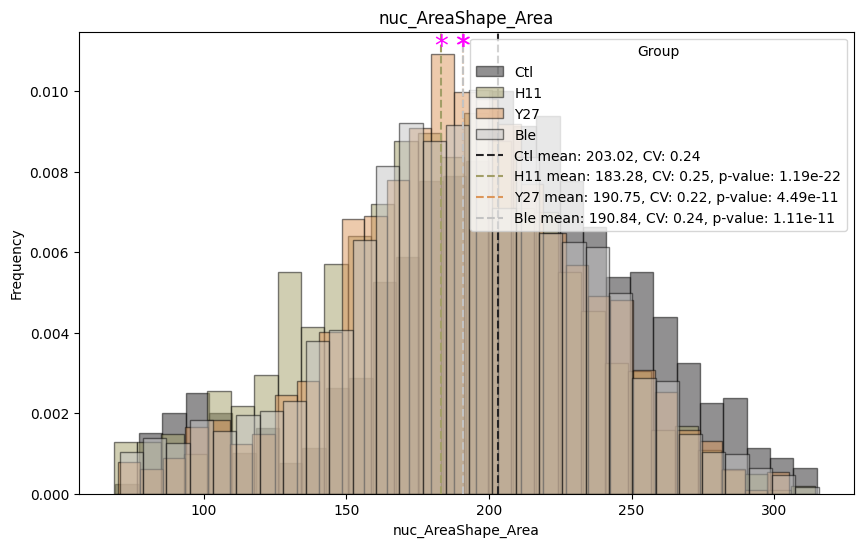

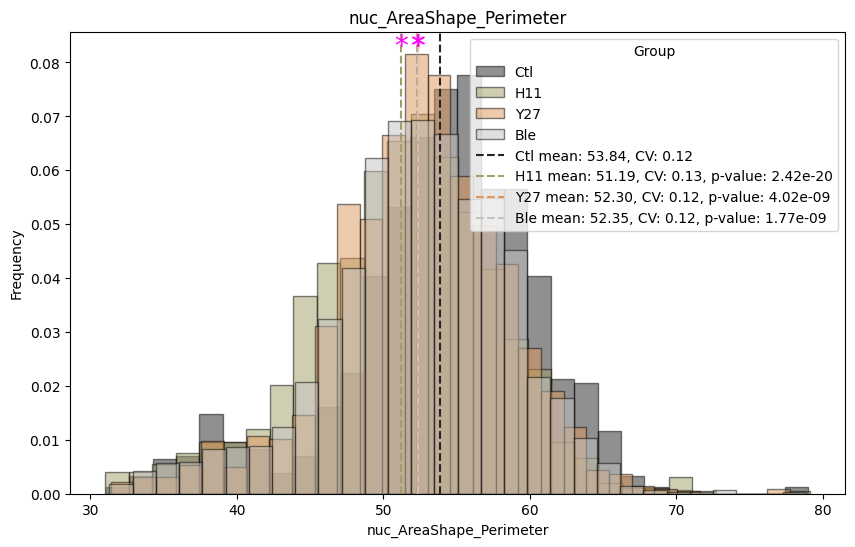

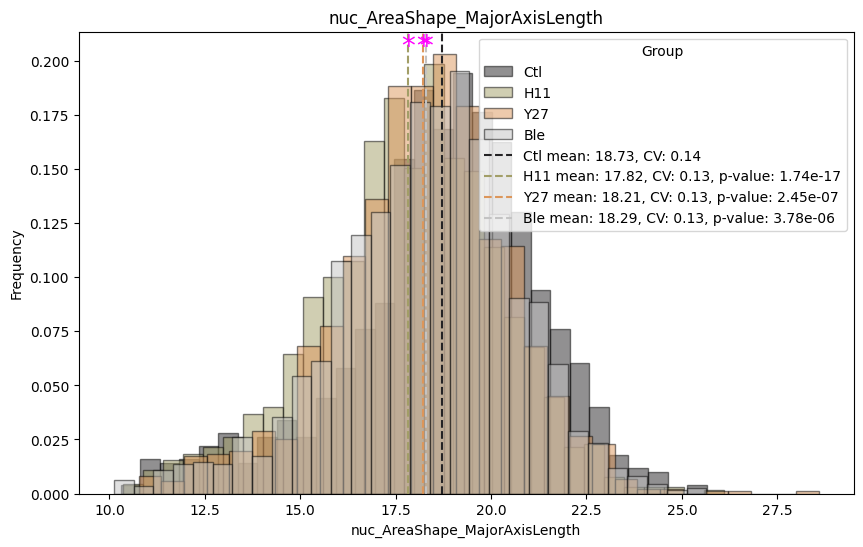

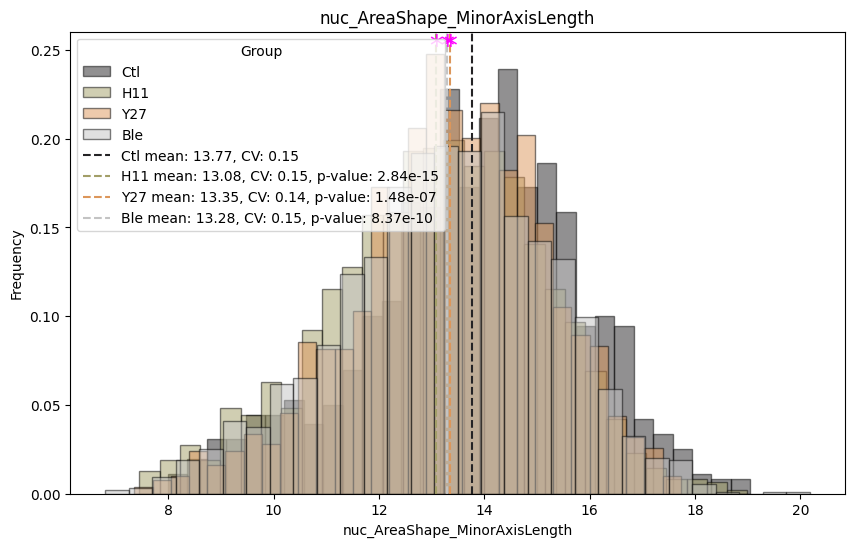

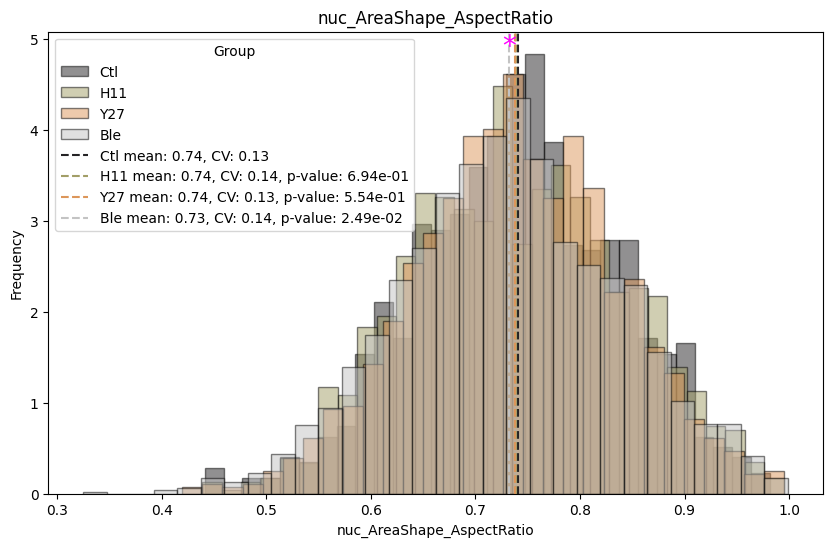

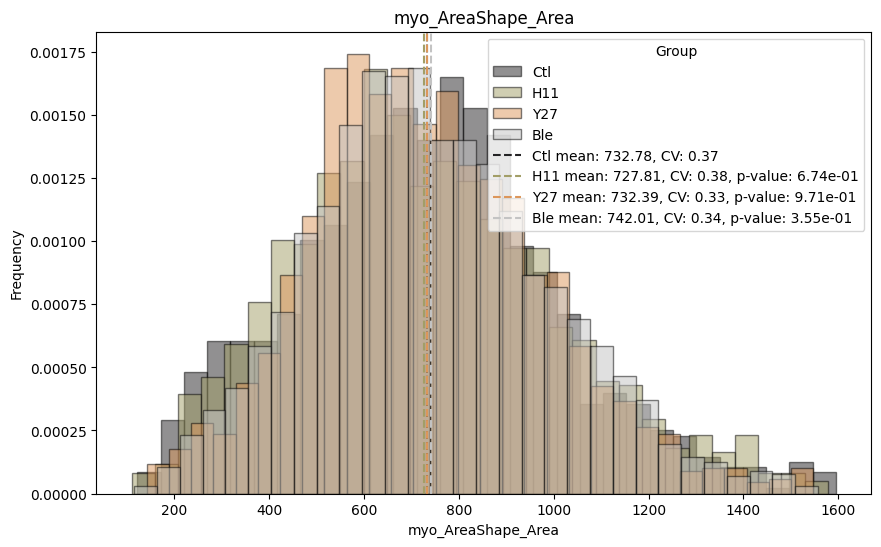

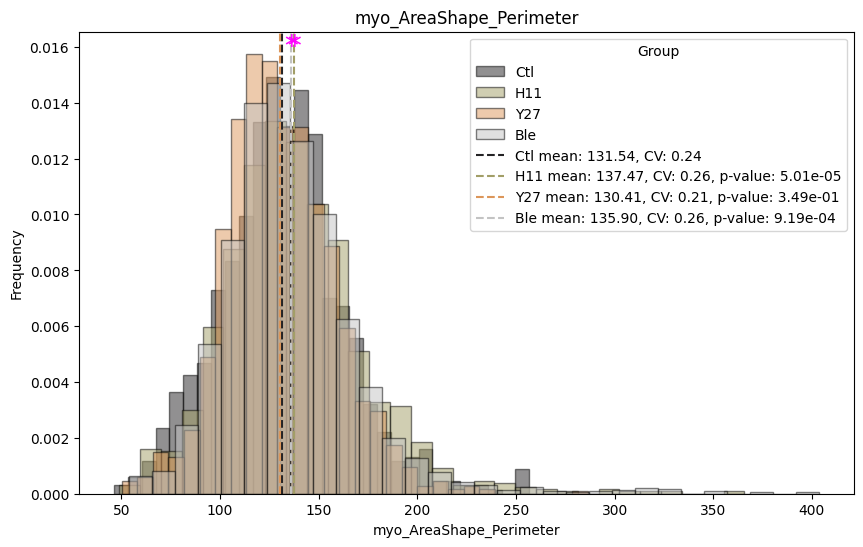

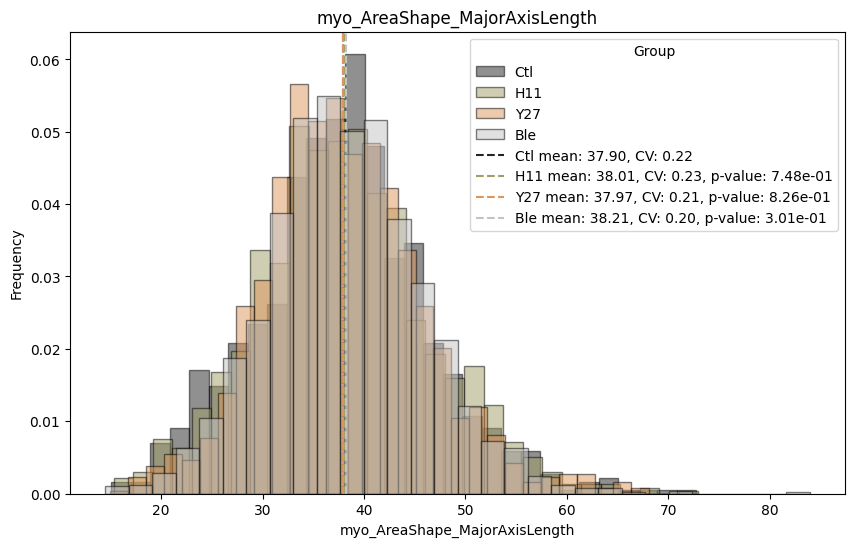

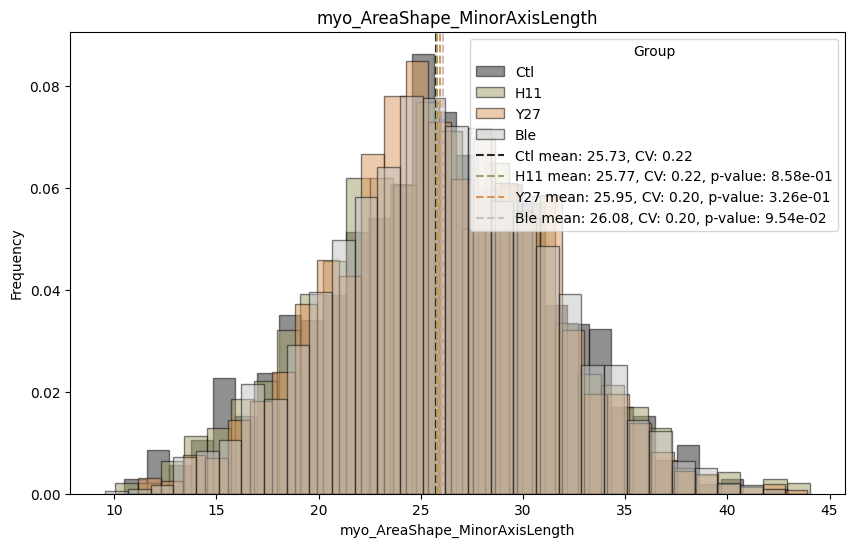

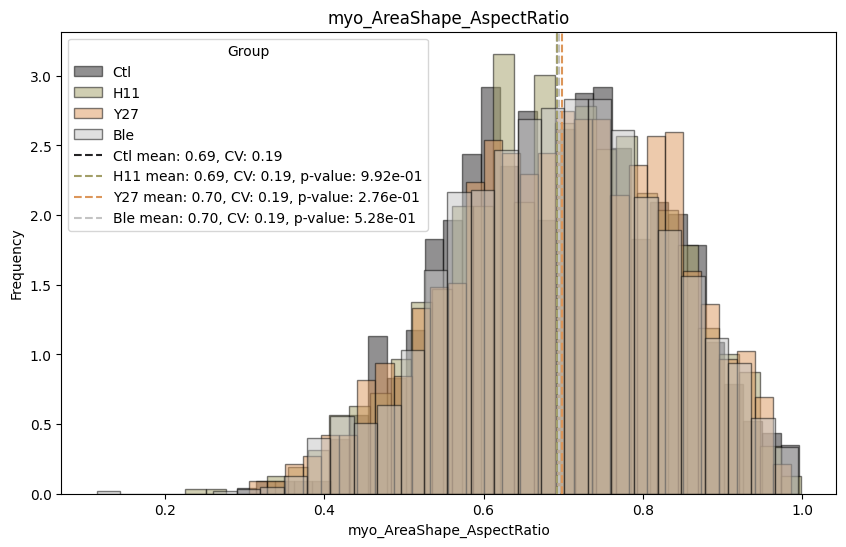

In [15]:
# plots of non-normalized data and standardized group counts - histograms of a few features

# List of columns for histograms
columns = [
    'nuc_AreaShape_Area',
    'nuc_AreaShape_Perimeter',
    'nuc_AreaShape_MajorAxisLength',
    'nuc_AreaShape_MinorAxisLength',
    'nuc_AreaShape_AspectRatio',
    'myo_AreaShape_Area',
    'myo_AreaShape_Perimeter',
    'myo_AreaShape_MajorAxisLength',
    'myo_AreaShape_MinorAxisLength',
    'myo_AreaShape_AspectRatio'
]

# color palette for each treatment group
group_colors = {
    'Ctl': '#242325',  # Raisin Black
    'H11': '#A29E67',  # Moss Green
    'Y27': '#DC965A',   # Persian Orange
    'Ble': '#C3C3C3',  # Silver
}

# Directory to save the figures
save_dir = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/Figures/"

# Ensure the directory exists
os.makedirs(save_dir, exist_ok=True)

# Loop through the columns and create histograms
for column in columns:
    plt.figure(figsize=(10, 6))
    means = {}
    p_values = {}
    legend_labels = {}
    for group, color in group_colors.items():
        group_data = df_cleaned[df_cleaned['group'] == group][column]
        plt.hist(group_data, bins=30, alpha=0.5, label=group, color=color, edgecolor='black', density = True)
        means[group] = group_data.mean()

        # Calculate CV
        cv = group_data.std() / group_data.mean()

        # t-test against control group
        if group != 'Ctl':
            t_stat, p_val = stats.ttest_ind(df_cleaned[df_cleaned['group'] == 'Ctl'][column], group_data)
            p_values[group] = p_val
            legend_labels[group] = f'{group} mean: {means[group]:.2f}, CV: {cv:.2f}, p-value: {p_val:.2e}'
        else:
            legend_labels[group] = f'{group} mean: {means[group]:.2f}, CV: {cv:.2f}'

    # Annotate means and p-values
    for group, mean in means.items():
        plt.axvline(mean, color=group_colors[group], linestyle='--', label=legend_labels[group])
    
   
    # # Annotate coefficient of variation for each group
    # y_offset = 0.9  # Initial offset for the first annotation
    # for group, color in group_colors.items():
    #     group_data = df_cleaned[df_cleaned['group'] == group][column]
    #     cv = group_data.std() / group_data.mean()
    #     # Adjust the x position by adding/subtracting a small value to/from the mean
    #     x_position = means[group] + (means[group] * 0.3)  # Move to the right
    #     plt.text(x_position, plt.gca().get_ylim()[1] * y_offset, f'CV: {cv:.2f}', fontsize=12, color=color, ha='left')
    #     y_offset -= 0.05  # Decrease the offset for the next annotation

    # stat significance
    for group, p_val in p_values.items():
        if p_val < 0.05:
             # Calculate the maximum y-value of the histogram
            max_y = plt.gca().get_ylim()[1]
            plt.text(means[group], max_y * 0.95, '*', fontsize=20, color='magenta', ha='center')

    plt.title(f'{column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.legend(title='Group')
    plt.grid(False)

      # Save the figure
    filename = f"Hist_{column}_byGroup.png"
    plt.savefig(os.path.join(save_dir, filename))
    
    plt.show()

## Histograms of roundness/circularity features


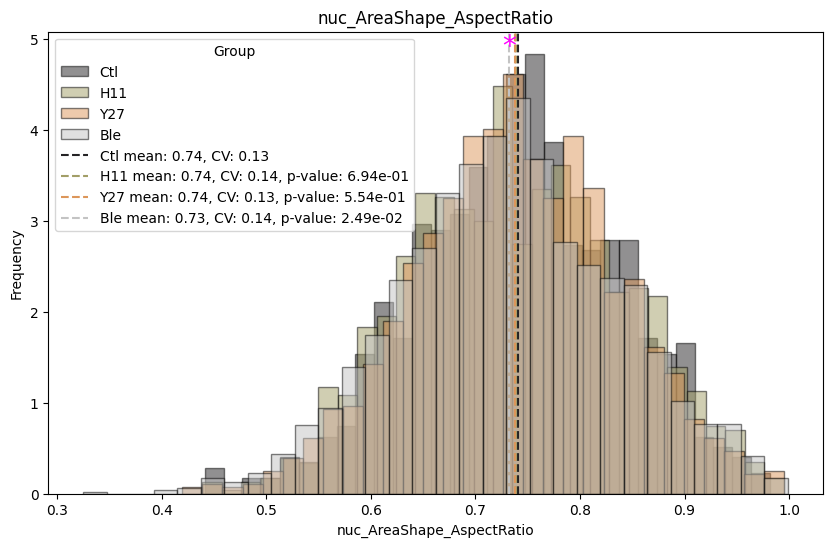

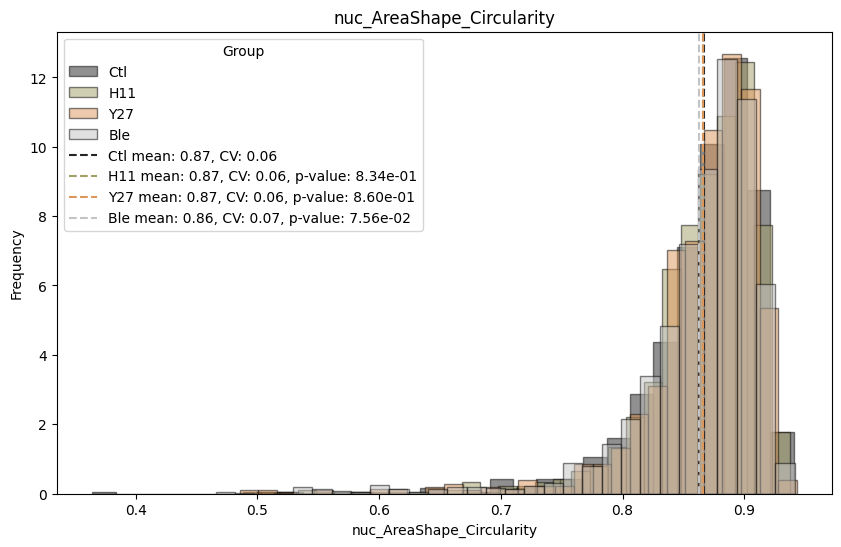

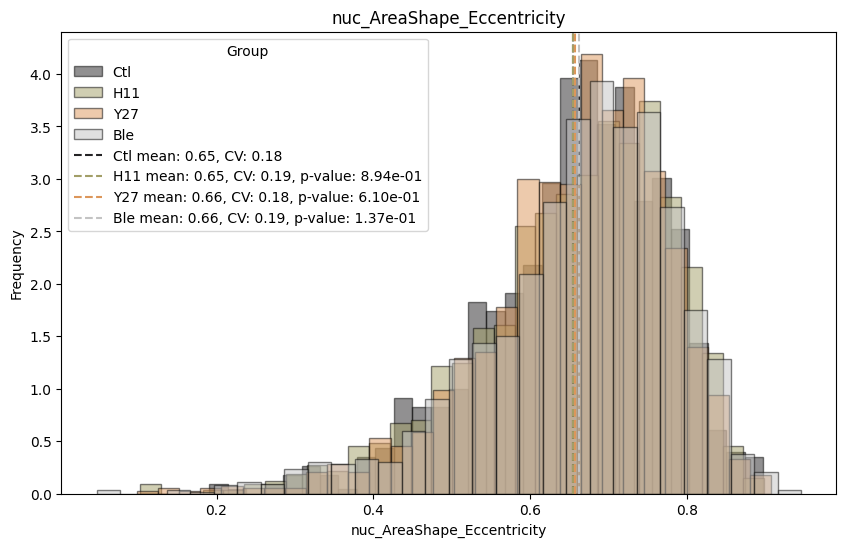

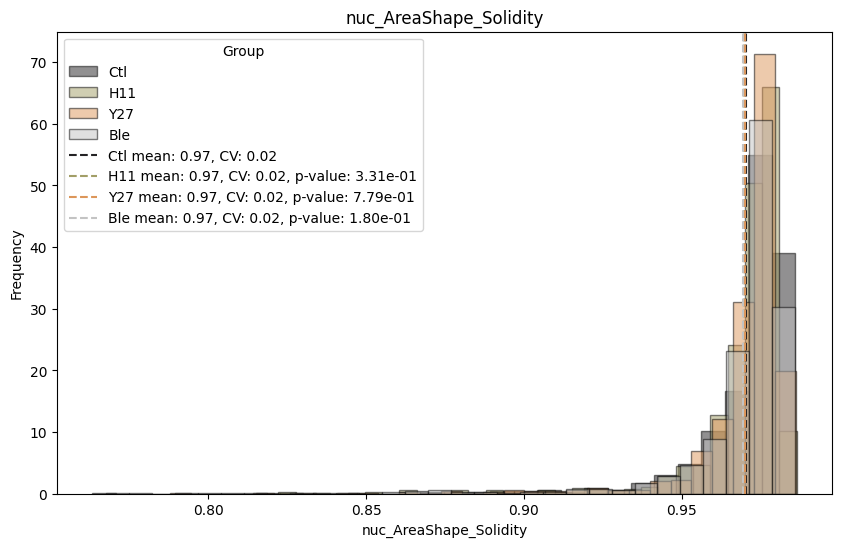

In [22]:
# plots of non-normalized data and standardized group counts - histograms of a few features

# List of columns for histograms
columns = [
    'nuc_AreaShape_AspectRatio',
    'nuc_AreaShape_Circularity',
    'nuc_AreaShape_Eccentricity',
    'nuc_AreaShape_Solidity',
]

# color palette for each treatment group
group_colors = {
    'Ctl': '#242325',  # Raisin Black
    'H11': '#A29E67',  # Moss Green
    'Y27': '#DC965A',   # Persian Orange
    'Ble': '#C3C3C3',  # Silver
}

# Directory to save the figures
save_dir = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/Figures/"

# Ensure the directory exists
os.makedirs(save_dir, exist_ok=True)

# Loop through the columns and create histograms
for column in columns:
    plt.figure(figsize=(10, 6))
    means = {}
    p_values = {}
    legend_labels = {}
    for group, color in group_colors.items():
        group_data = df_cleaned[df_cleaned['group'] == group][column]
        plt.hist(group_data, bins=30, alpha=0.5, label=group, color=color, edgecolor='black', density = True)
        means[group] = group_data.mean()

        # Calculate CV
        cv = group_data.std() / group_data.mean()

        # t-test against control group
        if group != 'Ctl':
            t_stat, p_val = stats.ttest_ind(df_cleaned[df_cleaned['group'] == 'Ctl'][column], group_data)
            p_values[group] = p_val
            legend_labels[group] = f'{group} mean: {means[group]:.2f}, CV: {cv:.2f}, p-value: {p_val:.2e}'
        else:
            legend_labels[group] = f'{group} mean: {means[group]:.2f}, CV: {cv:.2f}'

    # Annotate means and p-values
    for group, mean in means.items():
        plt.axvline(mean, color=group_colors[group], linestyle='--', label=legend_labels[group])

    # stat significance
    for group, p_val in p_values.items():
        if p_val < 0.05:
             # Calculate the maximum y-value of the histogram
            max_y = plt.gca().get_ylim()[1]
            plt.text(means[group], max_y * 0.95, '*', fontsize=20, color='magenta', ha='center')

    plt.title(f'{column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.legend(title='Group')
    plt.grid(False)

      # Save the figure
    filename = f"Hist_{column}_byGroup.png"
    plt.savefig(os.path.join(save_dir, filename))
    
    plt.show()

## histograms - just control

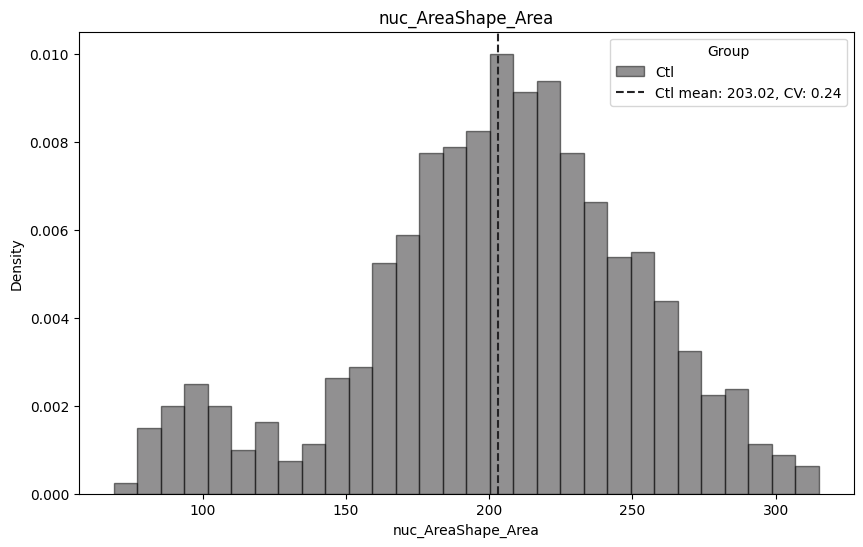

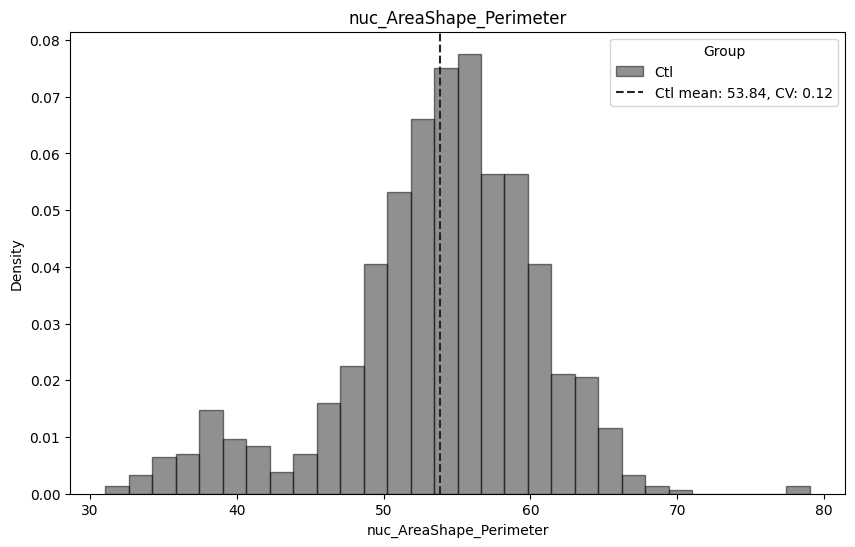

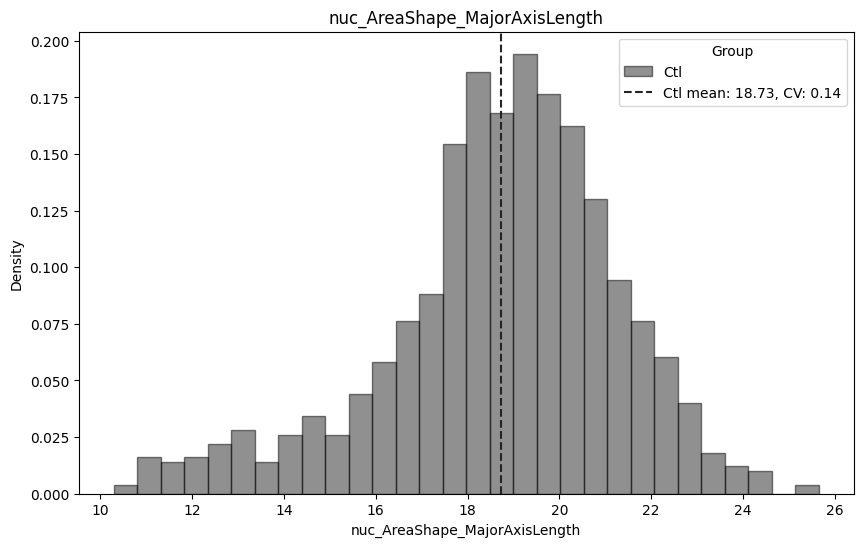

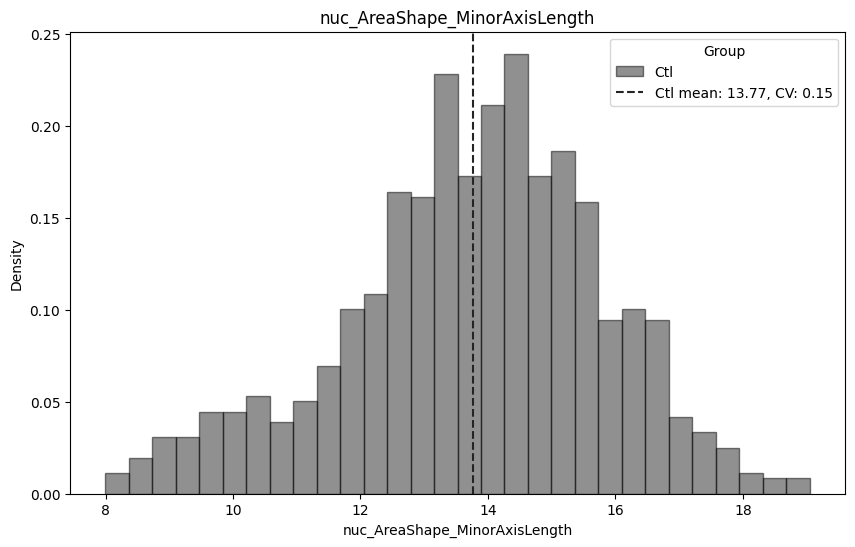

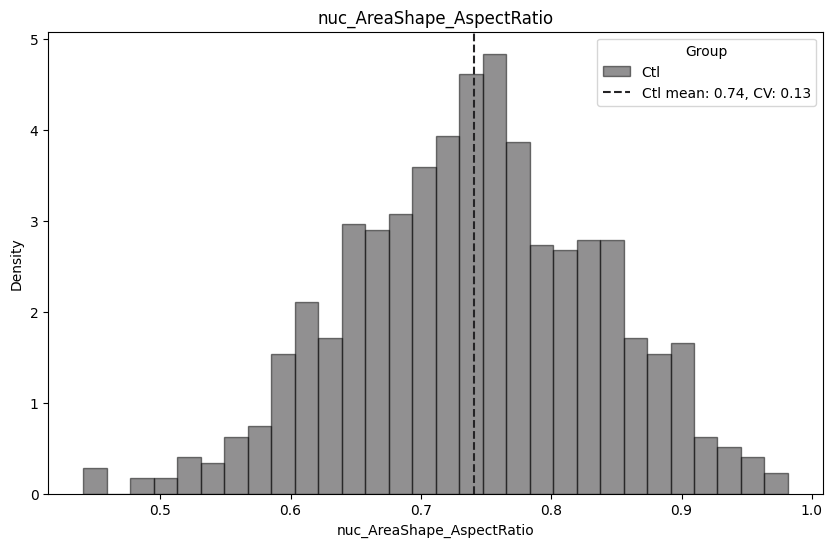

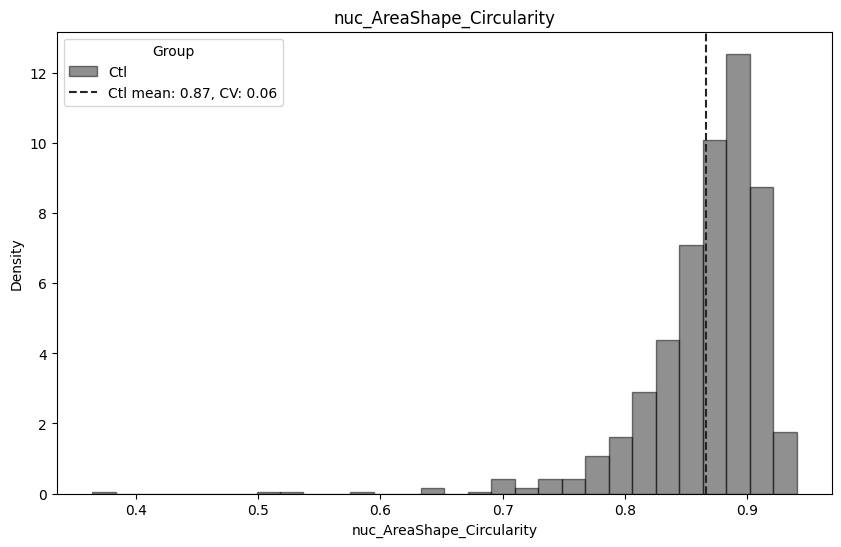

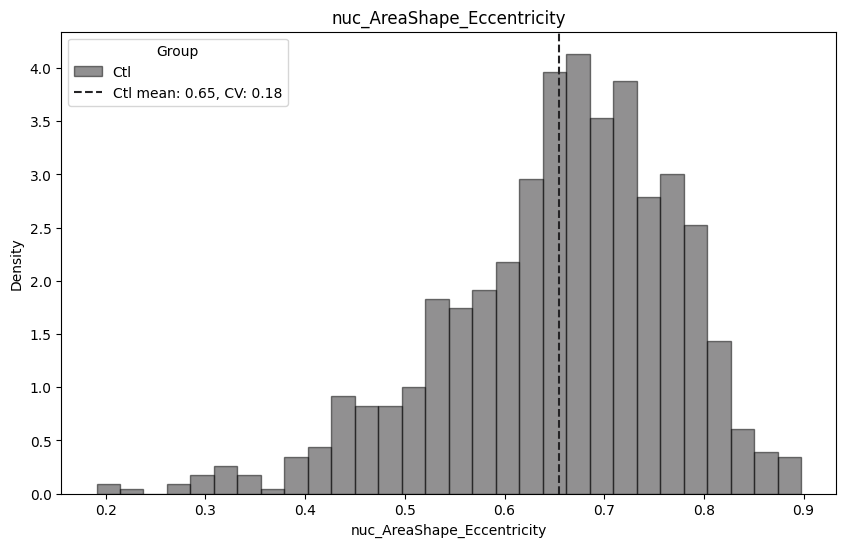

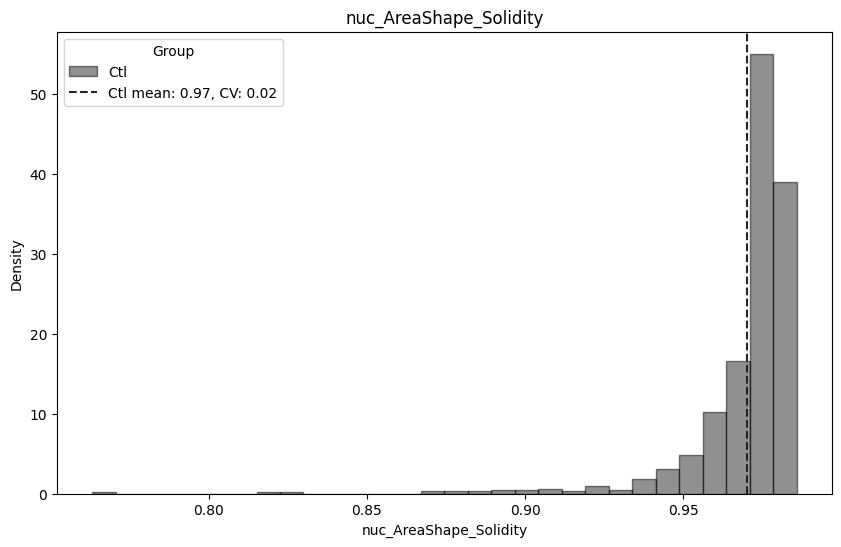

In [23]:
# histograms of control group nuclear features

# List of columns for histograms
columns = [
    'nuc_AreaShape_Area',
    'nuc_AreaShape_Perimeter',
    'nuc_AreaShape_MajorAxisLength',
    'nuc_AreaShape_MinorAxisLength',
    'nuc_AreaShape_AspectRatio',
    'nuc_AreaShape_Circularity',
    'nuc_AreaShape_Eccentricity',
    'nuc_AreaShape_Solidity',
]

# color for control group
group_colors = {
    'Ctl': '#242325',  # Raisin Black
}

# Directory to save the figures
save_dir = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/Figures/"


# Loop through the columns and create histograms

for column in columns:
    plt.figure(figsize=(10, 6))
    means = {}
    p_values = {}
    legend_labels = {}
    for group, color in group_colors.items():
        group_data = df_cleaned[df_cleaned['group'] == group][column]
        plt.hist(group_data, bins=30, alpha=0.5, label=group, color=color, edgecolor='black', density = True)
        means[group] = group_data.mean()

        # Calculate CV
        cv = group_data.std() / group_data.mean()

        # t-test against control group
        if group != 'Ctl':
            t_stat, p_val = stats.ttest_ind(df_cleaned[df_cleaned['group'] == 'Ctl'][column], group_data)
            p_values[group] = p_val
            legend_labels[group] = f'{group} mean: {means[group]:.2f}, CV: {cv:.2f}, p-value: {p_val:.2e}'
        else:
            legend_labels[group] = f'{group} mean: {means[group]:.2f}, CV: {cv:.2f}'

    # Annotate means and p-values
    for group, mean in means.items():
        plt.axvline(mean, color=group_colors[group], linestyle='--', label=legend_labels[group])

    # stat significance
    for group, p_val in p_values.items():
        if p_val < 0.05:
             # Calculate the maximum y-value of the histogram
            max_y = plt.gca().get_ylim()[1]
            plt.text(means[group], max_y * 0.95, '*', fontsize=20, color='magenta', ha='center')

    plt.title(f'{column}')
    plt.xlabel(column)
    plt.ylabel('Density')
    plt.legend(title='Group')
    plt.grid(False)

      # Save the figure
    filename = f"Hist_{column}_Ctl.png"
    plt.savefig(os.path.join(save_dir, filename))
    
    plt.show()


## Histograms - different style


Column: nuc_AreaShape_Area
Control mean: 203.02, CV: 0.24
Blebbistatin mean: 190.84, CV: 0.24, p-value: 1.11e-11, effect size: 0.26, 95% CI: [189.00, 192.84]
H-1152 mean: 183.28, CV: 0.25, p-value: 1.19e-22, effect size: 0.42, 95% CI: [180.84, 185.86]
Y-27632 mean: 190.75, CV: 0.22, p-value: 4.49e-11, effect size: 0.27, 95% CI: [188.49, 192.99]


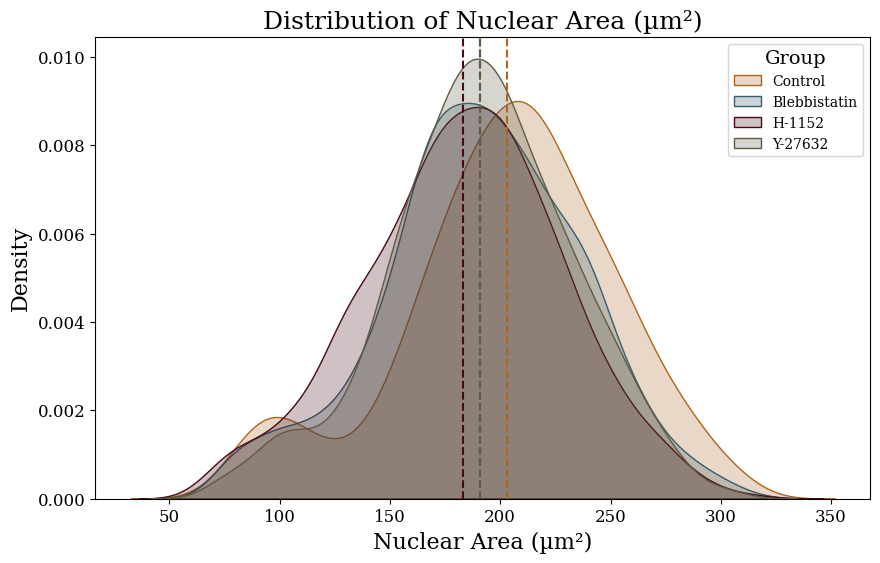

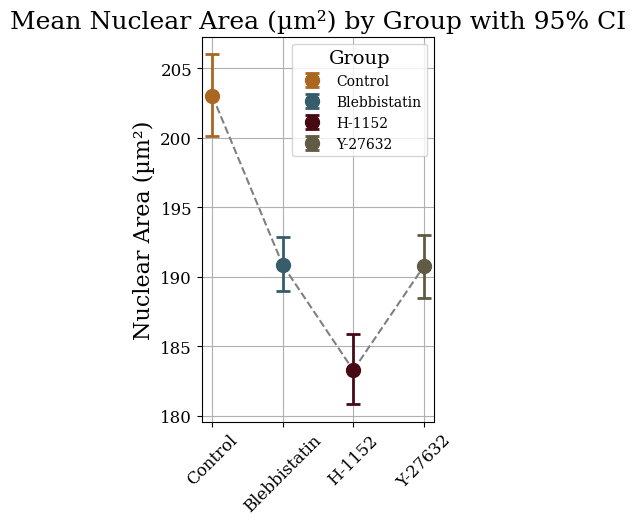


Column: nuc_AreaShape_Perimeter
Control mean: 53.84, CV: 0.12
Blebbistatin mean: 52.35, CV: 0.12, p-value: 1.77e-09, effect size: 0.23, 95% CI: [52.09, 52.61]
H-1152 mean: 51.19, CV: 0.13, p-value: 2.42e-20, effect size: 0.40, 95% CI: [50.82, 51.55]
Y-27632 mean: 52.30, CV: 0.12, p-value: 4.02e-09, effect size: 0.24, 95% CI: [52.00, 52.60]


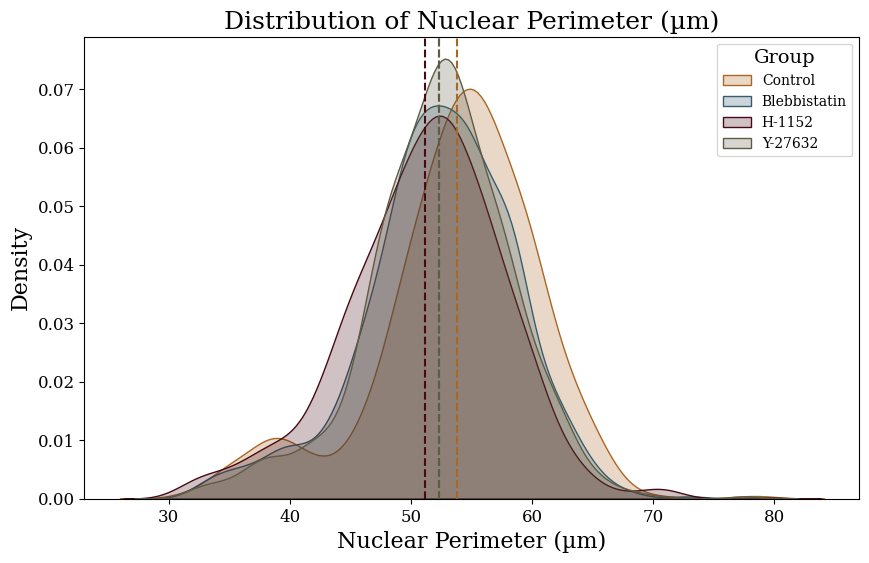

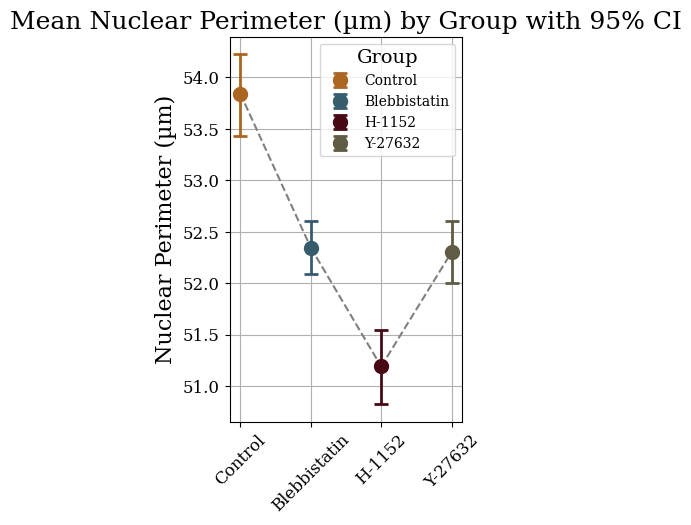


Column: nuc_AreaShape_MajorAxisLength
Control mean: 18.73, CV: 0.14
Blebbistatin mean: 18.29, CV: 0.13, p-value: 3.78e-06, effect size: 0.18, 95% CI: [18.19, 18.39]
H-1152 mean: 17.82, CV: 0.13, p-value: 1.74e-17, effect size: 0.37, 95% CI: [17.69, 17.96]
Y-27632 mean: 18.21, CV: 0.13, p-value: 2.45e-07, effect size: 0.21, 95% CI: [18.10, 18.33]


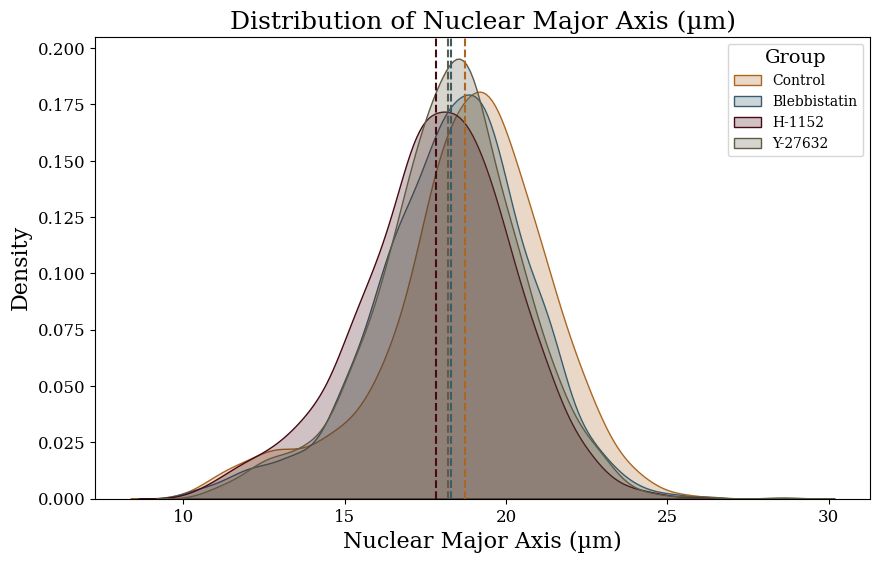

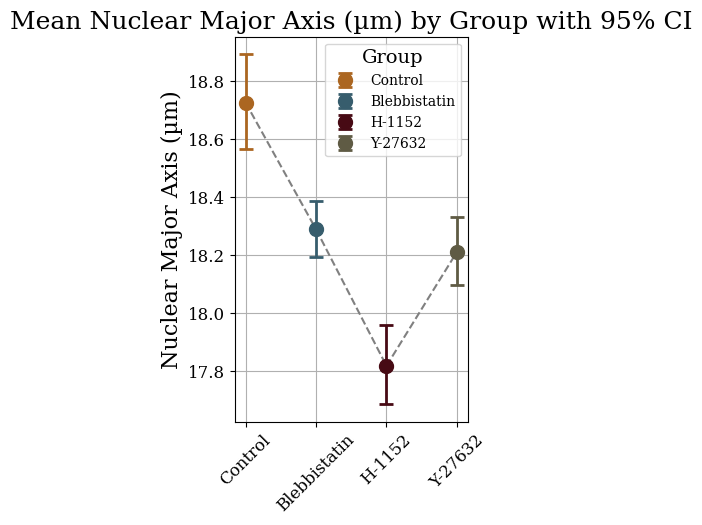


Column: nuc_AreaShape_MinorAxisLength
Control mean: 13.77, CV: 0.15
Blebbistatin mean: 13.28, CV: 0.15, p-value: 8.37e-10, effect size: 0.24, 95% CI: [13.21, 13.38]
H-1152 mean: 13.08, CV: 0.15, p-value: 2.84e-15, effect size: 0.34, 95% CI: [12.97, 13.19]
Y-27632 mean: 13.35, CV: 0.14, p-value: 1.48e-07, effect size: 0.22, 95% CI: [13.26, 13.44]


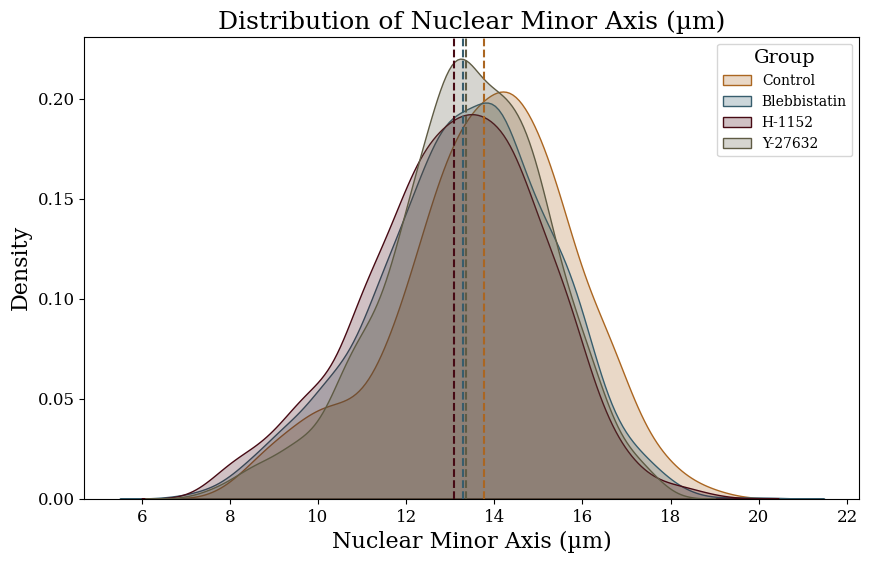

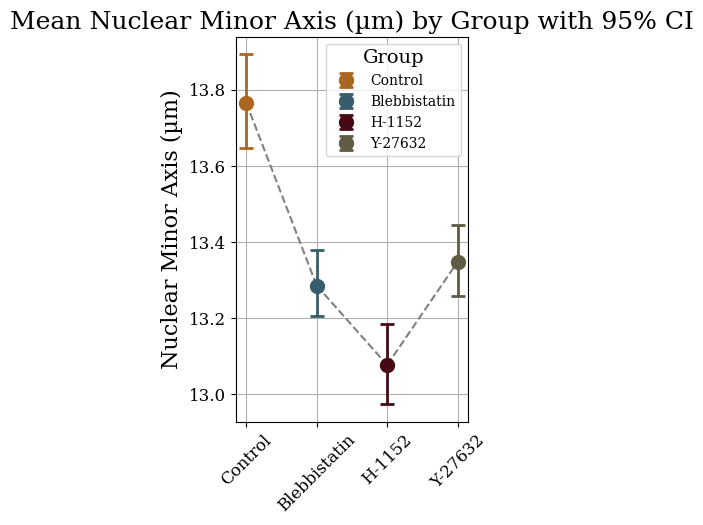


Column: nuc_AreaShape_AspectRatio
Control mean: 0.74, CV: 0.13
Blebbistatin mean: 0.73, CV: 0.14, p-value: 2.49e-02, effect size: 0.09, 95% CI: [0.73, 0.74]
H-1152 mean: 0.74, CV: 0.14, p-value: 6.94e-01, effect size: 0.02, 95% CI: [0.73, 0.74]
Y-27632 mean: 0.74, CV: 0.13, p-value: 5.54e-01, effect size: 0.02, 95% CI: [0.73, 0.74]


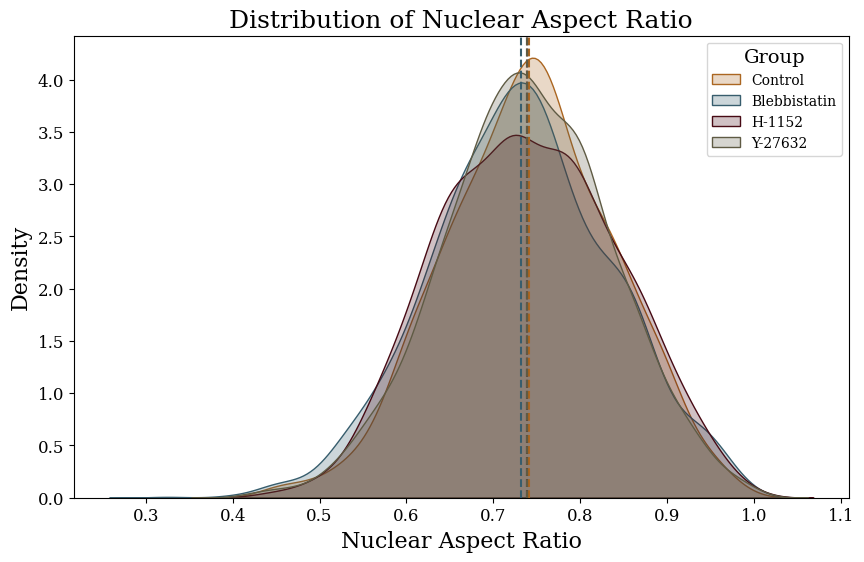

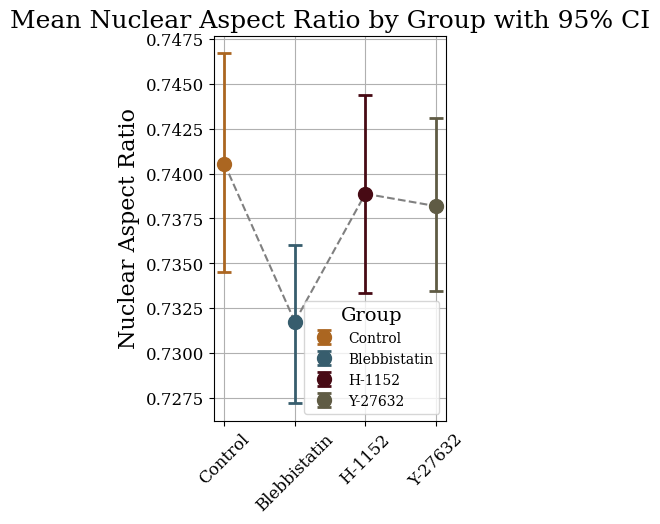


Column: nuc_AreaShape_Circularity
Control mean: 0.87, CV: 0.06
Blebbistatin mean: 0.86, CV: 0.07, p-value: 7.56e-02, effect size: 0.07, 95% CI: [0.86, 0.87]
H-1152 mean: 0.87, CV: 0.06, p-value: 8.34e-01, effect size: 0.01, 95% CI: [0.86, 0.87]
Y-27632 mean: 0.87, CV: 0.06, p-value: 8.60e-01, effect size: 0.01, 95% CI: [0.86, 0.87]


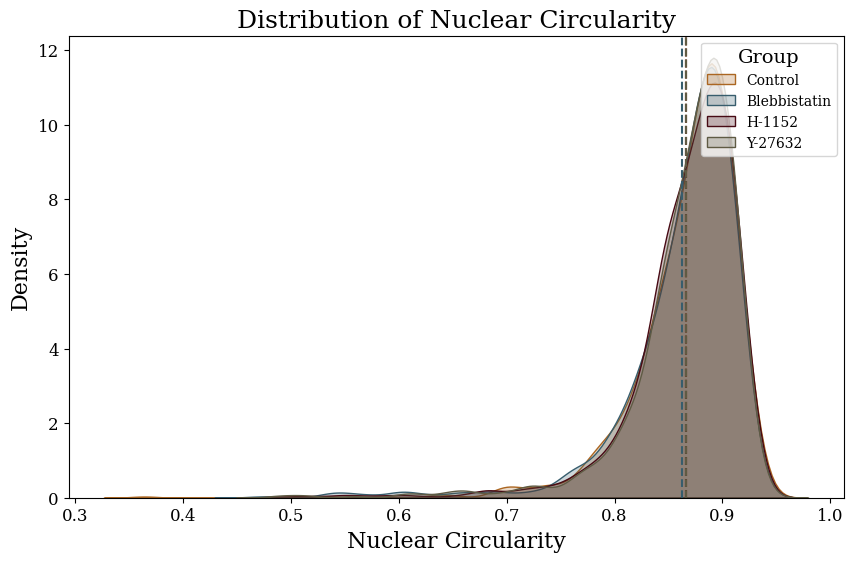

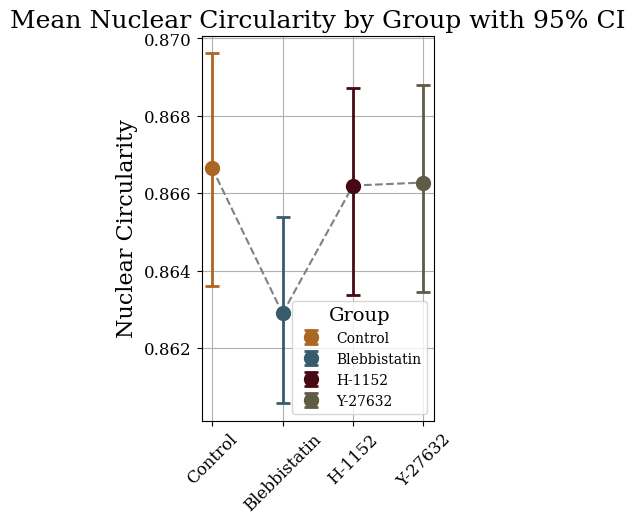


Column: nuc_AreaShape_Eccentricity
Control mean: 0.65, CV: 0.18
Blebbistatin mean: 0.66, CV: 0.19, p-value: 1.37e-01, effect size: -0.06, 95% CI: [0.66, 0.67]
H-1152 mean: 0.65, CV: 0.19, p-value: 8.94e-01, effect size: 0.01, 95% CI: [0.65, 0.66]
Y-27632 mean: 0.66, CV: 0.18, p-value: 6.10e-01, effect size: -0.02, 95% CI: [0.65, 0.66]


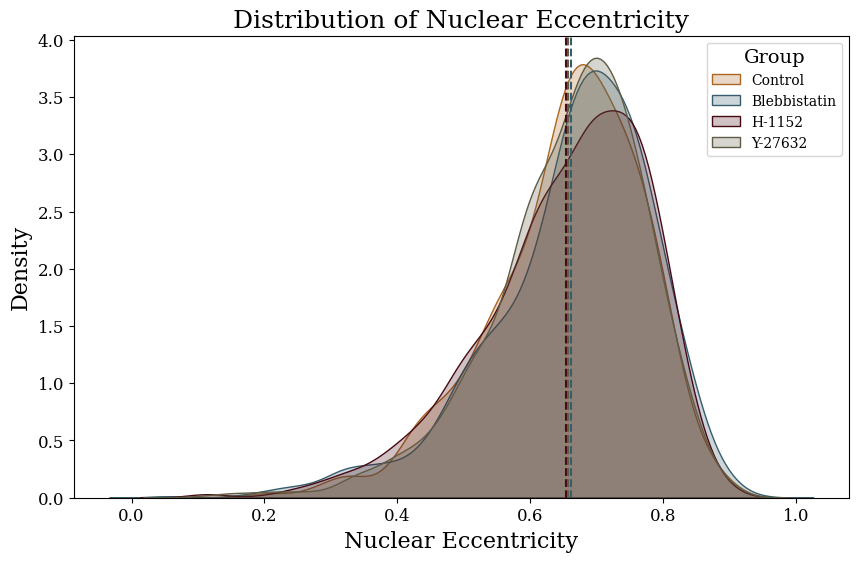

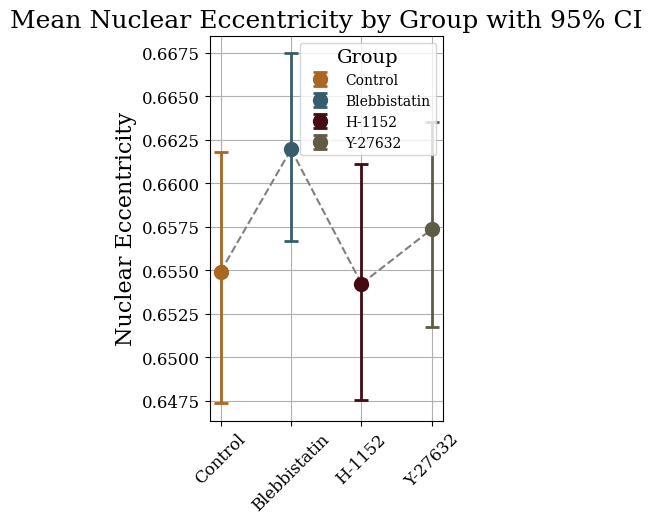


Column: nuc_AreaShape_Solidity
Control mean: 0.97, CV: 0.02
Blebbistatin mean: 0.97, CV: 0.02, p-value: 1.80e-01, effect size: 0.05, 95% CI: [0.97, 0.97]
H-1152 mean: 0.97, CV: 0.02, p-value: 3.31e-01, effect size: 0.04, 95% CI: [0.97, 0.97]
Y-27632 mean: 0.97, CV: 0.02, p-value: 7.79e-01, effect size: 0.01, 95% CI: [0.97, 0.97]


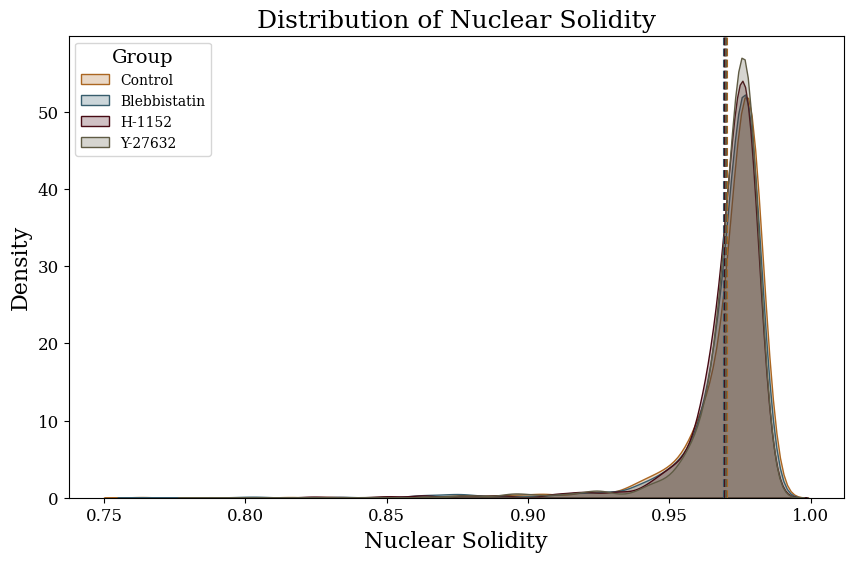

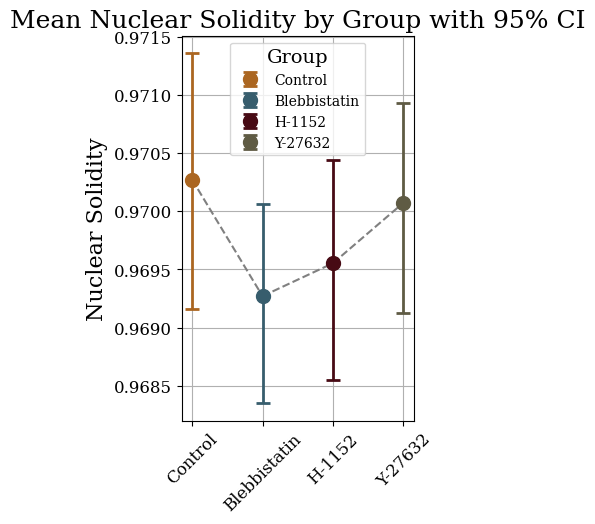


Column: myo_AreaShape_Area
Control mean: 732.78, CV: 0.37
Blebbistatin mean: 742.01, CV: 0.34, p-value: 3.55e-01, effect size: -0.04, 95% CI: [731.10, 751.84]
H-1152 mean: 727.81, CV: 0.38, p-value: 6.74e-01, effect size: 0.02, 95% CI: [713.25, 744.45]
Y-27632 mean: 732.39, CV: 0.33, p-value: 9.71e-01, effect size: 0.00, 95% CI: [720.58, 744.32]


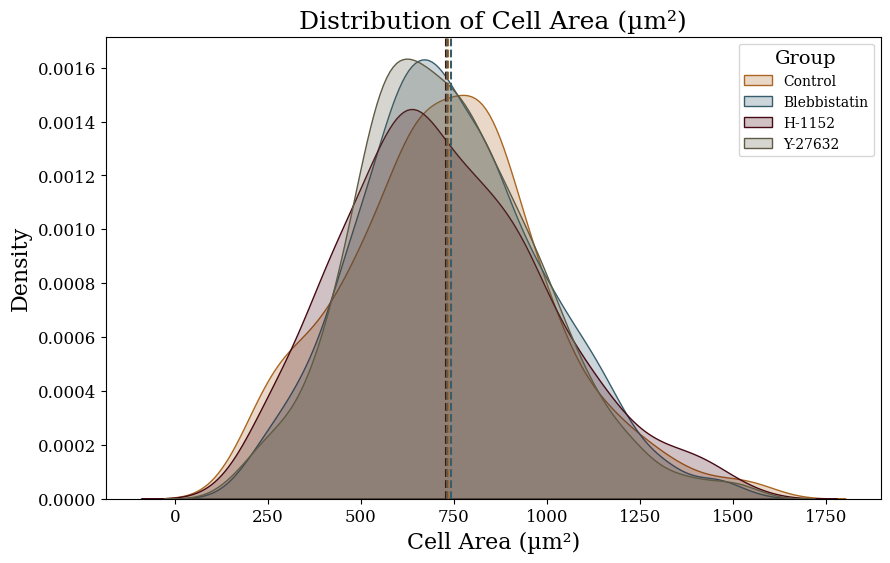

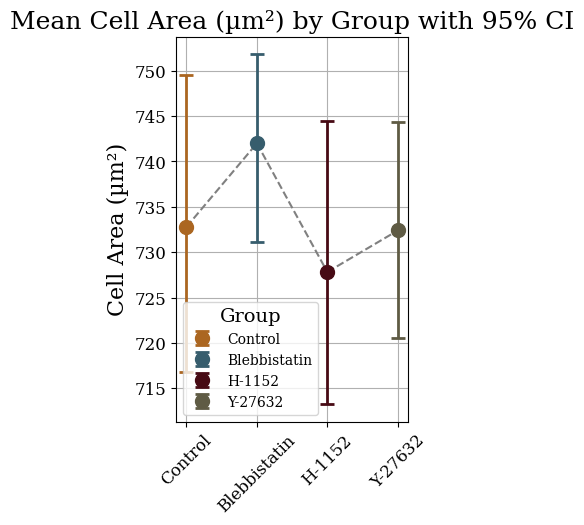


Column: myo_AreaShape_Perimeter
Control mean: 131.54, CV: 0.24
Blebbistatin mean: 135.90, CV: 0.26, p-value: 9.19e-04, effect size: -0.13, 95% CI: [134.46, 137.43]
H-1152 mean: 137.47, CV: 0.26, p-value: 5.01e-05, effect size: -0.17, 95% CI: [135.45, 139.44]
Y-27632 mean: 130.41, CV: 0.21, p-value: 3.49e-01, effect size: 0.04, 95% CI: [129.10, 131.83]


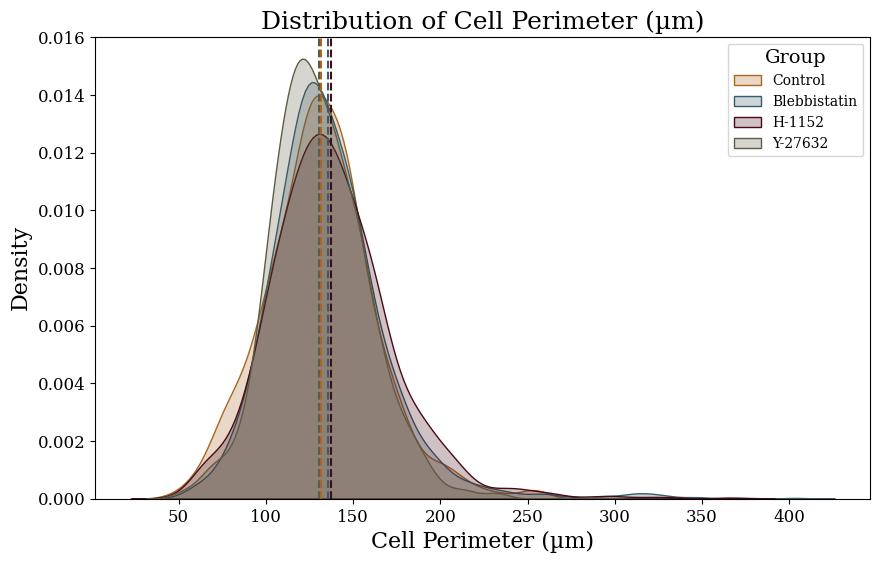

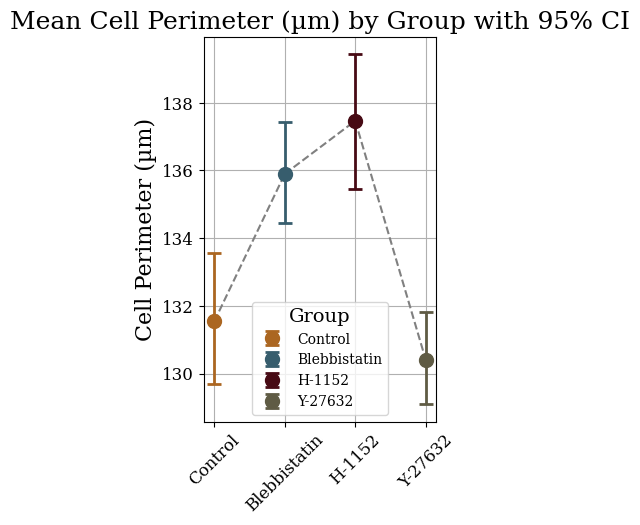


Column: myo_AreaShape_MajorAxisLength
Control mean: 37.90, CV: 0.22
Blebbistatin mean: 38.21, CV: 0.20, p-value: 3.01e-01, effect size: -0.04, 95% CI: [37.90, 38.54]
H-1152 mean: 38.01, CV: 0.23, p-value: 7.48e-01, effect size: -0.01, 95% CI: [37.54, 38.46]
Y-27632 mean: 37.97, CV: 0.21, p-value: 8.26e-01, effect size: -0.01, 95% CI: [37.54, 38.35]


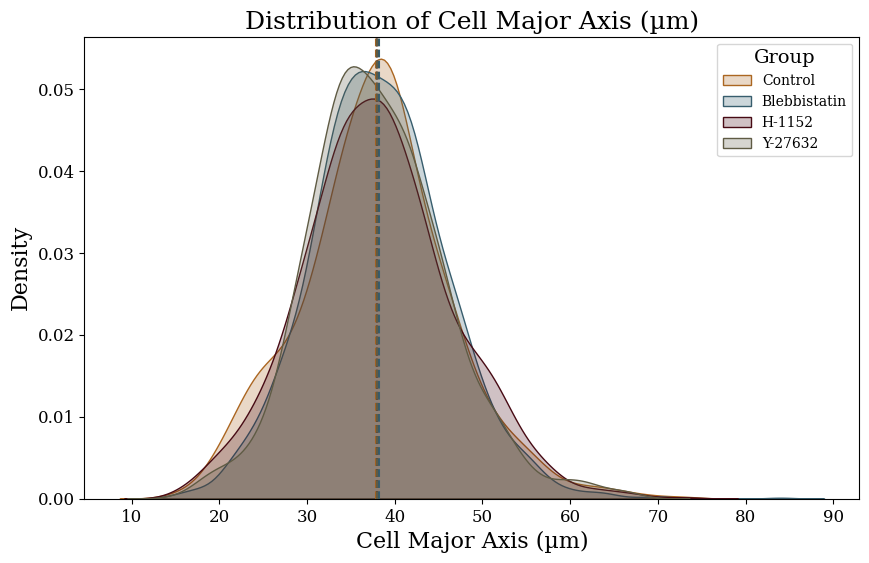

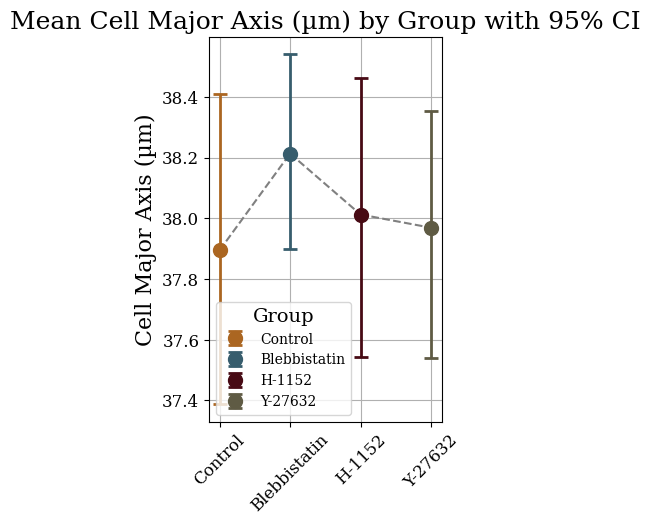


Column: myo_AreaShape_MinorAxisLength
Control mean: 25.73, CV: 0.22
Blebbistatin mean: 26.08, CV: 0.20, p-value: 9.54e-02, effect size: -0.06, 95% CI: [25.86, 26.32]
H-1152 mean: 25.77, CV: 0.22, p-value: 8.58e-01, effect size: -0.01, 95% CI: [25.46, 26.10]
Y-27632 mean: 25.95, CV: 0.20, p-value: 3.26e-01, effect size: -0.04, 95% CI: [25.70, 26.23]


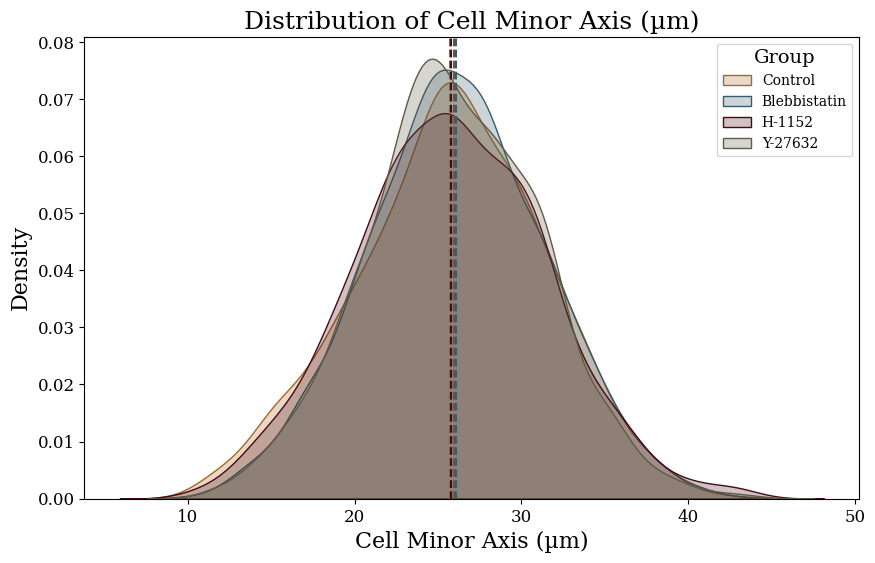

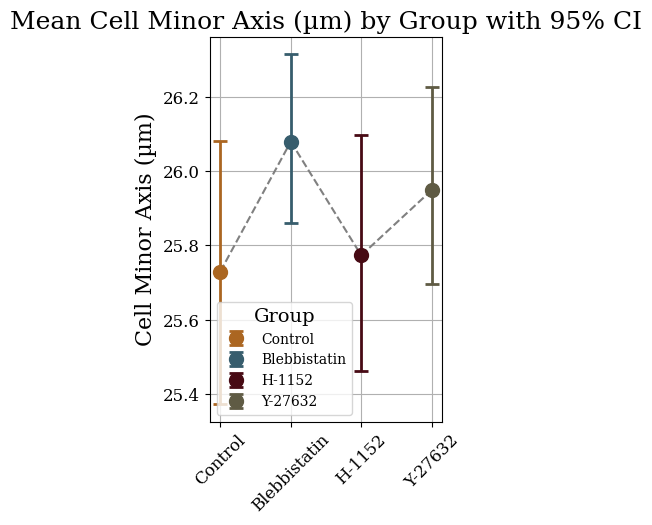


Column: myo_AreaShape_AspectRatio
Control mean: 0.69, CV: 0.19
Blebbistatin mean: 0.70, CV: 0.19, p-value: 5.28e-01, effect size: -0.02, 95% CI: [0.69, 0.70]
H-1152 mean: 0.69, CV: 0.19, p-value: 9.92e-01, effect size: -0.00, 95% CI: [0.68, 0.70]
Y-27632 mean: 0.70, CV: 0.19, p-value: 2.76e-01, effect size: -0.05, 95% CI: [0.69, 0.71]


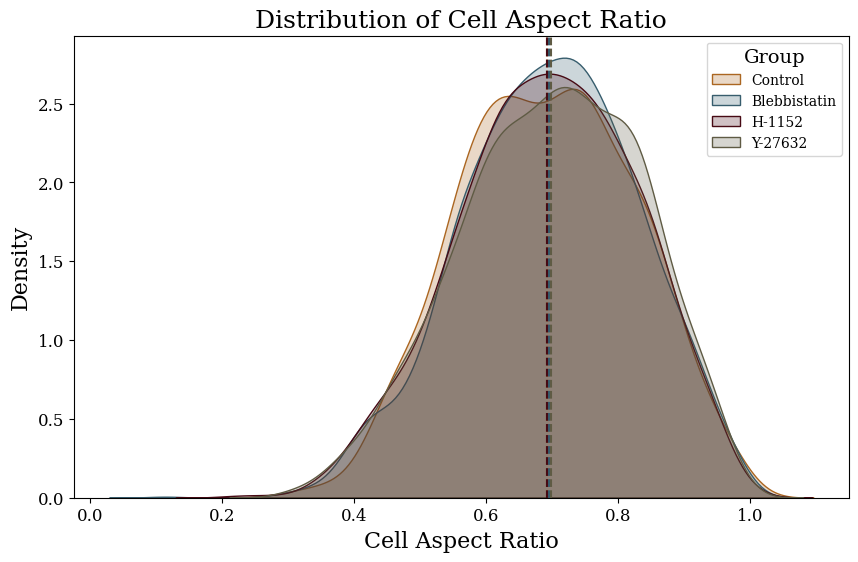

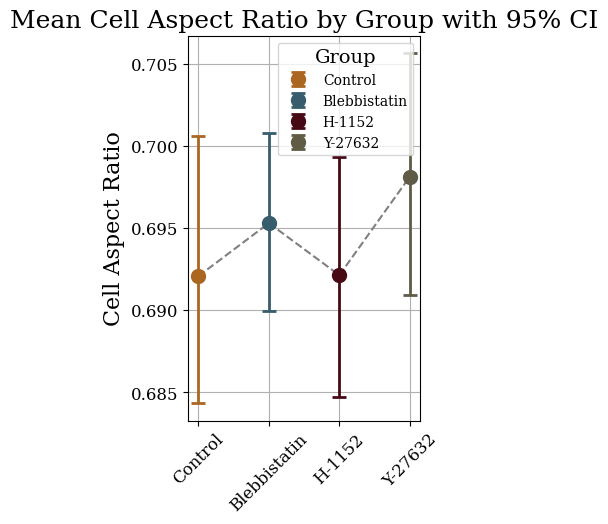


Column: myo_AreaShape_Circularity
Control mean: 0.53, CV: 0.17
Blebbistatin mean: 0.52, CV: 0.22, p-value: 2.68e-02, effect size: 0.09, 95% CI: [0.52, 0.53]
H-1152 mean: 0.50, CV: 0.25, p-value: 8.95e-11, effect size: 0.28, 95% CI: [0.49, 0.51]
Y-27632 mean: 0.54, CV: 0.16, p-value: 1.05e-02, effect size: -0.11, 95% CI: [0.54, 0.54]


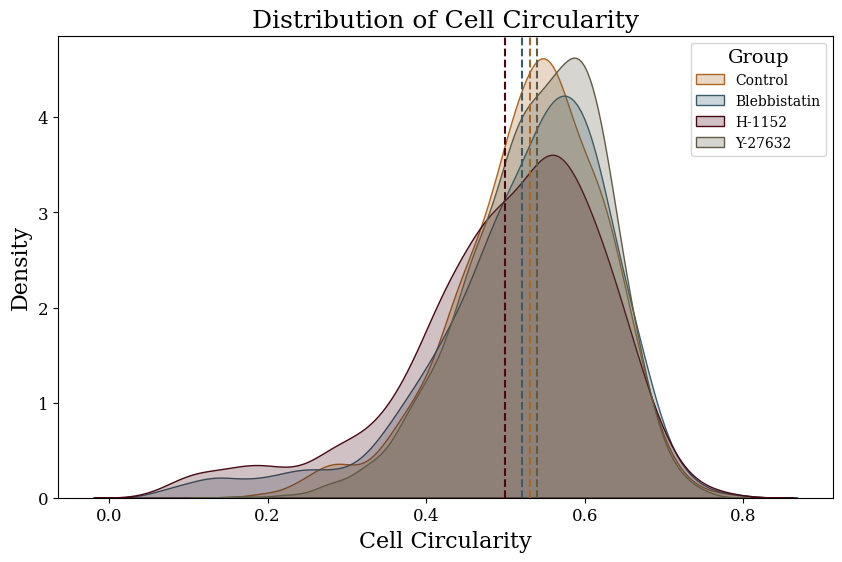

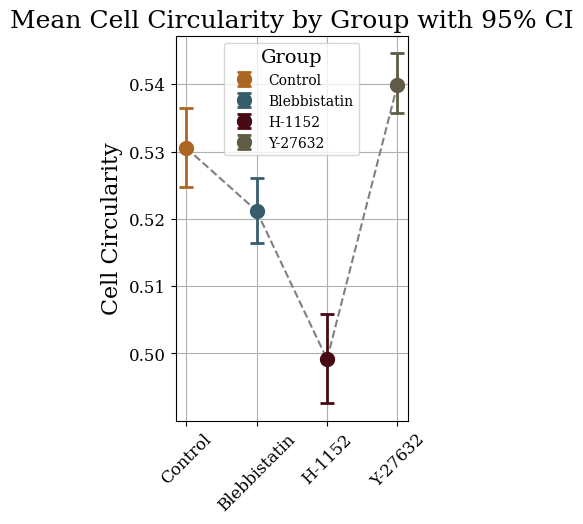


Column: myo_AreaShape_Eccentricity
Control mean: 0.70, CV: 0.21
Blebbistatin mean: 0.69, CV: 0.21, p-value: 5.64e-01, effect size: 0.02, 95% CI: [0.69, 0.70]
H-1152 mean: 0.70, CV: 0.20, p-value: 9.81e-01, effect size: -0.00, 95% CI: [0.69, 0.70]
Y-27632 mean: 0.69, CV: 0.21, p-value: 2.42e-01, effect size: 0.05, 95% CI: [0.68, 0.69]


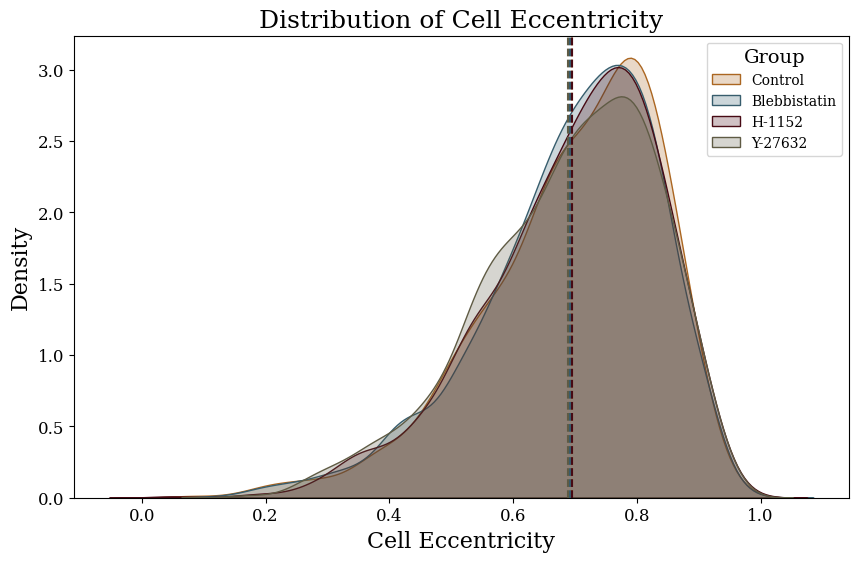

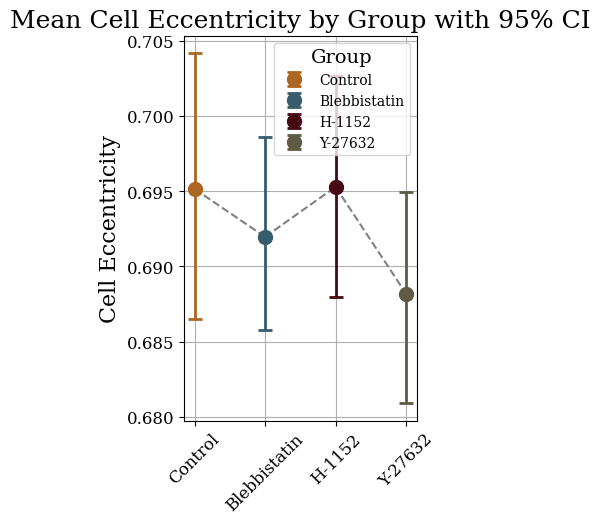


Column: myo_AreaShape_Solidity
Control mean: 0.88, CV: 0.05
Blebbistatin mean: 0.87, CV: 0.07, p-value: 7.23e-04, effect size: 0.13, 95% CI: [0.87, 0.87]
H-1152 mean: 0.86, CV: 0.08, p-value: 1.85e-15, effect size: 0.34, 95% CI: [0.85, 0.86]
Y-27632 mean: 0.87, CV: 0.05, p-value: 1.14e-02, effect size: 0.10, 95% CI: [0.87, 0.87]


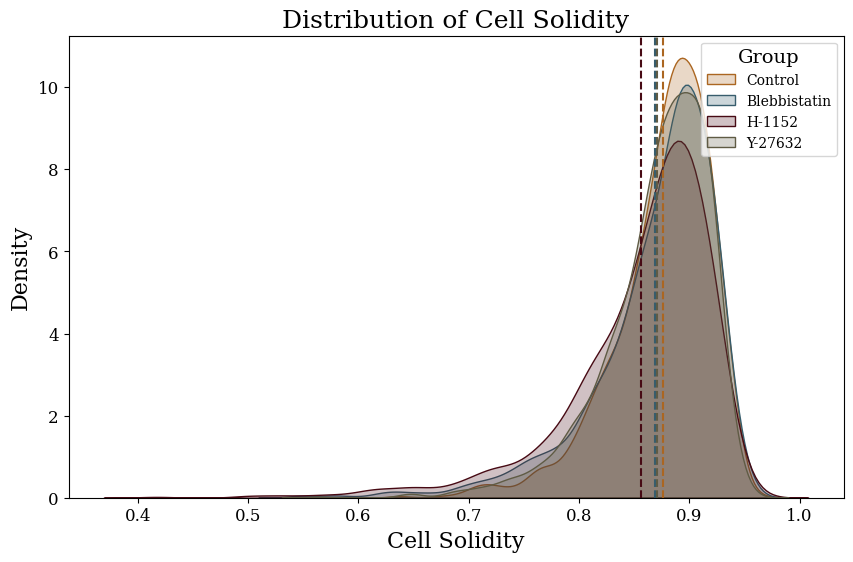

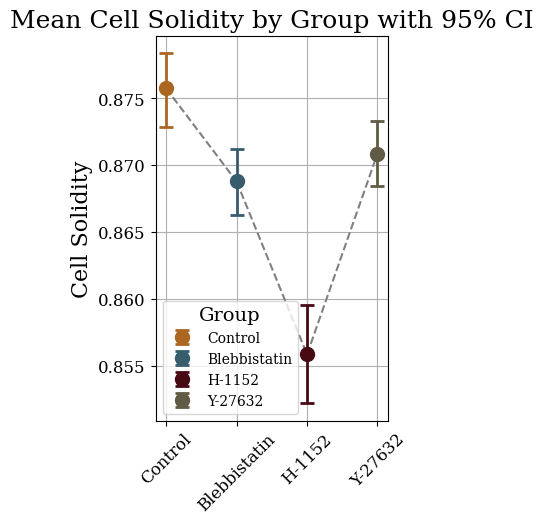


Column: myo_AreaShape_Compactness
Control mean: 1.96, CV: 0.23
Blebbistatin mean: 2.13, CV: 0.55, p-value: 1.39e-05, effect size: -0.17, 95% CI: [2.08, 2.18]
H-1152 mean: 2.27, CV: 0.57, p-value: 6.35e-13, effect size: -0.31, 95% CI: [2.20, 2.34]
Y-27632 mean: 1.91, CV: 0.20, p-value: 4.20e-03, effect size: 0.12, 95% CI: [1.89, 1.93]


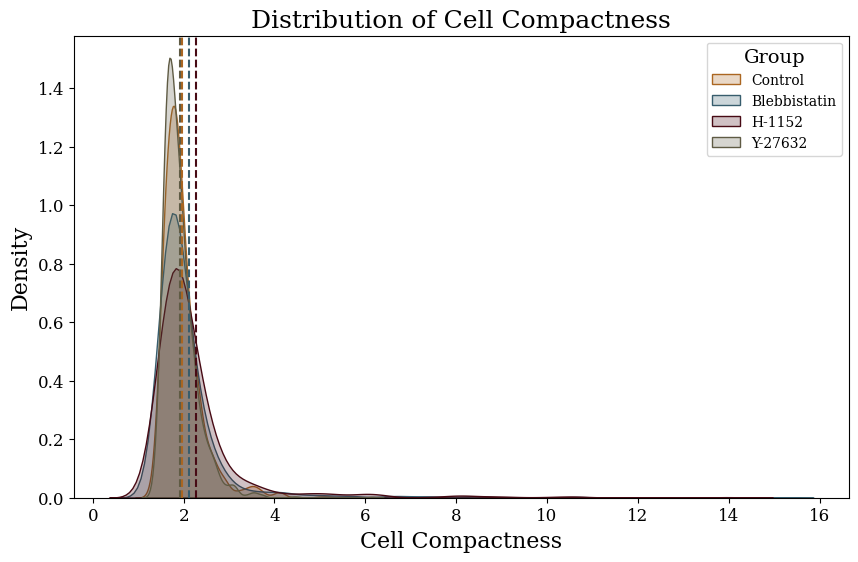

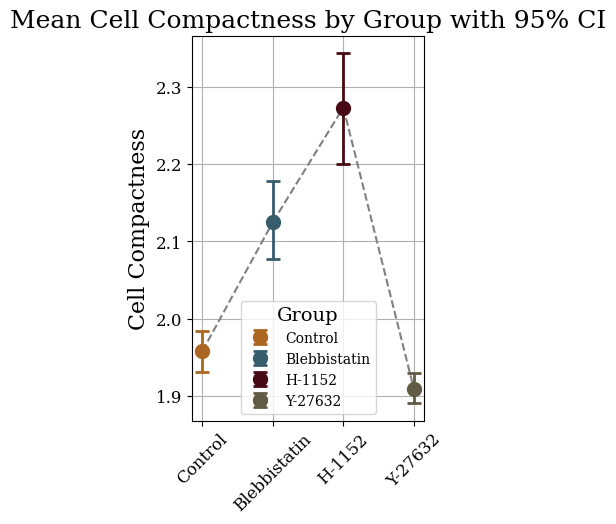

In [24]:
# Histograms in a different color palette and with KDE plots

# Dictionary to map original column names to new names
column_name_mapping = {
    'nuc_AreaShape_Area': 'Nuclear Area (µm²)',
    'nuc_AreaShape_Perimeter': 'Nuclear Perimeter (µm)',
    'nuc_AreaShape_MajorAxisLength': 'Nuclear Major Axis (µm)',
    'nuc_AreaShape_MinorAxisLength': 'Nuclear Minor Axis (µm)',
    'nuc_AreaShape_AspectRatio': 'Nuclear Aspect Ratio',
    'nuc_AreaShape_Circularity': 'Nuclear Circularity',
    'nuc_AreaShape_Eccentricity': 'Nuclear Eccentricity',
    'nuc_AreaShape_Solidity': 'Nuclear Solidity',
    'myo_AreaShape_Area': 'Cell Area (µm²)',
    'myo_AreaShape_Perimeter': 'Cell Perimeter (µm)',
    'myo_AreaShape_MajorAxisLength': 'Cell Major Axis (µm)',
    'myo_AreaShape_MinorAxisLength': 'Cell Minor Axis (µm)',
    'myo_AreaShape_AspectRatio': 'Cell Aspect Ratio',
    'myo_AreaShape_Circularity': 'Cell Circularity',
    'myo_AreaShape_Eccentricity': 'Cell Eccentricity',
    'myo_AreaShape_Solidity': 'Cell Solidity',
    'myo_AreaShape_Compactness': 'Cell Compactness',
}

# Function to calculate Cohen's d effect size: describes the difference between two groups in terms of standard deviation
def cohen_d(x, y):
    nx = len(x)
    ny = len(y)
    dof = nx + ny - 2
    pooled_std = np.sqrt(((nx - 1) * np.std(x, ddof=1) ** 2 + (ny - 1) * np.std(y, ddof=1) ** 2) / dof)
    return (np.mean(x) - np.mean(y)) / pooled_std

# Function to calculate bootstrap confidence intervals: resampling method to estimate the sampling distribution of a statistic
def bootstrap_ci(data, func, n_bootstrap=1000, ci=95):
    bootstraps = np.random.choice(data, (n_bootstrap, len(data)), replace=True)
    stat = np.array([func(sample) for sample in bootstraps])
    lower = np.percentile(stat, (100 - ci) / 2)
    upper = np.percentile(stat, 100 - (100 - ci) / 2)
    return lower, upper

# List of columns for histograms
columns = list(column_name_mapping.keys())

# color palette for each treatment group colorblind friendly
group_colors = {
    'Ctl': '#AB6621',  # Tiger's eye
    'Ble': '#375D6D',  # Payne's gray
    'H11': '#470A14',  # Chocolate cosmos
    'Y27': '#5F5B44',  # Ebony
}

# Mapping from original group names to display names
group_display_names = {
    'Ctl': 'Control',
    'Ble': 'Blebbistatin',
    'H11': 'H-1152',
    'Y27': 'Y-27632',
}

# Set default font properties
plt.rcParams.update({
    'font.size': 14,  # Default font size
    'font.family': 'serif',  # Default font family
    'axes.titlesize': 18,  # Title font size
    'axes.labelsize': 16,  # X and Y label font size
    'legend.fontsize': 10,  # Legend font size
    'xtick.labelsize': 12,  # X tick label font size
    'ytick.labelsize': 12,  # Y tick label font size
})

# Directory to save the figures
save_dir = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/Figures/"

# Ensure the directory exists
os.makedirs(save_dir, exist_ok=True)

# Loop through the columns and create KDE plots and dumbbell plots
for column in columns:
    plt.figure(figsize=(10, 6))
    means = {}
    ci_lower = {}
    ci_upper = {}
    p_values = {}
    print(f"\nColumn: {column}")
    for group, color in group_colors.items():
        group_data = df_cleaned[df_cleaned['group'] == group][column]
        sns.kdeplot(group_data, fill=True, color=color, label=group_display_names[group])
        means[group] = group_data.mean()

        # Calculate CV (Coefficient of Variation)
        cv = group_data.std() / group_data.mean()

        # Calculate 95% CI
        ci_lower[group], ci_upper[group] = bootstrap_ci(group_data, np.mean)

        # t-test against control group
        if group != 'Ctl':
            control_data = df_cleaned[df_cleaned['group'] == 'Ctl'][column]
            t_stat, p_val = stats.ttest_ind(control_data, group_data)
            effect_size = cohen_d(control_data, group_data)
            p_values[group] = p_val
            print(f"{group_display_names[group]} mean: {means[group]:.2f}, CV: {cv:.2f}, p-value: {p_val:.2e}, effect size: {effect_size:.2f}, 95% CI: [{ci_lower[group]:.2f}, {ci_upper[group]:.2f}]")
        else:
            print(f"{group_display_names[group]} mean: {means[group]:.2f}, CV: {cv:.2f}")

    # Annotate mean lines
    for group, mean in means.items():
        plt.axvline(mean, color=group_colors[group], linestyle='--')

    # # Stat significance
    # for group, p_val in p_values.items():
    #     if p_val < 0.05:
    #         # Calculate the maximum y-value of the KDE plot
    #         max_y = plt.gca().get_ylim()[1]
    #         plt.text(means[group], max_y * 0.95, '*', fontsize=20, color='magenta', ha='center')

    # Transform column name for title and labels
    transformed_column_name = column_name_mapping[column]
    plt.title(f'Distribution of {transformed_column_name}')
    plt.xlabel(transformed_column_name)
    plt.ylabel('Density')
    plt.legend(title='Group')
    plt.grid(False)

      # Save the figure
    filename = f"Hist_{column}_byGroup.png"
    plt.savefig(os.path.join(save_dir, filename), dpi=300, bbox_inches='tight')
    
    plt.show()

    # Create dumbbell plot with switched axes: describes the mean and 95% CI of each group
    plt.figure(figsize=(3, 5))
    for group, color in group_colors.items():
        plt.errorbar(y=means[group], 
                     x=group_display_names[group], 
                     yerr=[[means[group] - ci_lower[group]], [ci_upper[group] - means[group]]],
                     fmt='o', 
                     color=color, 
                     label=group_display_names[group], 
                     capsize=5, 
                     markersize=10, 
                     linewidth=2, 
                     capthick=2)
    
    # Connect means with lines
    for i in range(len(group_display_names) - 1):
        group1 = list(group_display_names.keys())[i]
        group2 = list(group_display_names.keys())[i + 1]
        plt.plot([group_display_names[group1], group_display_names[group2]], [means[group1], means[group2]], color='gray', linestyle='--')

    plt.ylabel(transformed_column_name)
    plt.xlabel('')
    plt.title(f'Mean {transformed_column_name} by Group with 95% CI')
    plt.grid(True)
    plt.legend(title='Group')
    plt.xticks(rotation=45)
    
    # Save the dumbbell plot at 300 DPI
    filename = f"Dumbbell_{column}_byGroup.png"
    plt.savefig(os.path.join(save_dir, filename), dpi=300, bbox_inches='tight')
    
    plt.show()



## Multiplot figure for publication

/var/folders/vg/qyk8wk2n33389vbkssssdjz40000gp/T/ipykernel_52437/1594423234.py:75: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[1, 1].set_xticklabels(group_display_names.values(), rotation=45)


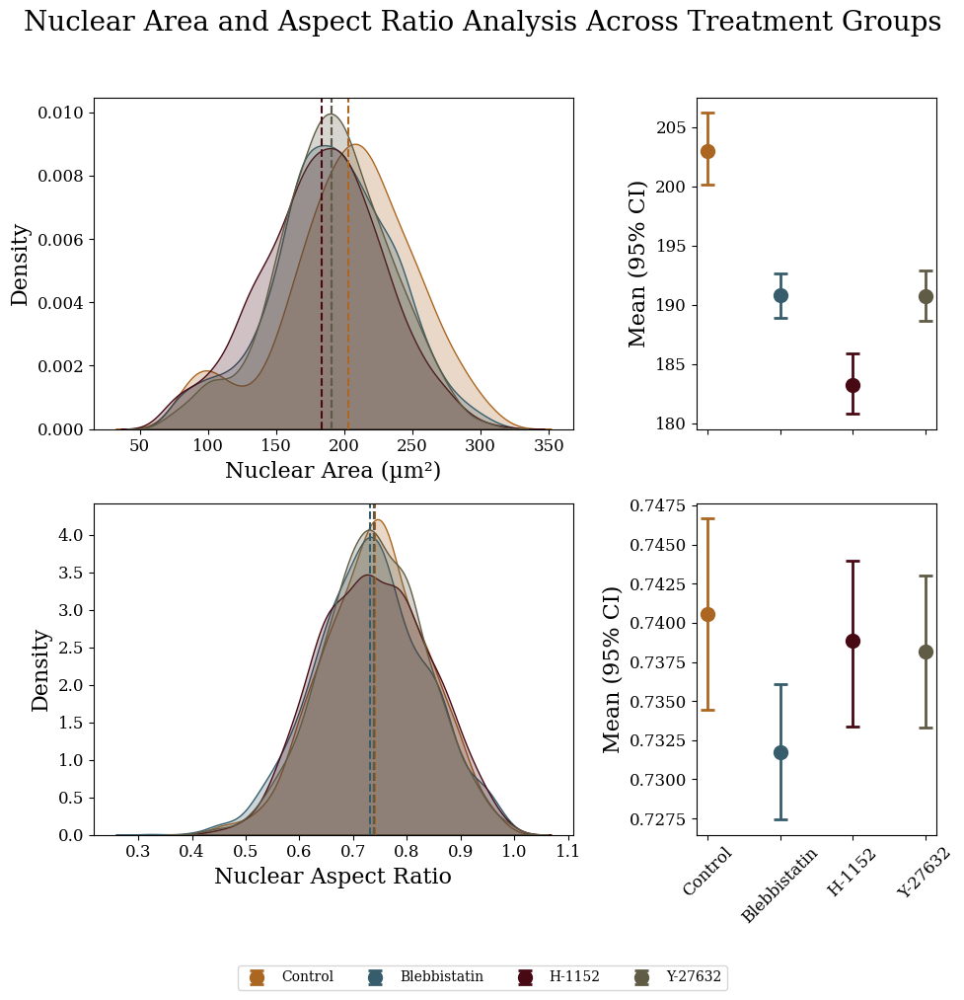

In [25]:
# Create a multiplot figure with adjusted widths for the right column

# color palette for each treatment group colorblind friendly
group_colors = {
    'Ctl': '#AB6621',  # Tiger's eye
    'Ble': '#375D6D',  # Payne's gray
    'H11': '#470A14',  # Chocolate cosmos
    'Y27': '#5F5B44',  # Ebony
}

fig, axes = plt.subplots(2, 2, figsize=(10, 10), gridspec_kw={'width_ratios': [2, 1]})

# Plot the distribution of Nuclear Area
column = 'nuc_AreaShape_Area'
means_area = {}
ci_lower_area = {}
ci_upper_area = {}
for group, color in group_colors.items():
    group_data = df_cleaned[df_cleaned['group'] == group][column]
    sns.kdeplot(group_data, fill=True, color=color, ax=axes[0, 0])
    means_area[group] = group_data.mean()
    ci_lower_area[group], ci_upper_area[group] = bootstrap_ci(group_data, np.mean)
    axes[0, 0].axvline(means_area[group], color=color, linestyle='--')
axes[0, 0].set_xlabel('Nuclear Area (µm²)')
axes[0, 0].set_ylabel('Density')
axes[0, 0].grid(False)

# Plot the dumbbell plot for Nuclear Area
for group, color in group_colors.items():
    axes[0, 1].errorbar(y=means_area[group], 
                        x=group_display_names[group], 
                        yerr=[[means_area[group] - ci_lower_area[group]], [ci_upper_area[group] - means_area[group]]],
                        fmt='o', 
                        color=color, 
                        label=group_display_names[group], 
                        capsize=5, 
                        markersize=10, 
                        linewidth=2, 
                        capthick=2)
axes[0, 1].set_ylabel('Mean (95% CI)')
axes[0, 1].set_xlabel('')
axes[0, 1].grid(False)
axes[0, 1].set_xticklabels('')

# Plot the distribution of Nuclear Aspect Ratio
column = 'nuc_AreaShape_AspectRatio'
means_aspect_ratio = {}
ci_lower_aspect_ratio = {}
ci_upper_aspect_ratio = {}
for group, color in group_colors.items():
    group_data = df_cleaned[df_cleaned['group'] == group][column]
    sns.kdeplot(group_data, fill=True, color=color, ax=axes[1, 0])
    means_aspect_ratio[group] = group_data.mean()
    ci_lower_aspect_ratio[group], ci_upper_aspect_ratio[group] = bootstrap_ci(group_data, np.mean)
    axes[1, 0].axvline(means_aspect_ratio[group], color=color, linestyle='--')
axes[1, 0].set_xlabel('Nuclear Aspect Ratio')
axes[1, 0].set_ylabel('Density')
axes[1, 0].grid(False)

# Plot the dumbbell plot for Nuclear Aspect Ratio
for group, color in group_colors.items():
    axes[1, 1].errorbar(y=means_aspect_ratio[group], 
                        x=group_display_names[group], 
                        yerr=[[means_aspect_ratio[group] - ci_lower_aspect_ratio[group]], [ci_upper_aspect_ratio[group] - means_aspect_ratio[group]]],
                        fmt='o', 
                        color=color, 
                        label=group_display_names[group], 
                        capsize=5, 
                        markersize=10, 
                        linewidth=2, 
                        capthick=2)
axes[1, 1].set_ylabel('Mean (95% CI)')
axes[1, 1].set_xlabel('')
axes[1, 1].grid(False)
axes[1, 1].set_xticklabels(group_display_names.values(), rotation=45)

# Add a single legend for the dumbbell plots below all plots
handles, labels = axes[0, 1].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.05), ncol=len(group_display_names))

# Add a main title at the top of the figure
fig.suptitle('Nuclear Area and Aspect Ratio Analysis Across Treatment Groups', fontsize=20, y=0.95)

# Adjust layout and save the multiplot figure
plt.tight_layout(rect=[0, 0, 1, 0.93])
filename = "Multiplot_Nuclear_Area_Aspect_Ratio.png"
plt.savefig(os.path.join(save_dir, filename), dpi=300, bbox_inches='tight')
plt.show()


# Regression analysis - Simple Linear Regression 

In [ ]:
# R² values for all feature pairs by group (coefficient of determination - how well the regression model explains the variability of the data)

# Function to evaluate regression using Ordinary Least Squares (OLS) and return p-value and R² value
def evaluate_regression(x_col, y_col, data):
    data = data[[x_col, y_col]].apply(pd.to_numeric, errors='coerce').dropna()
    if data.empty or data[y_col].nunique() == 1:
        return np.nan, np.nan, None
    # Fit linear model
    X = sm.add_constant(data[x_col])  # Add constant term to the predictor (one predictor column only)
    y = data[y_col]
    model = sm.OLS(y, X).fit()
    
    # Calculate R² and p-value
    r_squared = model.rsquared
     # Check if the model has the slope term
    if len(model.pvalues) > 1:
        p_value = model.pvalues.iloc[1]  # p-value for the slope term
    else:
        p_value = np.nan
    
    return p_value, r_squared, model

# Store significant pairs for normalized data
significant_pairs_normalized = []

# Exclude the 'Class' or 'group' column
features = df_cleaned.columns.difference(['group'])

# Initialize the R² matrix
nuc_features = features[features.str.startswith('nuc_AreaShape')]
cell_features = features[features.str.startswith('myo_AreaShape')]

# Initialize a list to store regression results
regression_results = []

# Iterate over each group
for group_name, group_data in df_cleaned.groupby('group'):
    # Calculate R² values for all feature pairs and store them in the list
    for x_col in nuc_features:
        for y_col in cell_features:
            p_value, r_squared, _ = evaluate_regression(x_col, y_col, group_data)
            regression_results.append({
                'Group': group_name,
                'Dependent Feature': x_col, # Nucleus feature
                'Independent Feature': y_col, # Cell feature
                'R²': r_squared,
                'p-value': p_value
            })

# Convert the results to a DataFrame
regression_results_df = pd.DataFrame(regression_results)

# Define the output path
output_path = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/OLS_results.csv"

# Save the DataFrame to a CSV file
regression_results_df.to_csv(output_path, index=False)

print(f"Results saved to {output_path}")

# Initialize a dictionary to store R² matrices for each group
r_squared_matrices_by_group = {}

# Iterate over each group to calculate R² matrices
for group_name, group_data in df_cleaned.groupby('group'):
    r_squared_matrix = pd.DataFrame(np.nan, index=nuc_features, columns=cell_features)
    for x_col in nuc_features:
        for y_col in cell_features:
            _, r_squared, _ = evaluate_regression(x_col, y_col, group_data)
            r_squared_matrix.loc[x_col, y_col] = r_squared
    r_squared_matrices_by_group[group_name] = r_squared_matrix

# Create a DataFrame to store the counts of R² values in different ranges
r_squared_counts = []

# For each group, calculate the counts of R² values in the specified ranges
for group_name, r_squared_matrix in r_squared_matrices_by_group.items():
    r_squared_values = r_squared_matrix.values.flatten()
    r_squared_values = r_squared_values[~np.isnan(r_squared_values)]
    
    r_squared_00_03 = np.sum((r_squared_values >= 0.0) & (r_squared_values < 0.3))
    r_squared_03_04 = np.sum((r_squared_values >= 0.3) & (r_squared_values < 0.4))
    r_squared_04_05 = np.sum((r_squared_values >= 0.4) & (r_squared_values < 0.5))
    r_squared_05_07 = np.sum((r_squared_values >= 0.5) & (r_squared_values < 0.7))
    r_squared_07_08 = np.sum((r_squared_values >= 0.7) & (r_squared_values < 0.8))
    r_squared_08_09 = np.sum((r_squared_values >= 0.8) & (r_squared_values < 0.9))
    r_squared_09 = np.sum(r_squared_values >= 0.9)
    
    r_squared_counts.append({
        'Group': group_name,
        'R² between 0.0-0.3': r_squared_00_03,
        'R² between 0.3-0.4': r_squared_03_04,
        'R² between 0.4-0.5': r_squared_04_05,
        'R² between 0.5-0.7': r_squared_05_07,
        'R² between 0.7-0.8': r_squared_07_08,
        'R² between 0.8-0.9': r_squared_08_09,
        'R² above 0.9': r_squared_09
    })

# Convert the counts to a DataFrame
r_squared_counts_df = pd.DataFrame(r_squared_counts)

# Print the counts for each group
print(r_squared_counts_df)


Results saved to /Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/OLS_results.csv
  Group  R² between 0.0-0.3  R² between 0.3-0.4  R² between 0.4-0.5  \
0   Ble                3553                 192                  95   
1   Ctl                3465                 200                 114   
2   H11                3352                 224                 178   
3   Y27                3530                 196                  79   

   R² between 0.5-0.7  R² between 0.7-0.8  R² between 0.8-0.9  R² above 0.9  
0                   4                   0                   0             0  
1                  65                   0                   0             0  
2                  90                   0                   0             0  
3                  39                   0                   0             0  


## heatmaps of R²

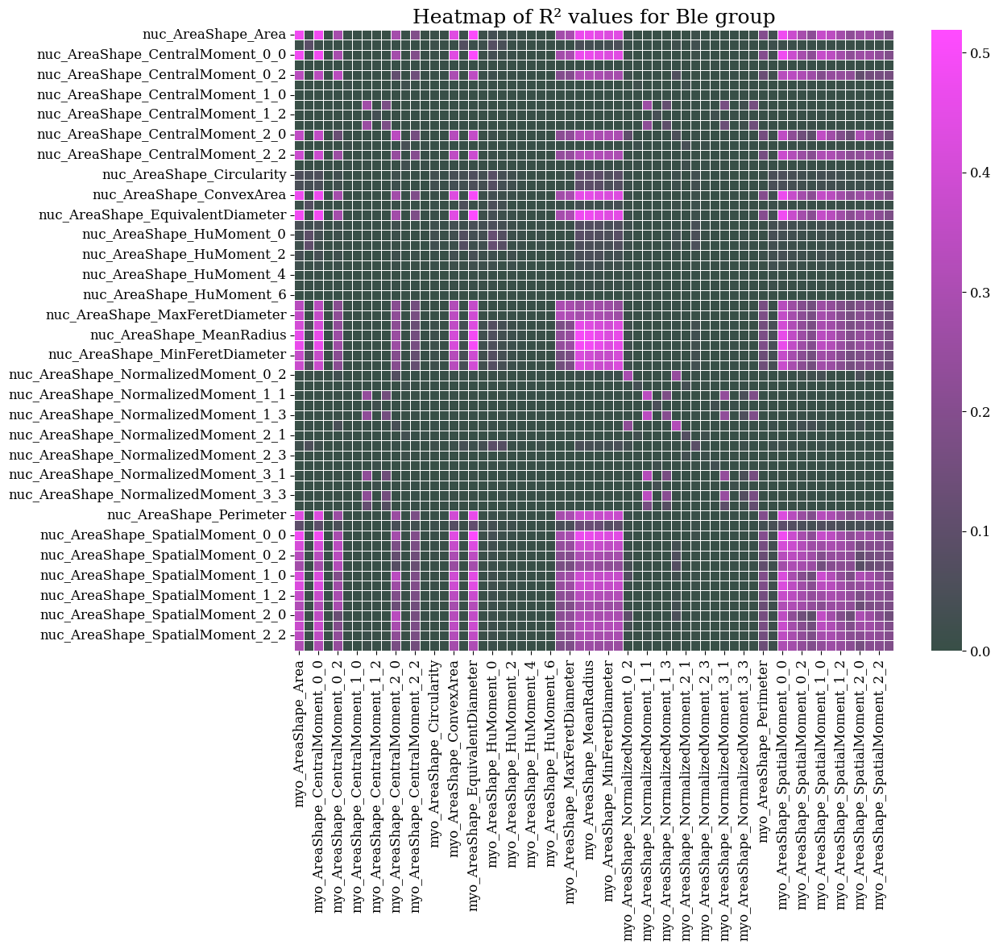

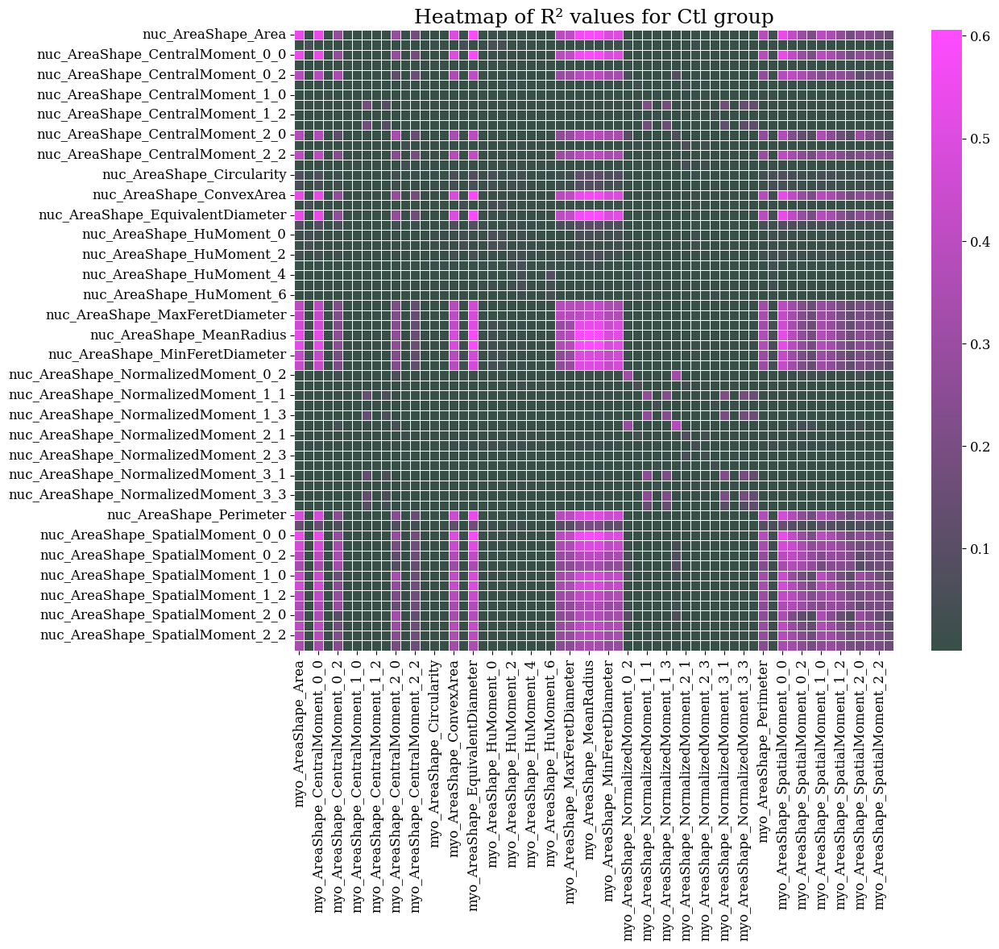

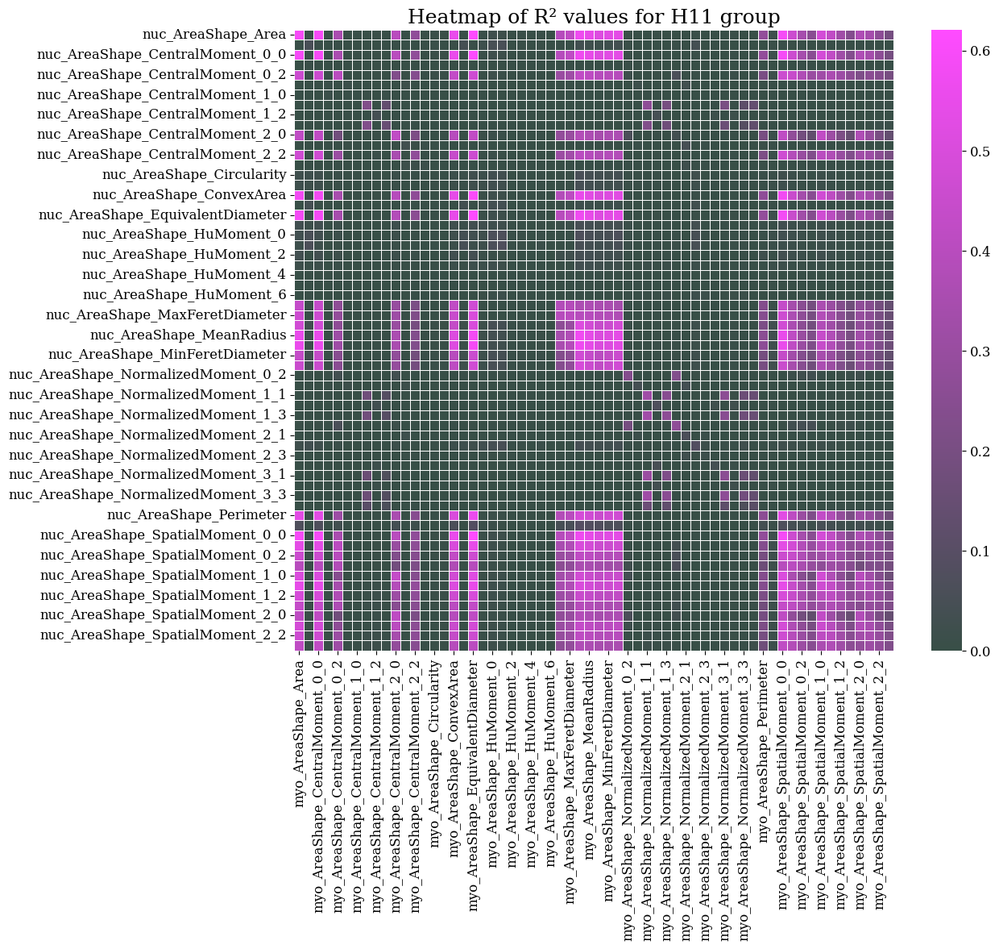

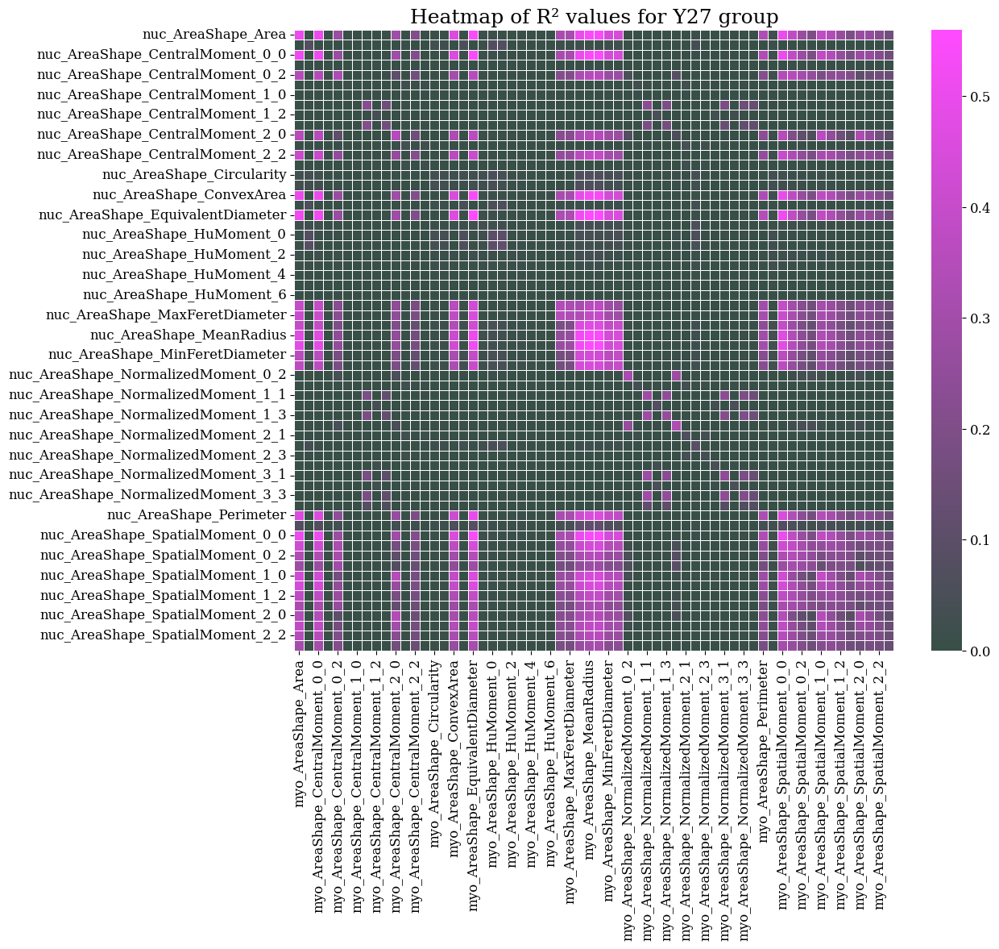

In [29]:
# Heatmaps of R² values for each group

# Define custom colormap
colors = ['#384F47', '#FF4BFF'] #blue #2D1B94; dark green #384F47
custom_cmap = LinearSegmentedColormap.from_list('custom_cmap', colors)

# Function to plot heatmap for a given R² matrix and group name
def plot_heatmap(r_squared_matrix, group_name):
    plt.figure(figsize=(12, 10))
    sns.heatmap(r_squared_matrix.astype(float), annot=False, cmap=custom_cmap, linewidths=0.5)
    plt.title(f'Heatmap of R² values for {group_name} group')
    plt.show()

# Initialize a dictionary to store R² matrices for each group
r_squared_matrices_by_group = {}

# Create R² matrices for each group from the regression results
for group_name in regression_results_df['Group'].unique():
    group_data = regression_results_df[regression_results_df['Group'] == group_name]
    r_squared_matrix = pd.DataFrame(np.nan, index=nuc_features, columns=cell_features)
    for _, row in group_data.iterrows():
        r_squared_matrix.loc[row['Dependent Feature'], row['Independent Feature']] = row['R²']
    r_squared_matrices_by_group[group_name] = r_squared_matrix

# Iterate over each group and plot the heatmap
for group_name, r_squared_matrix in r_squared_matrices_by_group.items():
    plot_heatmap(r_squared_matrix, group_name)

## violin plots of R²

Number of nuclear features: 18


/var/folders/vg/qyk8wk2n33389vbkssssdjz40000gp/T/ipykernel_52437/3579730848.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(data=trimmed_ols_results_df, x='Group', y='R²', palette=group_colors)


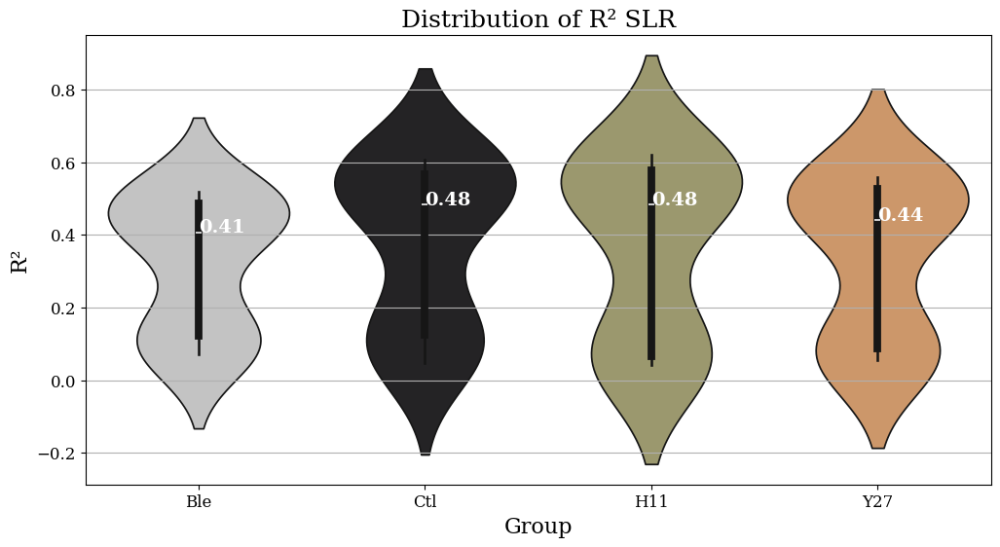

In [30]:
# violin plots of R² values for each group

# Define the color palette for each treatment group (colorblind-friendly)
group_colors = {
    'Ctl': '#242325',  # Raisin Black
    'Ble': '#C3C3C3',  # Silver
    'H11': '#A29E67',  # Moss Green
    'Y27': '#DC965A',   # Persian Orange
}

# exclude features that have 'Moment' in the name of the Dependent Feature
trimmed_ols_results_df = regression_results_df[~regression_results_df['Dependent Feature'].str.contains('Moment')]

# only using the highest R² values for each feature
trimmed_ols_results_df = trimmed_ols_results_df.groupby(['Group', 'Dependent Feature']).max().reset_index()

medians = trimmed_ols_results_df.groupby('Group')['R²'].median()

# Create a violin plot of R² scores for each group
plt.figure(figsize=(12, 6))
ax = sns.violinplot(data=trimmed_ols_results_df, x='Group', y='R²', palette=group_colors)

# Annotate the plot with median values
for i, group in enumerate(medians.index):
    median_value = medians[group]
    ax.text(i, median_value, f'{median_value:.2f}', horizontalalignment='left', size='medium', color='white', weight='semibold')

plt.title('Distribution of R² SLR')
plt.ylabel('R²')
plt.xlabel('Group')
plt.grid(axis='y')

# how many nuclear features are in these plots
nuc_features = trimmed_ols_results_df['Dependent Feature'].unique()
print(f"Number of nuclear features: {len(nuc_features)}")
# Show the plot
plt.show()

## Bar plot comparing R²

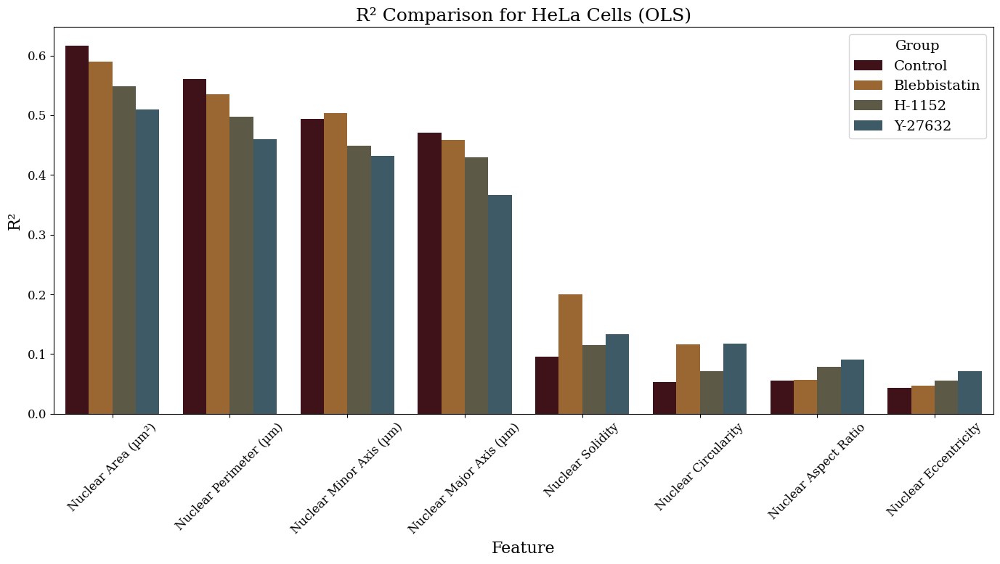

In [33]:
# Bar plot of R² results for each group

# Define the color palette for each treatment group (colorblind-friendly)
group_colors = {
    'Ctl': '#AB6621',  # Tiger's eye
    'Ble': '#375D6D',  # Payne's gray
    'H11': '#470A14',  # Chocolate cosmos
    'Y27': '#5F5B44',  # Ebony
}
# Mapping from original group names to display names
group_display_names = {
    'Ctl': 'Control',
    'Ble': 'Blebbistatin',
    'H11': 'H-1152',
    'Y27': 'Y-27632',
}
# Define the order of the groups
group_order = list(group_colors.keys())

# Set default font properties
plt.rcParams.update({
    'font.size': 14,  # Default font size
    'font.family': 'serif',  # Default font family
    'axes.titlesize': 18,  # Title font size
    'axes.labelsize': 16,  # X and Y label font size
    'legend.fontsize': 14,  # Legend font size
    'xtick.labelsize': 12,  # X tick label font size
    'ytick.labelsize': 12,  # Y tick label font size
})

# exclude features that have 'Moment' in the name of the Dependent Feature
trimmed_ols_results_df = regression_results_df[~regression_results_df['Dependent Feature'].str.contains('Moment')]

# only using the highest R² values for each feature
trimmed_ols_results_df = trimmed_ols_results_df.groupby(['Group', 'Dependent Feature']).max().reset_index()

# Sort the DataFrame by 'R² Score' in descending order
ols_sorted_results_df = trimmed_ols_results_df.sort_values(by='R²', ascending=False)

# Melt the DataFrame to long format for seaborn
ols_melted_df = ols_sorted_results_df.melt(id_vars=['Group', 'Dependent Feature'], value_vars=['R²'], var_name='Metric', value_name='Value')

# Map the original column names to the new names
ols_melted_df['Dependent Feature'] = ols_melted_df['Dependent Feature'].map(column_name_mapping)

# Create the plot
plt.figure(figsize=(14, 8))
sns.barplot(data=ols_melted_df, x='Dependent Feature', y='Value', hue='Group', palette=group_colors)
plt.title('R² Comparison for HeLa Cells (OLS)')
plt.xlabel('Feature')
plt.ylabel('R²')
plt.xticks(rotation=45)
legend = plt.legend(title='Group')
for text, original_name in zip(legend.texts, group_order):
    text.set_text(group_display_names[original_name])  # Replace with display name

plt.tight_layout()

# Show the plot
plt.show()

## Feature pairs with high R²

In [ ]:
# feature pairs with significant R² within groups

# Define the threshold for significant r squared values
significant_r_squared_threshold = 0.55

# Filter the DataFrame to find significant R² values
significant_r_squared_df = regression_results_df[regression_results_df['R²'] > significant_r_squared_threshold]

# Initialize a list to store the feature pairs that meet the criteria
significant_r_squared = significant_r_squared_df[['Group', 'Dependent Feature', 'Independent Feature', 'R²']].values.tolist()

# sort the list by R² values descending
significant_r_squared.sort(key=lambda x: x[3], reverse=True)

# Display how many feature pairs meet the criteria
print(f"Number of feature pairs with significant R² values: {len(significant_r_squared)}")

# Print the list of feature pairs with significant differences
for group_name, x_col, y_col, r_squared in significant_r_squared:
    print(f"Group: {group_name}, X Feature: {x_col}, Y Feature: {y_col}, R²: {r_squared:.4f}")


Number of feature pairs with significant R² values: 71
Group: H11, X Feature: nuc_AreaShape_EquivalentDiameter, Y Feature: myo_AreaShape_EquivalentDiameter, R²: 0.6206
Group: H11, X Feature: nuc_AreaShape_Area, Y Feature: myo_AreaShape_EquivalentDiameter, R²: 0.6167
Group: H11, X Feature: nuc_AreaShape_CentralMoment_0_0, Y Feature: myo_AreaShape_EquivalentDiameter, R²: 0.6167
Group: H11, X Feature: nuc_AreaShape_SpatialMoment_0_0, Y Feature: myo_AreaShape_EquivalentDiameter, R²: 0.6167
Group: Ctl, X Feature: nuc_AreaShape_MedianRadius, Y Feature: myo_AreaShape_MeanRadius, R²: 0.6059
Group: Ctl, X Feature: nuc_AreaShape_MeanRadius, Y Feature: myo_AreaShape_MeanRadius, R²: 0.6049
Group: Ctl, X Feature: nuc_AreaShape_EquivalentDiameter, Y Feature: myo_AreaShape_EquivalentDiameter, R²: 0.6026
Group: H11, X Feature: nuc_AreaShape_ConvexArea, Y Feature: myo_AreaShape_EquivalentDiameter, R²: 0.6019
Group: Ctl, X Feature: nuc_AreaShape_MedianRadius, Y Feature: myo_AreaShape_MedianRadius, R²: 0

## Scatter plots - just a few

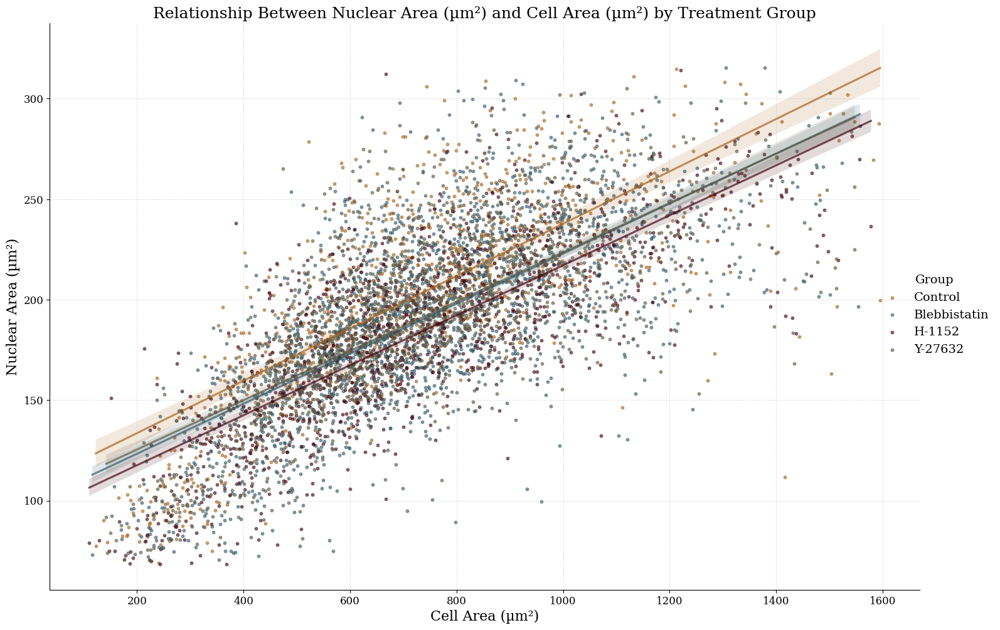

Ctl, : nuc_AreaShape_Area, : myo_AreaShape_Area: R-squared: 0.5337: p-value: 2.1494e-163
Ble, : nuc_AreaShape_Area, : myo_AreaShape_Area: R-squared: 0.4800: p-value: 8.6389e-306
H11, : nuc_AreaShape_Area, : myo_AreaShape_Area: R-squared: 0.5919: p-value: 3.2603e-243
Y27, : nuc_AreaShape_Area, : myo_AreaShape_Area: R-squared: 0.5075: p-value: 3.6929e-226
Comparison of R-squared values between Control and Ble for nuc_AreaShape_Area vs myo_AreaShape_Area: p-value: 6.1455e-02
Comparison of R-squared values between Control and H11 for nuc_AreaShape_Area vs myo_AreaShape_Area: p-value: 4.6645e-02
Comparison of R-squared values between Control and Y27 for nuc_AreaShape_Area vs myo_AreaShape_Area: p-value: 3.8404e-01


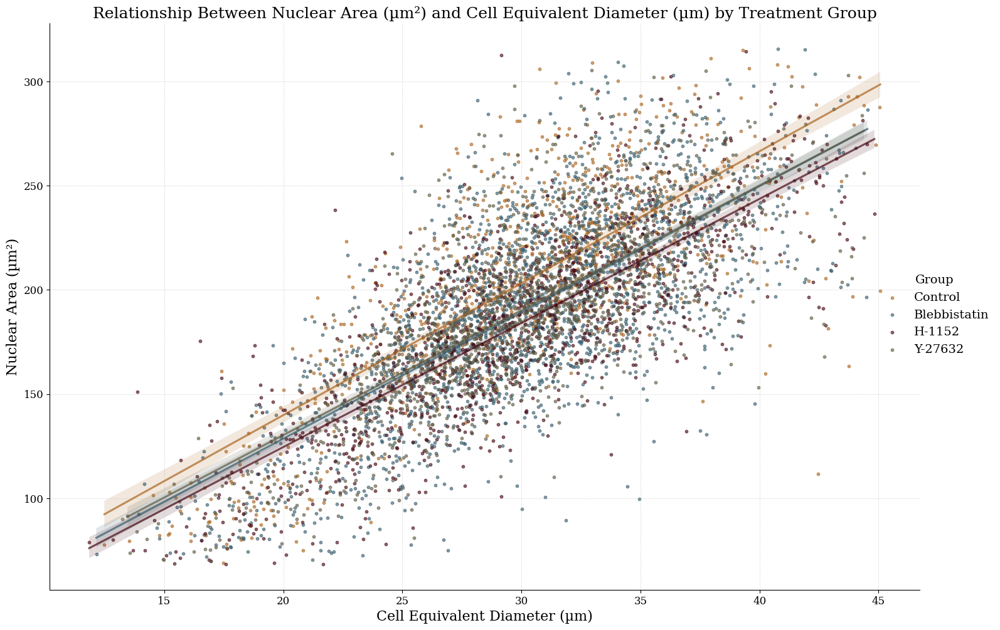

Ctl, : nuc_AreaShape_Area, : myo_AreaShape_EquivalentDiameter: R-squared: 0.5900: p-value: 1.4636e-190
Ble, : nuc_AreaShape_Area, : myo_AreaShape_EquivalentDiameter: R-squared: 0.5099: p-value: 0.0000e+00
H11, : nuc_AreaShape_Area, : myo_AreaShape_EquivalentDiameter: R-squared: 0.6167: p-value: 4.4357e-260
Y27, : nuc_AreaShape_Area, : myo_AreaShape_EquivalentDiameter: R-squared: 0.5455: p-value: 1.3367e-251
Comparison of R-squared values between Control and Ble for nuc_AreaShape_Area vs myo_AreaShape_EquivalentDiameter: p-value: 2.9563e-03
Comparison of R-squared values between Control and H11 for nuc_AreaShape_Area vs myo_AreaShape_EquivalentDiameter: p-value: 3.2574e-01
Comparison of R-squared values between Control and Y27 for nuc_AreaShape_Area vs myo_AreaShape_EquivalentDiameter: p-value: 1.1318e-01


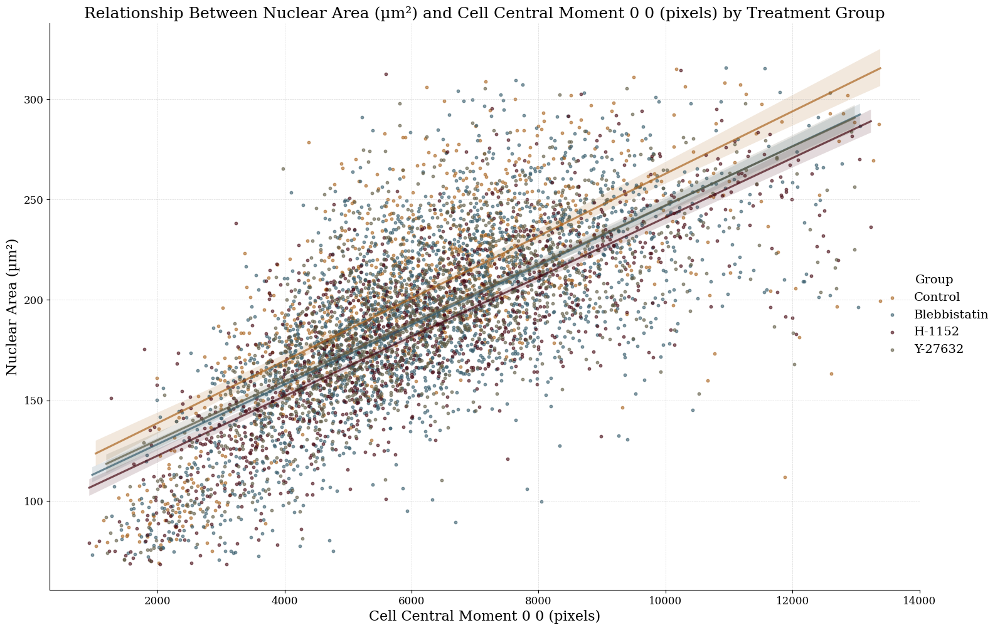

Ctl, : nuc_AreaShape_Area, : myo_AreaShape_CentralMoment_0_0: R-squared: 0.5337: p-value: 2.1494e-163
Ble, : nuc_AreaShape_Area, : myo_AreaShape_CentralMoment_0_0: R-squared: 0.4800: p-value: 8.6389e-306
H11, : nuc_AreaShape_Area, : myo_AreaShape_CentralMoment_0_0: R-squared: 0.5919: p-value: 3.2603e-243
Y27, : nuc_AreaShape_Area, : myo_AreaShape_CentralMoment_0_0: R-squared: 0.5075: p-value: 3.6929e-226
Comparison of R-squared values between Control and Ble for nuc_AreaShape_Area vs myo_AreaShape_CentralMoment_0_0: p-value: 6.1455e-02
Comparison of R-squared values between Control and H11 for nuc_AreaShape_Area vs myo_AreaShape_CentralMoment_0_0: p-value: 4.6645e-02
Comparison of R-squared values between Control and Y27 for nuc_AreaShape_Area vs myo_AreaShape_CentralMoment_0_0: p-value: 3.8404e-01


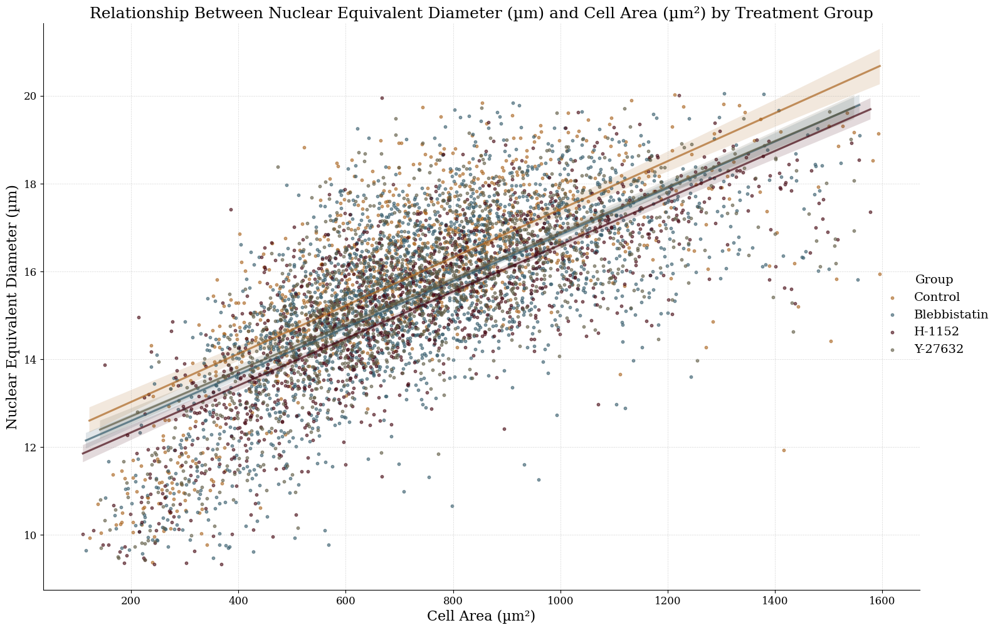

Ctl, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_Area: R-squared: 0.5347: p-value: 7.6584e-164
Ble, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_Area: R-squared: 0.4809: p-value: 1.5040e-306
H11, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_Area: R-squared: 0.5849: p-value: 1.2119e-238
Y27, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_Area: R-squared: 0.5121: p-value: 3.7821e-229
Comparison of R-squared values between Control and Ble for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_Area: p-value: 6.0469e-02
Comparison of R-squared values between Control and H11 for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_Area: p-value: 8.7687e-02
Comparison of R-squared values between Control and Y27 for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_Area: p-value: 4.5161e-01


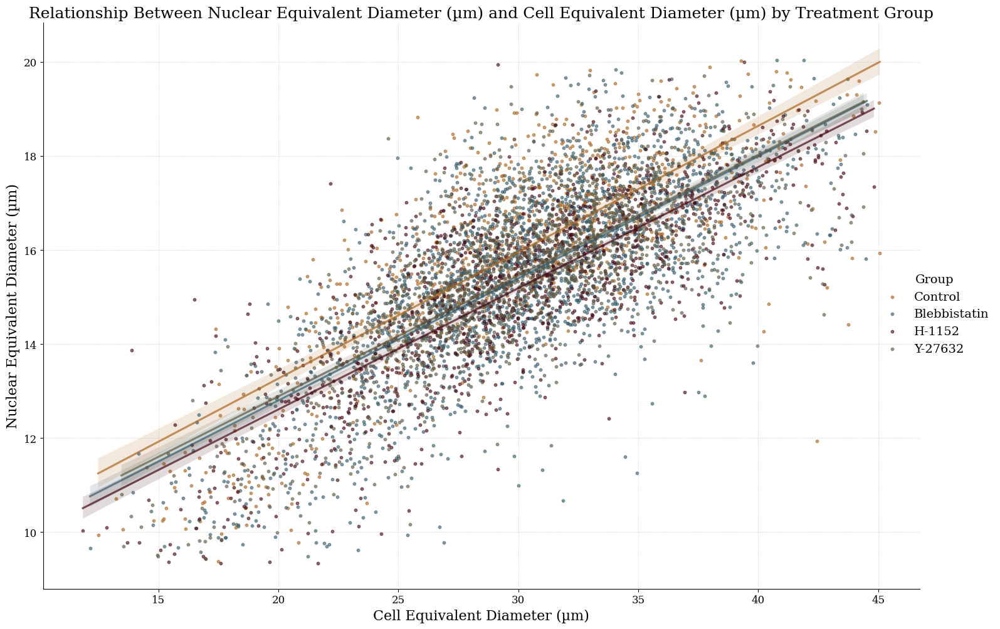

Ctl, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_EquivalentDiameter: R-squared: 0.6026: p-value: 3.6258e-197
Ble, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_EquivalentDiameter: R-squared: 0.5191: p-value: 0.0000e+00
H11, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_EquivalentDiameter: R-squared: 0.6206: p-value: 7.7788e-263
Y27, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_EquivalentDiameter: R-squared: 0.5600: p-value: 7.2054e-262
Comparison of R-squared values between Control and Ble for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_EquivalentDiameter: p-value: 1.6018e-03
Comparison of R-squared values between Control and H11 for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_EquivalentDiameter: p-value: 5.0046e-01
Comparison of R-squared values between Control and Y27 for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_EquivalentDiameter: p-value: 1.2068e-01


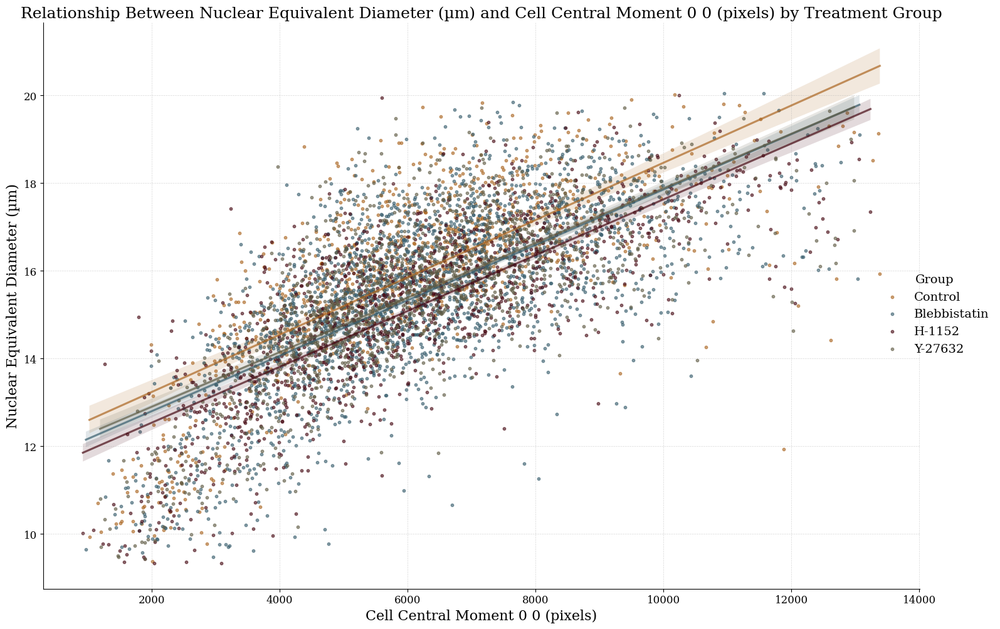

Ctl, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_CentralMoment_0_0: R-squared: 0.5347: p-value: 7.6584e-164
Ble, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_CentralMoment_0_0: R-squared: 0.4809: p-value: 1.5040e-306
H11, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_CentralMoment_0_0: R-squared: 0.5849: p-value: 1.2119e-238
Y27, : nuc_AreaShape_EquivalentDiameter, : myo_AreaShape_CentralMoment_0_0: R-squared: 0.5121: p-value: 3.7821e-229
Comparison of R-squared values between Control and Ble for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_CentralMoment_0_0: p-value: 6.0469e-02
Comparison of R-squared values between Control and H11 for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_CentralMoment_0_0: p-value: 8.7687e-02
Comparison of R-squared values between Control and Y27 for nuc_AreaShape_EquivalentDiameter vs myo_AreaShape_CentralMoment_0_0: p-value: 4.5161e-01


In [ ]:
# scatterplots of significant feature pairs

# color palette for each treatment group colorblind friendly
group_colors = {
    'Ctl': '#AB6621',  # Tiger's eye
    'Ble': '#375D6D',  # Payne's gray
    'H11': '#470A14',  # Chocolate cosmos
    'Y27': '#5F5B44',  # Ebony
}

# Mapping from original group names to display names
group_display_names = {
    'Ctl': 'Control',
    'Ble': 'Blebbistatin',
    'H11': 'H-1152',
    'Y27': 'Y-27632',
}

# Define the features to plot
nuc_features = {'nuc_AreaShape_Area': 'Nuclear Area (µm²)',
                 'nuc_AreaShape_EquivalentDiameter': 'Nuclear Equivalent Diameter (µm)'
}

myo_features = {'myo_AreaShape_Area': 'Cell Area (µm²)',
                 'myo_AreaShape_EquivalentDiameter': 'Cell Equivalent Diameter (µm)', 
                 'myo_AreaShape_CentralMoment_0_0': 'Cell Central Moment 0 0 (pixels)'
}

# Define the order of the groups
group_order = list(group_colors.keys())

# Set default font properties
plt.rcParams.update({
    'font.size': 14,  # Default font size
    'font.family': 'serif',  # Default font family
    'axes.titlesize': 18,  # Title font size
    'axes.labelsize': 16,  # X and Y label font size
    'legend.fontsize': 14,  # Legend font size
    'xtick.labelsize': 12,  # X tick label font size
    'ytick.labelsize': 12,  # Y tick label font size
})

# Define the directory to save the plots
os.makedirs(save_dir, exist_ok=True)

# Function to perform Fisher Z-transformation
def fisher_z(r):
    return np.arctanh(r)

# Function to calculate p-value for difference in R-squared values
def compare_r_squared(r1, n1, r2, n2):
    z1 = fisher_z(r1)
    z2 = fisher_z(r2)
    se_diff = np.sqrt(1/(n1-3) + 1/(n2-3))
    z_diff = (z1 - z2) / se_diff
    p_value = 2 * (1 - norm.cdf(np.abs(z_diff)))
    return p_value

# Create scatterplots for each feature pair with all groups
for nuc_feature, nuc_feature_name in nuc_features.items():
    for myo_feature, myo_feature_name in myo_features.items():
        plot = sns.lmplot(data=df_cleaned, x=myo_feature, y=nuc_feature, hue='group', palette=group_colors, hue_order=group_order, scatter_kws={'alpha':0.6, 's':10}, line_kws={'alpha':0.7}, aspect=1.5, height=10, legend=False)
        plt.xlabel(myo_feature_name)
        plt.ylabel(nuc_feature_name)
        plt.title(f'Relationship Between {nuc_feature_name} and {myo_feature_name} by Treatment Group')
        plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.5)
        
        # Update legend labels
        plot.add_legend(title='Group')
        for text in plot._legend.texts:
            text.set_text(group_display_names.get(text.get_text(), text.get_text()))
        
         # Save the plot
        plot_filename = f'Scat_{nuc_feature}_vs_{myo_feature}.png'
        plot_filepath = os.path.join(save_dir, plot_filename)
        plt.savefig(plot_filepath)
        plt.show()

        # Perform regression analysis for each group
        r_squared_values = {}
        sample_sizes = {}
        for group in group_order:
            group_data = df_cleaned[df_cleaned['group'] == group]
            X = sm.add_constant(group_data[myo_feature])
            y = group_data[nuc_feature]
            model = sm.OLS(y, X).fit()
            r_squared = model.rsquared
            p_value = model.f_pvalue
            r_squared_values[group] = r_squared
            sample_sizes[group] = len(group_data)
            print(f'{group}, : {nuc_feature}, : {myo_feature}: R-squared: {r_squared:.4f}: p-value: {p_value:.4e}')
        
        # Compare R-squared values of treatment groups with control group
        control_r_squared = r_squared_values['Ctl']
        control_sample_size = sample_sizes['Ctl']
        for group in group_order:
            if group != 'Ctl':
                tx_r_squared = r_squared_values[group]
                tx_sample_size = sample_sizes[group]
                p_val_diff = compare_r_squared(control_r_squared, control_sample_size, tx_r_squared, tx_sample_size)
                print(f'Comparison of R-squared values between Control and {group} for {nuc_feature} vs {myo_feature}: p-value: {p_val_diff:.4e}')

## Scatter plots of nuc mean radius by cell mean radius - 1 plot per group

Min Nuc Mean Radius (microns): 1.2296930964126913
Max Nuc Mean Radius (microns): 3.329236919090792
Mean Nuc Mean Radius (microns): 2.5008754381316454
Min cell Mean Radius (microns): 1.360567929307263
Max cell Mean Radius (microns): 6.582234394036688
Mean cell Mean Radius (microns): 4.02482624815698
Min Nuc Mean Radius: 1.2296930964126913 microns
Min Nuc Mean Radius: 3.329236919090792 microns
Min Cell Mean Radius: 1.360567929307263 microns
Min Cell Mean Radius: 6.582234394036688 microns
Min Nuc Mean Radius: File Name: Ble_repA_014.czi_MAX_C2.tiff, Image Number: 14, Object Number: 25
Max Nuc Mean Radius: File Name: Ble_repA_041.czi_MAX_C2.tiff, Image Number: 41, Object Number: 50
Min Cell Mean Radius: File Name: Ble_repA_014.czi_MAX_C2.tiff, Image Number: 14, Object Number: 33
Max Cell Mean Radius: File Name: Ctl_repA_001.czi_MAX_C2.tiff, Image Number: 55, Object Number: 12


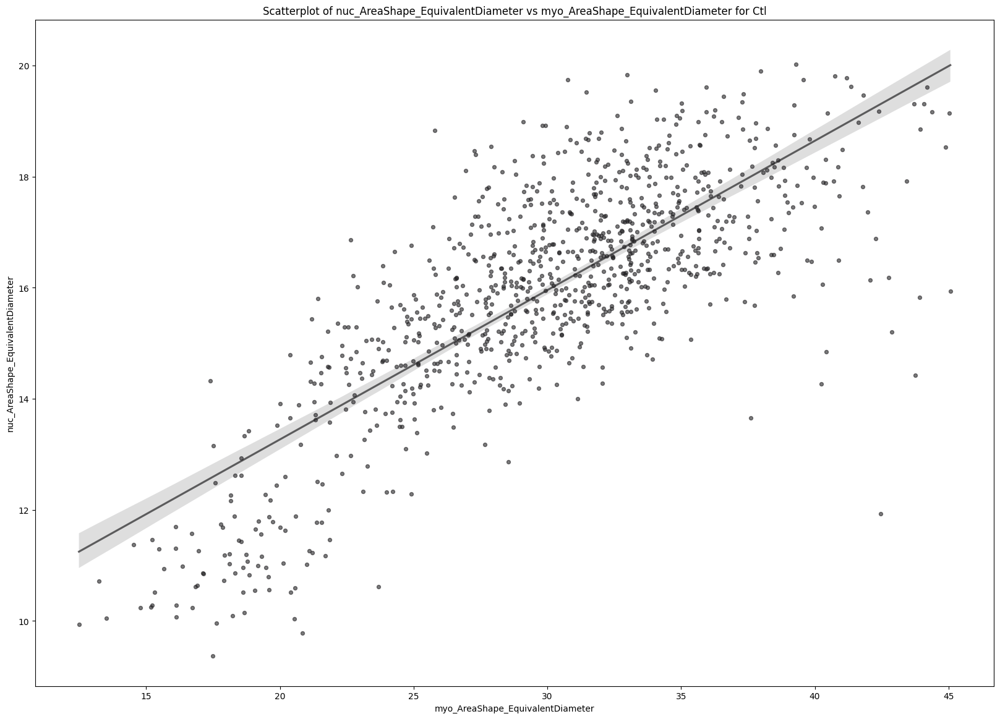

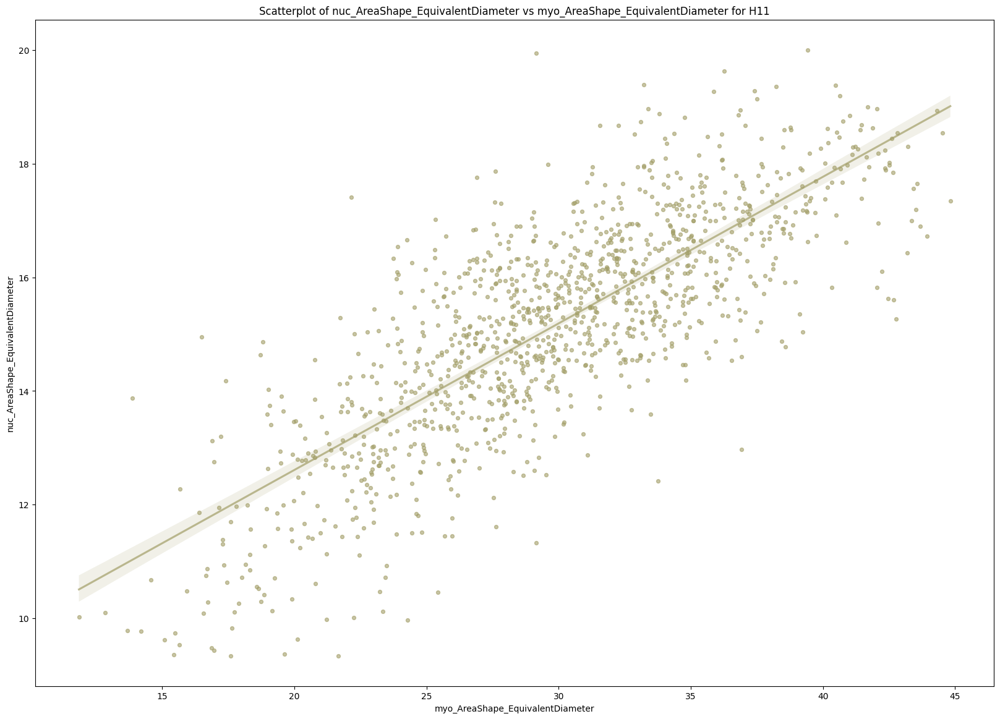

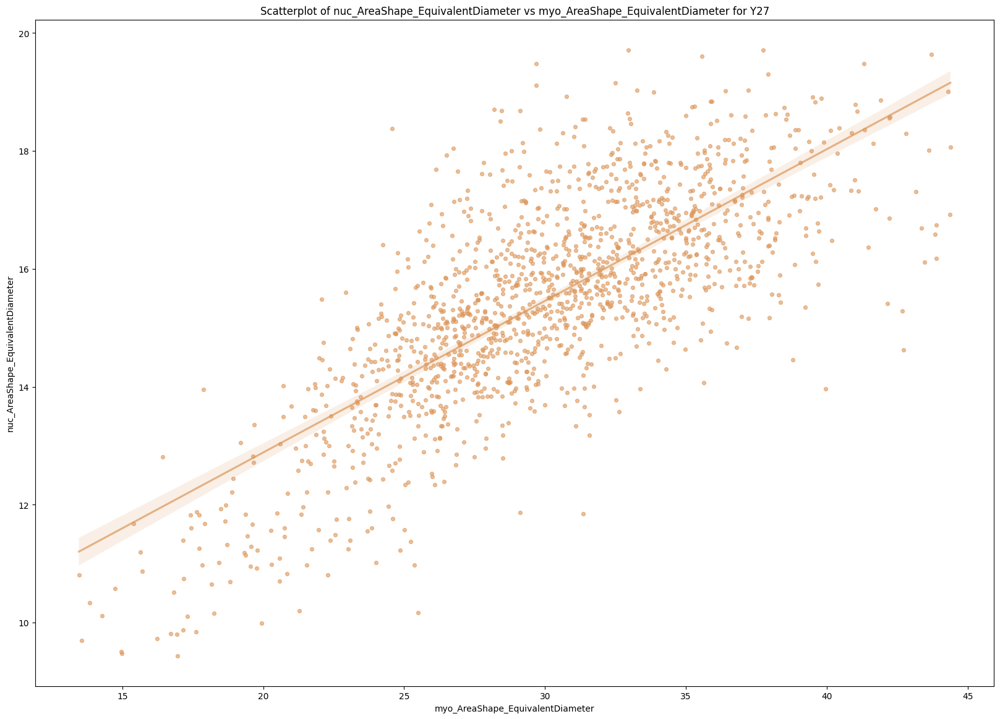

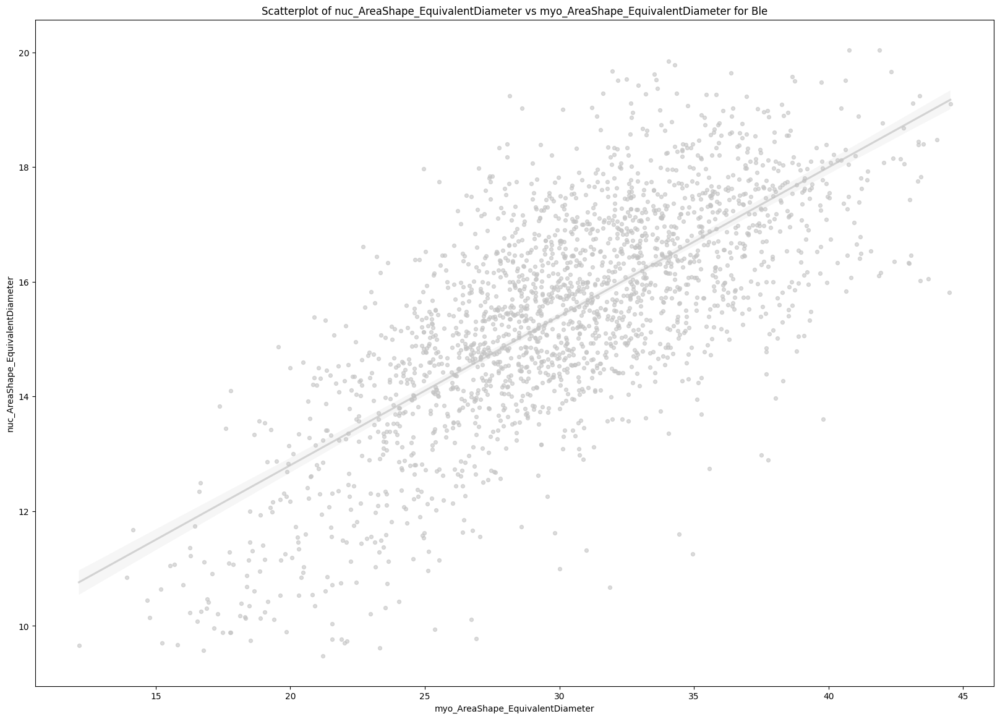

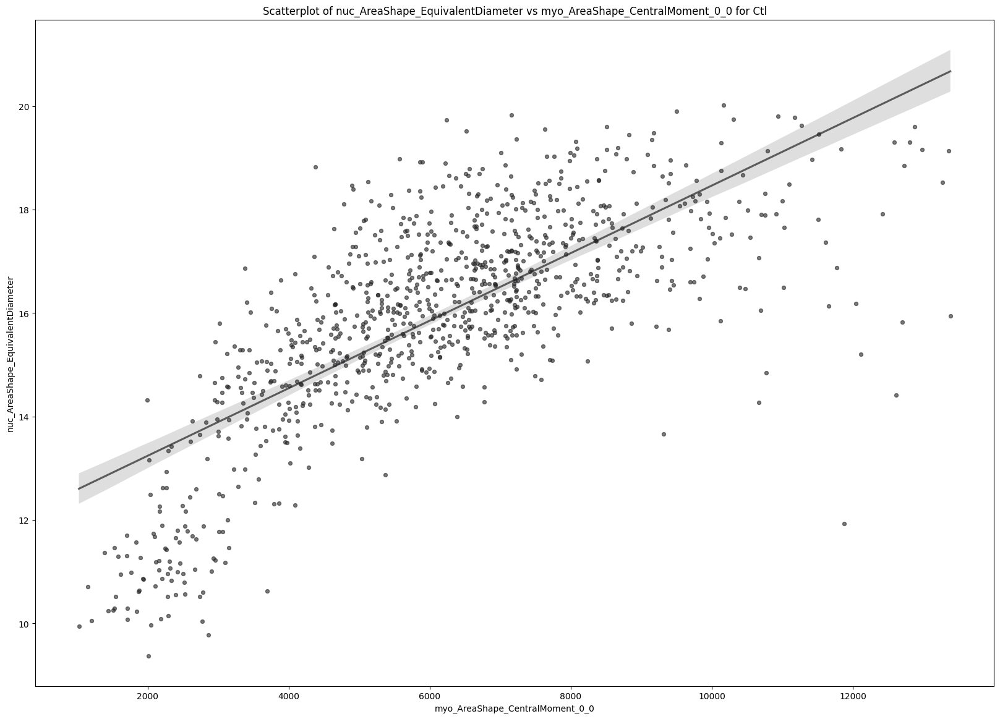

...

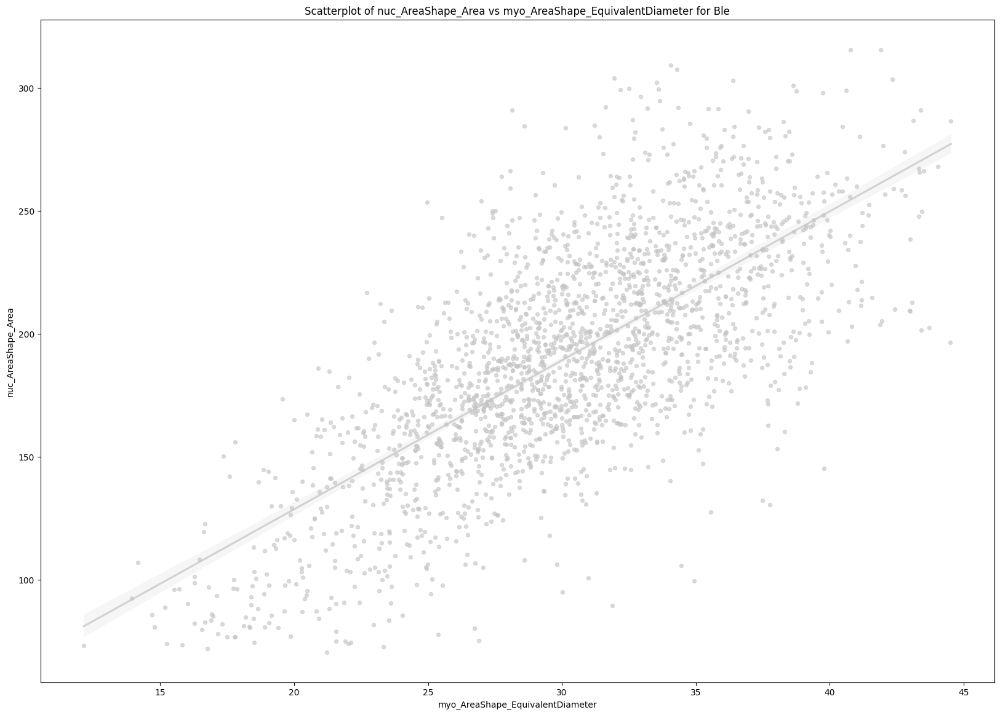

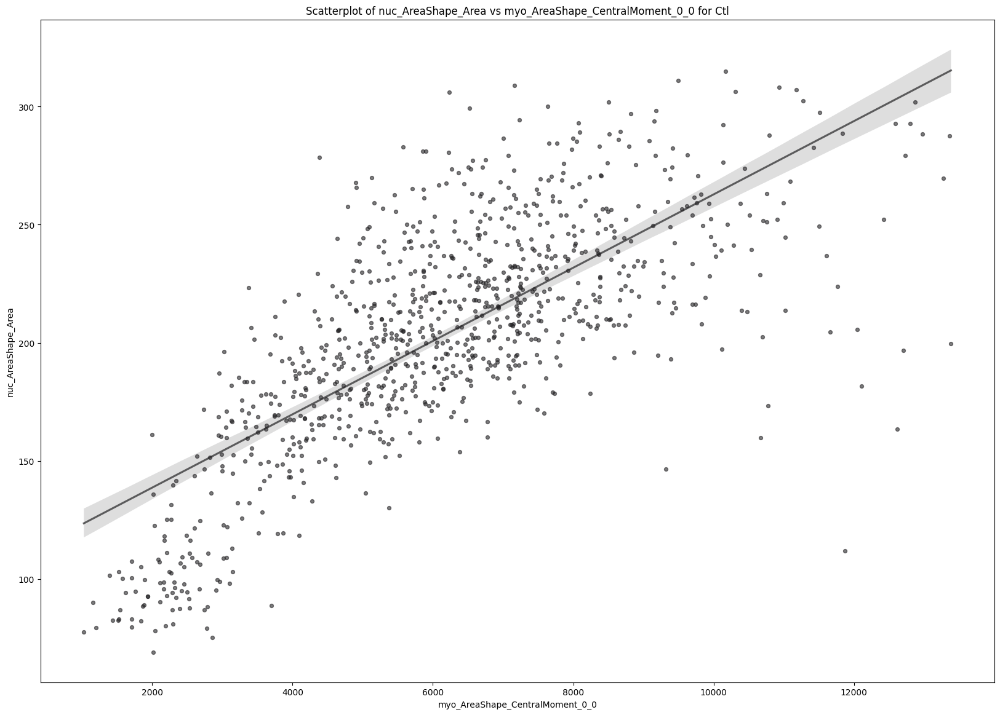

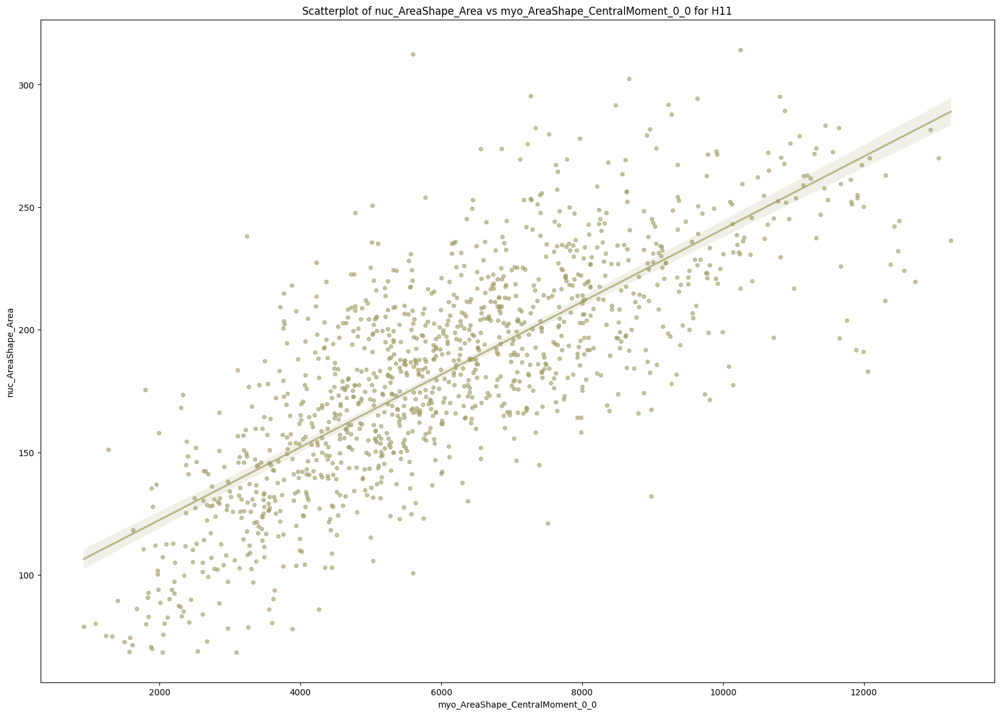

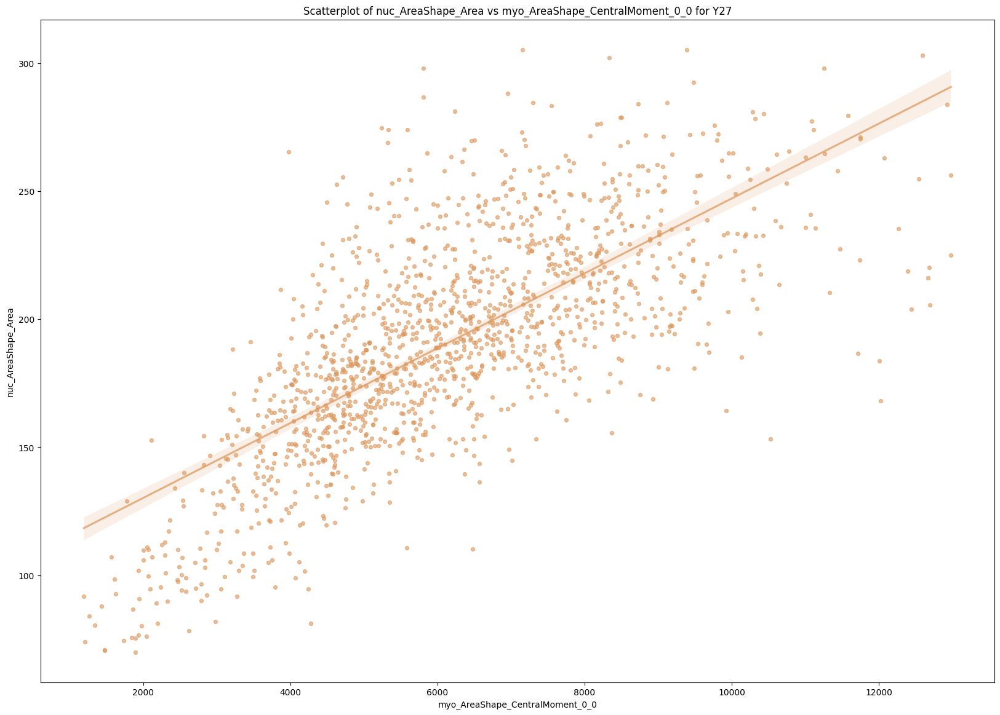

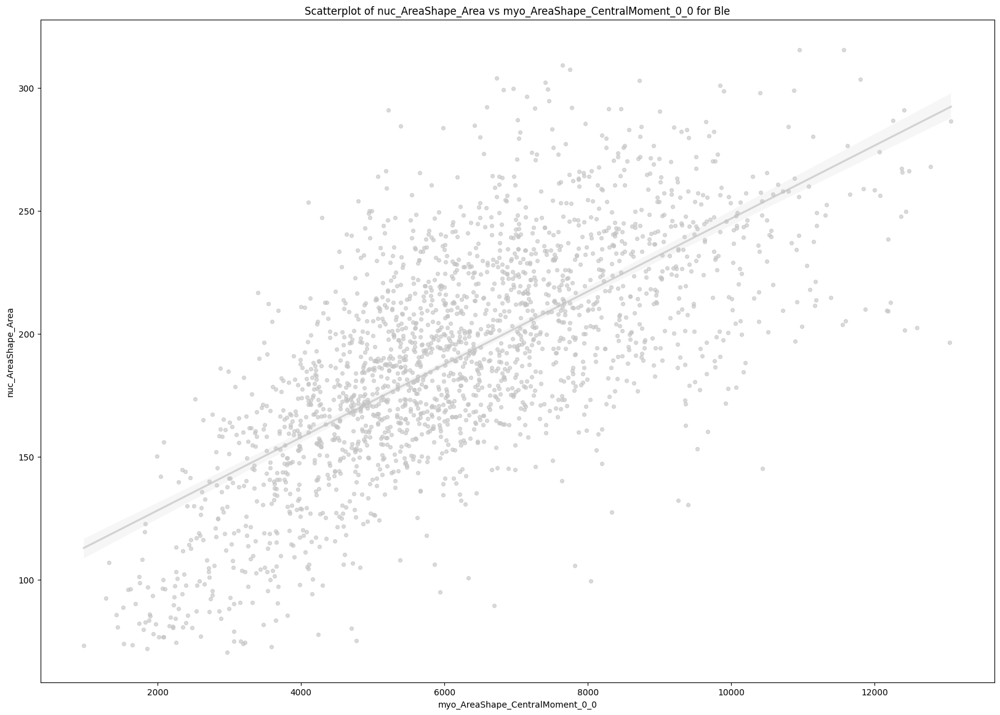

In [ ]:
# scatter plots of selected features

# Define the group colors
group_colors = {
    'Ctl': '#242325',  # Raisin Black
    'H11': '#A29E67',  # Moss Green
    'Y27': '#DC965A',  # Persian Orange
    'Ble': '#C3C3C3',  # Silver
}

# Define the features to plot
nuc_features = ['nuc_AreaShape_EquivalentDiameter', 'nuc_AreaShape_Area']
myo_features = ['myo_AreaShape_EquivalentDiameter', 'myo_AreaShape_CentralMoment_0_0']

# Define the order of the groups
group_order = list(group_colors.keys())

# Define the directory to save the plots
save_dir = "/Users/rosi_dakd/My Drive/Prasad_Lab/nuclear_shape/Data/20240815_HeLa_TMI_40X_output/2D_CellProfiler_output/Figures/"
os.makedirs(save_dir, exist_ok=True)

nuc_meanradius_min = df_cleaned['nuc_AreaShape_MeanRadius'].min()
nuc_meanradius_max = df_cleaned['nuc_AreaShape_MeanRadius'].max()
nuc_meanradius_mean = df_cleaned['nuc_AreaShape_MeanRadius'].mean()
cell_meanradius_min = df_cleaned['myo_AreaShape_MeanRadius'].min()
cell_meanradius_max = df_cleaned['myo_AreaShape_MeanRadius'].max()
cell_meanradius_mean = df_cleaned['myo_AreaShape_MeanRadius'].mean()

print(f"Min Nuc Mean Radius (microns): {nuc_meanradius_min}")
print(f"Max Nuc Mean Radius (microns): {nuc_meanradius_max}")
print(f"Mean Nuc Mean Radius (microns): {nuc_meanradius_mean}")
print(f"Min cell Mean Radius (microns): {cell_meanradius_min}")
print(f"Max cell Mean Radius (microns): {cell_meanradius_max}")
print(f"Mean cell Mean Radius (microns): {cell_meanradius_mean}")

# print the file name, image number and object number of the row with the maximum and minimum Mean Radius for the nucleus
min_nuc_meanradius_row = df_cleaned[df_cleaned['nuc_AreaShape_MeanRadius'] == nuc_meanradius_min]
max_nuc_meanradius_row = df_cleaned[df_cleaned['nuc_AreaShape_MeanRadius'] == nuc_meanradius_max]
min_cell_meanradius_row = df_cleaned[df_cleaned['myo_AreaShape_MeanRadius'] == cell_meanradius_min]
max_cell_meanradius_row = df_cleaned[df_cleaned['myo_AreaShape_MeanRadius'] == cell_meanradius_max]

print(f"Min Nuc Mean Radius: {nuc_meanradius_min} microns")
print(f"Min Nuc Mean Radius: {nuc_meanradius_max} microns")
print(f"Min Cell Mean Radius: {cell_meanradius_min} microns")
print(f"Min Cell Mean Radius: {cell_meanradius_max} microns")

print(f"Min Nuc Mean Radius: File Name: {min_nuc_meanradius_row['FileName_Act'].values[0]}, Image Number: {min_nuc_meanradius_row['ImageNumber'].values[0]}, Object Number: {min_nuc_meanradius_row['ObjectNumber'].values[0]}")
print(f"Max Nuc Mean Radius: File Name: {max_nuc_meanradius_row['FileName_Act'].values[0]}, Image Number: {max_nuc_meanradius_row['ImageNumber'].values[0]}, Object Number: {max_nuc_meanradius_row['ObjectNumber'].values[0]}")
print(f"Min Cell Mean Radius: File Name: {min_cell_meanradius_row['FileName_Act'].values[0]}, Image Number: {min_cell_meanradius_row['ImageNumber'].values[0]}, Object Number: {min_cell_meanradius_row['ObjectNumber'].values[0]}")
print(f"Max Cell Mean Radius: File Name: {max_cell_meanradius_row['FileName_Act'].values[0]}, Image Number: {max_cell_meanradius_row['ImageNumber'].values[0]}, Object Number: {max_cell_meanradius_row['ObjectNumber'].values[0]}")

# Create scatterplots for each feature pair with each group separately
for nuc_feature in nuc_features:
    for myo_feature in myo_features:
        for group in group_order:
            group_data = df_cleaned[df_cleaned['group'] == group]
            plt.figure(figsize=(20, 14))
            sns.regplot(
                data=group_data, 
                x=myo_feature, 
                y=nuc_feature, 
                scatter_kws={'alpha': 0.6, 's': 18, 'color': group_colors[group]}, 
                line_kws={'alpha': 0.7, 'color': group_colors[group]}
            )
            plt.xlabel(myo_feature)
            plt.ylabel(nuc_feature)
            plt.title(f'Scatterplot of {nuc_feature} vs {myo_feature} for {group}')
            plt.grid(False)
            
            # Save the plot
            plot_filename = f'Scat_{nuc_feature}_vs_{myo_feature}_{group}.svg'
            plot_filepath = os.path.join(save_dir, plot_filename)
            plt.savefig(plot_filepath, dpi=300)
            plt.show()


# Mulitple Linear Regression - w/polynomials

In [35]:
# miltiple linear regression analysis to predict nuclear features from cell features
# output is Mean Squared Error and R² Score: MSE measures the average squared difference between the predicted values and the actual values, while R² Score measures the proportion of the variance in the dependent variable that is predictable from the independent variables.
# low MSE and high R² Score indicate a good model fit

# function to calculate F-ratio for each nuclear feature
def calculate_f_ratio(model, X, y):
    # Number of observations and predictors
    n = X.shape[0]
    p = X.shape[1]

    # Mean Squared Error of the model
    mse_model = mean_squared_error(y, model.predict(X))

    # Total Sum of Squares (TSS)
    tss = np.sum((y - np.mean(y)) ** 2)

    # Residual Sum of Squares (RSS)
    rss = np.sum((y - model.predict(X)) ** 2)

    # Mean Squared Error of the residuals
    mse_residual = rss / (n - p - 1)

    # F-Ratio
    f_ratio = (tss - rss) / p / mse_residual
    
    # Calculate p-value
    df1 = p  # degrees of freedom for the numerator
    df2 = n - p - 1  # degrees of freedom for the denominator
    p_value = 1 - f.cdf(f_ratio, df1, df2)

    return f_ratio, p_value

# Extract nuc and myo features 
nuc_features = df_cleaned.filter(like='nuc_')
myo_features = df_cleaned.filter(like='myo_')

# exclude features that are irrelevant using regex
myo_features_exclued = myo_features.filter(regex='Moment_')
nuc_features_exclued = nuc_features.filter(regex='Moment_')

# drop the excluded features
myo_features = myo_features.drop(columns=myo_features_exclued.columns)
nuc_features = nuc_features.drop(columns=nuc_features_exclued.columns)

# Normalize the myo features
scaler = StandardScaler()
myo_features_normalized = scaler.fit_transform(myo_features)

# Add normalized myo features back to the dataframe
df_features_normalized = df_cleaned.copy()
df_features_normalized[myo_features.columns] = myo_features_normalized

# Extract unique treatment groups
groups = df_cleaned['group'].unique()

# list of results (list for easy DF creation)
mlr_results_all = []

# Initialize PolynomialFeatures with the desired degree, this incorpprates non-linear relationships
poly = PolynomialFeatures(degree=2, include_bias=False)

# Define the range of alpha values to test
alpha_range = np.logspace(-3, 3, 7)  # 0.001, 0.01, 0.1, 1, 10, 100, 1000

for group in groups:
    # filter
    df_group = df_features_normalized[df_features_normalized['group'] == group]

    # Iterate over each nuc feature
    for nuc_feature in nuc_features.columns:
        # Define the target variable as the current nuc feature
        y = df_group[nuc_feature]
        
         # Combine normalized myo features into a single dataframe
        X = df_group[myo_features.columns]

         # Create polynomial features
        X_poly = poly.fit_transform(X)
        
        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=42)
        
        # Initialize the linear regression model
        model = Ridge()
        param_grid = {'alpha': alpha_range}
        grid_search = GridSearchCV(model, param_grid, cv=5, scoring='neg_mean_squared_error') # may need to use gen_mean_squared_error
        grid_search.fit(X_train, y_train)
        best_alpha = grid_search.best_params_['alpha']

        # intialize the model with the best alpha
        model = Ridge(alpha=best_alpha)
        cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2')
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        mse_value = mean_squared_error(y_test, y_pred)
        rmse_value = np.sqrt(mse_value)
        rmse_percentage = (rmse_value / np.mean(y_test)) * 100
        rmse_percentage_std = (rmse_value / np.std(y_test)) * 100
        mlr_r2 = r2_score(y_test, y_pred)
        f_ratio, p_value = calculate_f_ratio(model, X_train, y_train)
        coefficients = pd.Series(model.coef_, index=poly.get_feature_names_out(input_features=myo_features.columns))
        top_features = coefficients.abs().sort_values(ascending=False).head(10).index.tolist()

        # calculate feature contributions
        feature_contributions = coefficients[top_features].to_dict()

         # Append the results to the list
        mlr_results_all.append({
            'Group': group,
            'Feature': nuc_feature,
            'Mean Squared Error': mean_squared_error(y_test, y_pred),
            'R²': mlr_r2,
            'RMSE%': rmse_percentage,
            'RMSE%ₛₜd': rmse_percentage_std,
            'Cross-Val R² Scores': cv_scores.mean(),
            'F-ratio': f_ratio,
            'p-value': p_value,
            'Top Predictive Features': top_features,
            'Feature Contributions': feature_contributions,
            'Best Alpha': best_alpha
        })
    
# get path for original data 
original_file_path = os.path.dirname(file_path)

# Create a DataFrame from the results list
mlr_results_df = pd.DataFrame(mlr_results_all)

# Sort the DataFrame by Group and R² Score
mlr_results_df = mlr_results_df.sort_values(by=['Feature', 'R²'], ascending=[True, False])

# create file path for output and save the results
output_path = os.path.join(original_file_path, 'MLR_results.csv')
mlr_results_df.to_csv(output_path, index=False)

# Print the DataFrame
print(mlr_results_df)

# print how many myo features are used in the model
myo_feature_count = myo_features.shape[1]
print(f"Number of myo features used in the model: {myo_feature_count}")
# print("Best alpha", best_alpha)


   Group                    Feature  Mean Squared Error        R²      RMSE%  \
32   Ctl         nuc_AreaShape_Area          788.265496  0.670668  14.084987   
50   H11         nuc_AreaShape_Area          665.111960  0.621882  14.171090   
68   Y27         nuc_AreaShape_Area          728.499942  0.621179  14.176925   
14   Ble         nuc_AreaShape_Area          967.360374  0.528373  16.427591   
16   Ble  nuc_AreaShape_AspectRatio            0.010233  0.108890  13.808732   
..   ...                        ...                 ...       ...        ...   
1    Ble    nuc_AreaShape_Perimeter           21.778702  0.473836   8.945921   
31   Ctl     nuc_AreaShape_Solidity            0.000205  0.206383   1.475829   
67   Y27     nuc_AreaShape_Solidity            0.000468  0.122428   2.234209   
49   H11     nuc_AreaShape_Solidity            0.000271  0.067471   1.698425   
13   Ble     nuc_AreaShape_Solidity            0.000382  0.020750   2.016811   

     RMSE%ₛₜd  Cross-Val R² Scores    F

In [36]:
# Extract nuc and myo features 
nuc_features = df_cleaned.filter(like='nuc_')
myo_features = df_cleaned.filter(like='myo_')

# exclude features that are irrelevant using regex
myo_features_exclued = myo_features.filter(regex='Moment_')

# drop the excluded features
myo_features = myo_features.drop(columns=myo_features_exclued.columns)

myo_features.columns

Index(['myo_AreaShape_Area', 'myo_AreaShape_MaxFeretDiameter',
       'myo_AreaShape_MinFeretDiameter', 'myo_AreaShape_MaximumRadius',
       'myo_AreaShape_MinorAxisLength', 'myo_AreaShape_MeanRadius',
       'myo_AreaShape_EquivalentDiameter', 'myo_AreaShape_Compactness',
       'myo_AreaShape_MajorAxisLength', 'myo_AreaShape_MedianRadius',
       'myo_AreaShape_Perimeter', 'myo_AreaShape_Solidity',
       'myo_AreaShape_Extent', 'myo_AreaShape_Eccentricity',
       'myo_AreaShape_ConvexArea', 'myo_AreaShape_Orientation',
       'myo_AreaShape_AspectRatio', 'myo_AreaShape_Circularity'],
      dtype='object')

## Bar Plot MLR results by group

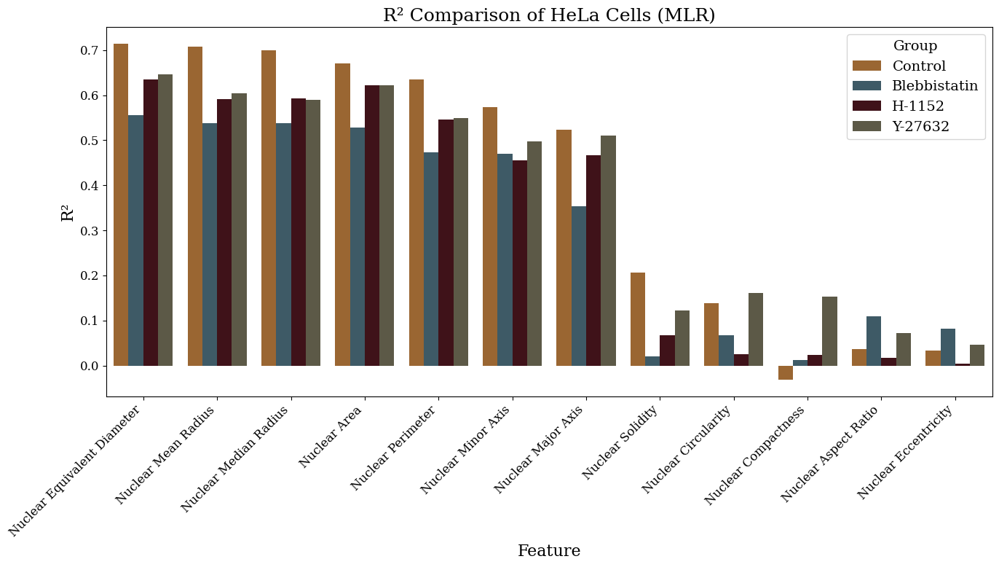

In [37]:
# plot MLR results for each group

# Dictionary to map original column names to new names
column_name_mapping = {
    'nuc_AreaShape_Area': 'Nuclear Area',
    'nuc_AreaShape_Perimeter': 'Nuclear Perimeter',
    'nuc_AreaShape_MajorAxisLength': 'Nuclear Major Axis',
    'nuc_AreaShape_MinorAxisLength': 'Nuclear Minor Axis',
    'nuc_AreaShape_AspectRatio': 'Nuclear Aspect Ratio',
    'nuc_AreaShape_Circularity': 'Nuclear Circularity',
    'nuc_AreaShape_Eccentricity': 'Nuclear Eccentricity',
    'nuc_AreaShape_Solidity': 'Nuclear Solidity',
    'nuc_AreaShape_Compactness': 'Nuclear Compactness',
    'nuc_AreaShape_MeanRadius': 'Nuclear Mean Radius',
    'nuc_AreaShape_EquivalentDiameter': 'Nuclear Equivalent Diameter',
    'nuc_AreaShape_MeanRadius': 'Nuclear Mean Radius',
    'nuc_AreaShape_MedianRadius': 'Nuclear Median Radius',
    'myo_AreaShape_Area': 'Cell Area',
    'myo_AreaShape_Perimeter': 'Cell Perimeter',
    'myo_AreaShape_MajorAxisLength': 'Cell Major Axis',
    'myo_AreaShape_MinorAxisLength': 'Cell Minor Axis',
    'myo_AreaShape_AspectRatio': 'Cell Aspect Ratio',
    'myo_AreaShape_Circularity': 'Cell Circularity',
    'myo_AreaShape_Eccentricity': 'Cell Eccentricity',
    'myo_AreaShape_Solidity': 'Cell Solidity',
    'myo_AreaShape_Compactness': 'Cell Compactness',
}

# Define the color palette for each treatment group (colorblind-friendly)
group_colors = {
    'Ctl': '#AB6621',  # Tiger's eye
    'Ble': '#375D6D',  # Payne's gray
    'H11': '#470A14',  # Chocolate cosmos
    'Y27': '#5F5B44',  # Ebony
}
# Mapping from original group names to display names
group_display_names = {
    'Ctl': 'Control',
    'Ble': 'Blebbistatin',
    'H11': 'H-1152',
    'Y27': 'Y-27632',
}
# Define the order of the groups
group_order = list(group_colors.keys())

# Set default font properties
plt.rcParams.update({
    'font.size': 14,  # Default font size
    'font.family': 'serif',  # Default font family
    'axes.titlesize': 18,  # Title font size
    'axes.labelsize': 16,  # X and Y label font size
    'legend.fontsize': 14,  # Legend font size
    'xtick.labelsize': 12,  # X tick label font size
    'ytick.labelsize': 12,  # Y tick label font size
})

# Sort the DataFrame by 'R² Score' in descending order
mlr_sorted_results_df = mlr_results_df.sort_values(by='R²', ascending=False)

# Melt the DataFrame to long format for seaborn
mlr_melted_df = mlr_sorted_results_df.melt(id_vars=['Group', 'Feature'], value_vars=['R²'], var_name='Metric', value_name='Value')

# Map the original column names to the new names
mlr_melted_df['Feature'] = mlr_melted_df['Feature'].map(column_name_mapping)

# Define the directory to save the plots
os.makedirs(save_dir, exist_ok=True)

# Create the plot
plt.figure(figsize=(14, 8))
sns.barplot(data=mlr_melted_df, x='Feature', y='Value', hue='Group', hue_order=group_order, palette=group_colors)
plt.title('R² Comparison of HeLa Cells (MLR)')
plt.xlabel('Feature')
plt.ylabel('R²')
plt.xticks(rotation=45, ha='right')
legend = plt.legend(title='Group')
for text, original_name in zip(legend.texts, group_order):
    text.set_text(group_display_names[original_name])  # Replace with display name

plt.tight_layout()

# Save the figure
filename = "Bar_MLR_comparison.png"
plt.savefig(os.path.join(save_dir, filename), dpi=300)

# Show the plot
plt.show()

## Plot mean R² accross features

        Mean R²  Mean F-ratio  Mean Cross-Val R²
Group                                           
Ble    0.324218      6.767848           0.359487
Ctl    0.417527      3.755259           0.377634
H11    0.342128      4.661554           0.374841
Y27    0.380165      4.783069           0.360674


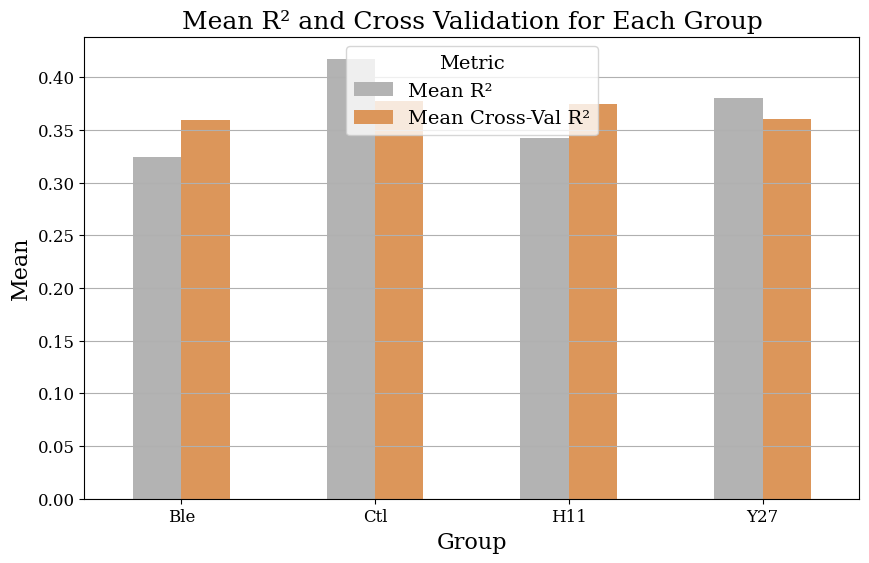

In [ ]:
# Generalizations accross all features
# Calculate the mean R² scores for each group
mean_r2_scores = mlr_results_df.groupby('Group')['R²'].mean()

# Calculate the mean F-ratio for each group
mean_f_ratios = mlr_results_df.groupby('Group')['F-ratio'].mean()

# Calculate mean cross-validated R² scores for each group
mean_cv_scores = mlr_results_df.groupby('Group')['Cross-Val R² Scores'].mean()

# Create a DataFrame from the mean scores
mlr_mean_scores_df = pd.concat([mean_r2_scores, mean_f_ratios, mean_cv_scores], axis=1)

# Rename the columns
mlr_mean_scores_df.columns = ['Mean R²', 'Mean F-ratio', 'Mean Cross-Val R²']

# Save the mean scores to a CSV file
output_path = os.path.join(original_file_path, 'MLR_mean_scores_bygroup.csv')
mlr_mean_scores_df.to_csv(output_path)

# Print the mean scores
print(mlr_mean_scores_df)

# Plot the mean R² scores and mean cross validation R² for each group
plt.figure(figsize=(10, 6))

# Create the bar plot
mlr_mean_scores_df[['Mean R²', 'Mean Cross-Val R²']].plot(kind='bar', ax=plt.gca(), color=['#B3B3B3', '#DC965A'])

# Add labels and title
plt.title('Mean R² and Cross Validation for Each Group')
plt.ylabel('Mean')
plt.xlabel('Group')
plt.xticks(rotation=0)
plt.legend(title='Metric', loc='upper center')
plt.grid(axis='y')

# Save the figure
filename = "Bar_MLR_means.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()


## violin plots of R² by group

/var/folders/vg/qyk8wk2n33389vbkssssdjz40000gp/T/ipykernel_17039/3388553499.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(data=mlr_results_df, x='Group', y='R²', palette=group_colors)


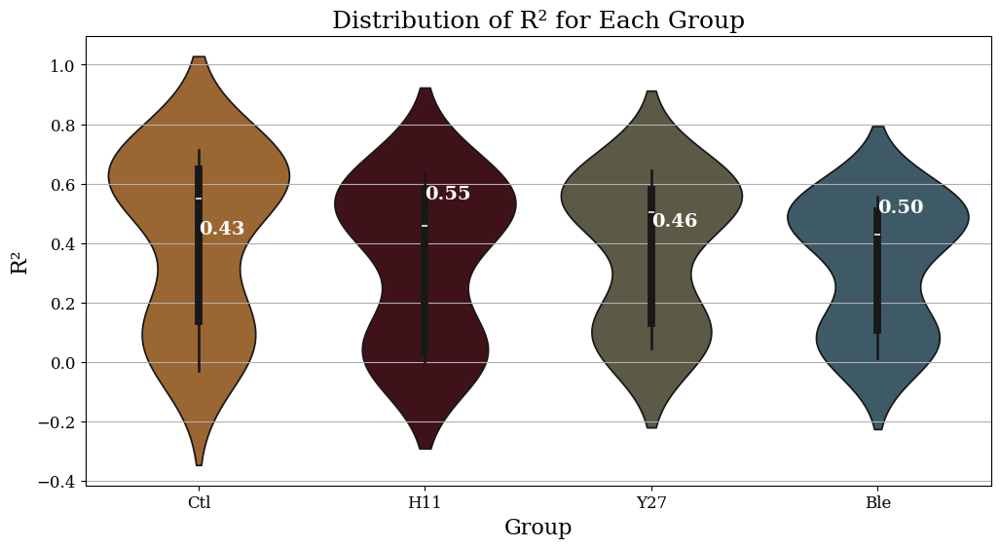

In [ ]:
# violin plots of R² values for each group

medians = mlr_results_df.groupby('Group')['R²'].median()

# Create a violin plot of R² values for each group
plt.figure(figsize=(12, 6))
ax = sns.violinplot(data=mlr_results_df, x='Group', y='R²', palette=group_colors)

# Annotate the plot with median values
for i, group in enumerate(medians.index):
    median_value = medians[group]
    ax.text(i, median_value, f'{median_value:.2f}', horizontalalignment='left', size='medium', color='white', weight='semibold')

plt.title('Distribution of R² for Each Group')
plt.ylabel('R²')
plt.xlabel('Group')
plt.grid(axis='y')

# Save the figure
filename = "Violin_MLR_distribution.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()

## Plot Mean R² and F-ratios by feature

                                   Mean R²  Mean F-ratio
Feature                                                 
nuc_AreaShape_EquivalentDiameter  0.637306      9.786061
nuc_AreaShape_MedianRadius        0.604930      9.554607
nuc_AreaShape_MeanRadius          0.609972      9.215441
nuc_AreaShape_Area                0.610525      8.756451
nuc_AreaShape_ConvexArea          0.595788      8.190150
nuc_AreaShape_Perimeter           0.550665      7.069740
nuc_AreaShape_MaximumRadius       0.527241      6.557343
nuc_AreaShape_MinorAxisLength     0.499193      5.708940
nuc_AreaShape_MaxFeretDiameter    0.491215      5.589606
nuc_AreaShape_MinFeretDiameter    0.477242      5.221811
nuc_AreaShape_MajorAxisLength     0.463466      5.027228
nuc_AreaShape_Solidity            0.104258      2.194413
nuc_AreaShape_Compactness         0.039190      2.094580
nuc_AreaShape_Circularity         0.098162      1.843289
nuc_AreaShape_Orientation         0.118990      1.017849
nuc_AreaShape_Extent           

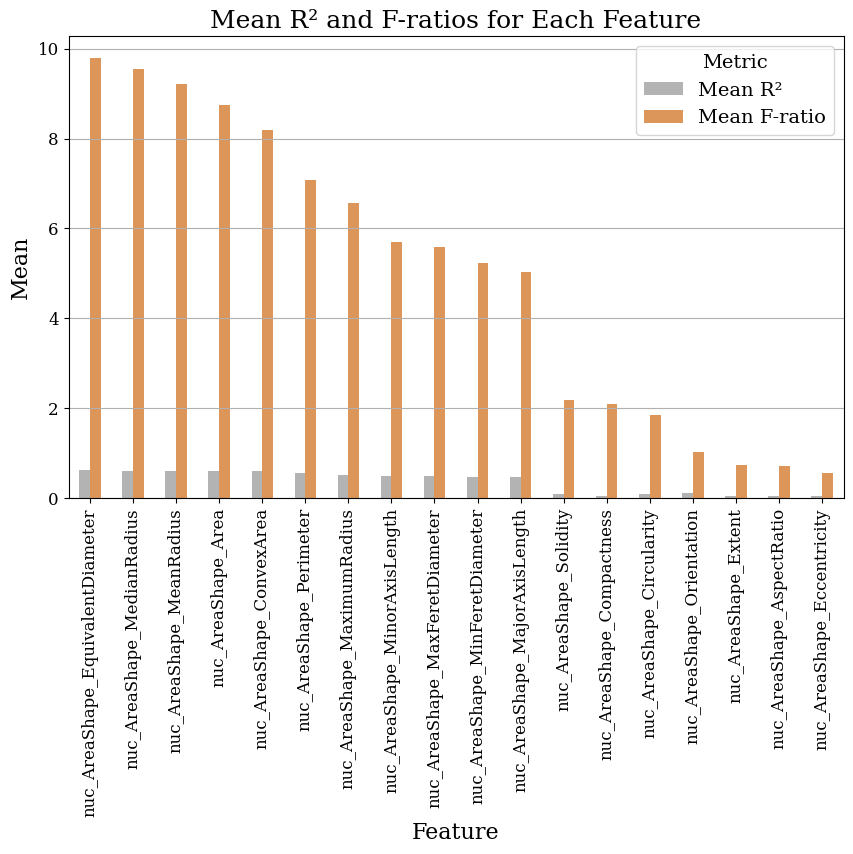

In [ ]:
# calculate mean R² scores and F-ratios for each feature accross all groups: f-ratio describes the ratio of the variance explained by the model to the variance not explained by the model

# Calculate the mean R² scores for each feature
mean_r2_scores_feature = mlr_results_df.groupby('Feature')['R²'].mean()

# Calculate the mean F-ratio for each feature
mean_f_ratios_feature = mlr_results_df.groupby('Feature')['F-ratio'].mean()

# Create a DataFrame from the mean scores
mlr_mean_scores_feature_df = pd.concat([mean_r2_scores_feature, mean_f_ratios_feature], axis=1)

# Rename the columns
mlr_mean_scores_feature_df.columns = ['Mean R²', 'Mean F-ratio']

# Save the mean scores to a CSV file
output_path = os.path.join(original_file_path, 'MLR_mean_scores_byfeature.csv')

# sort by F-ratio
mlr_mean_scores_feature_df = mlr_mean_scores_feature_df.sort_values(by='Mean F-ratio', ascending=False)

# Print the mean scores
print(mlr_mean_scores_feature_df)

# Plot the mean R² scores and mean F-ratios for each feature
plt.figure(figsize=(10, 6))

# Create the bar plot
mlr_mean_scores_feature_df.plot(kind='bar', ax=plt.gca(), color=['#B3B3B3', '#DC965A'])

# Add labels and title
plt.title('Mean R² and F-ratios for Each Feature')
plt.ylabel('Mean')
plt.xlabel('Feature')
plt.xticks(rotation=90)
plt.legend(title='Metric', loc='upper right')
plt.grid(axis='y')

# Save the figure
filename = f"Bar_MLR_R2_Fratio.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()



## Top 5 feature F-ratios - bar plot

Group                                   Ble       Ctl       H11       Y27
Feature                                                                  
nuc_AreaShape_Area                11.175244  6.502338  9.198064  8.150157
nuc_AreaShape_ConvexArea          10.501189  6.160926  8.417999  7.680484
nuc_AreaShape_EquivalentDiameter  12.307270  7.666667  9.797742  9.372564
nuc_AreaShape_MeanRadius          11.920463  6.825372  9.427272  8.688655
nuc_AreaShape_MedianRadius        12.373018  7.074914  9.696247  9.074249


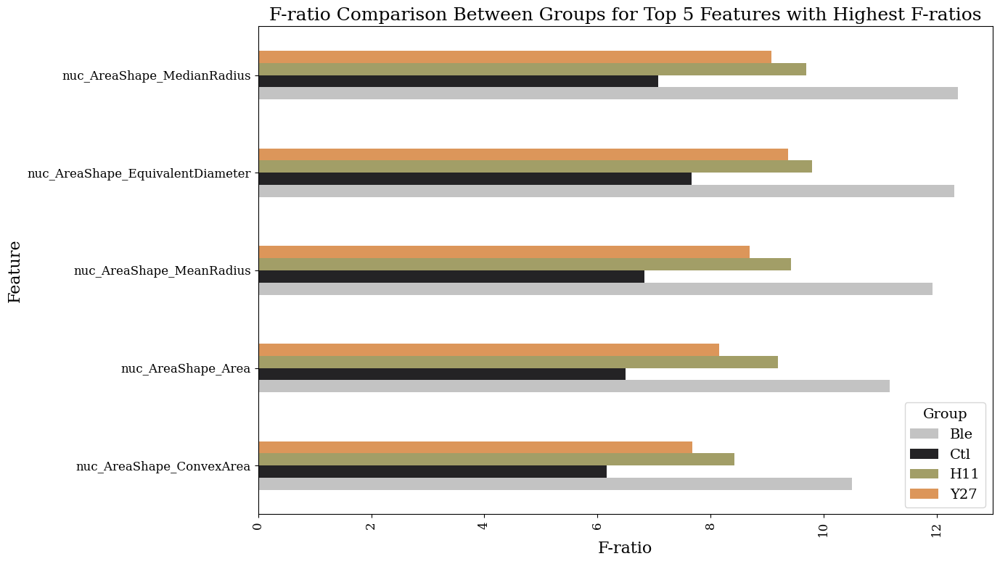

Group                                  Ble       Ctl       H11       Y27
Feature                                                                 
nuc_AreaShape_Area                0.528373  0.670668  0.621882  0.621179
nuc_AreaShape_ConvexArea          0.512971  0.654271  0.604990  0.610918
nuc_AreaShape_EquivalentDiameter  0.555368  0.713469  0.634280  0.646106
nuc_AreaShape_MeanRadius          0.538135  0.707404  0.590760  0.603587
nuc_AreaShape_MedianRadius        0.537214  0.700138  0.592594  0.589772


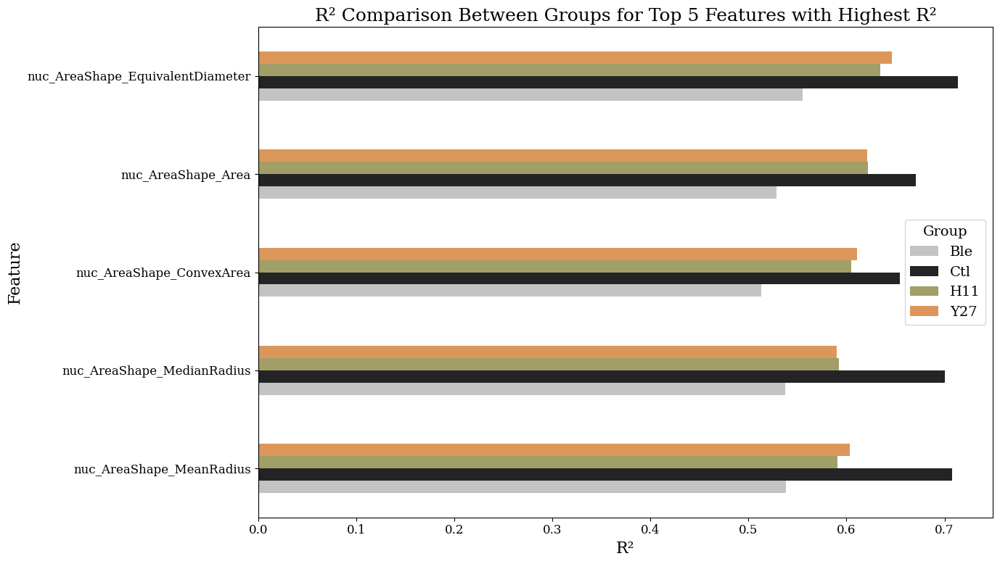

In [ ]:
# grouped bar plot of top 5 features with highest F-ratios

# Define the color palette for each treatment group (colorblind-friendly)
group_colors = {
    'Ble': '#C3C3C3',  # Silver
    'Ctl': '#242325',  # Raisin Black
    'H11': '#A29E67',  # Moss Green
    'Y27': '#DC965A'   # Persian Orange
}

# Get the top 5 features with the highest F-ratios for each group
top_results = mlr_results_df.groupby('Group').apply(lambda x: x.nlargest(5, 'F-ratio')).reset_index(drop=True)

# Identify features with the highest F-ratio for at least one group
features_with_highest_f_ratio = top_results['Feature'].unique()

# Filter the original results_df to include only these features
mlr_filtered_results = mlr_results_df[mlr_results_df['Feature'].isin(features_with_highest_f_ratio)]

# Pivot the DataFrame to get the values for each group as columns
pivoted_top_results = mlr_filtered_results.pivot_table(index='Feature', columns='Group', values='F-ratio')

# Fill missing values with zeros to ensure all groups are plotted
pivoted_top_results = pivoted_top_results.fillna(0)
print(pivoted_top_results)

# sort by F-ratio
pivoted_top_results = pivoted_top_results.sort_values(by='Ble', ascending=True)

# Plot the stacked bar plot
ax = pivoted_top_results.plot(kind='barh', stacked=False, figsize=(14, 8), color=[group_colors.get(col, '#333333') for col in pivoted_top_results.columns])

# Add labels and title
plt.title('F-ratio Comparison Between Groups for Top 5 Features with Highest F-ratios')
plt.xlabel('F-ratio')
plt.ylabel('Feature')
plt.xticks(rotation=90)
plt.legend(title='Group')
plt.tight_layout()

# Save the figure
filename = f"Bar_MLR_top5_Fratio.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()

######## Plot top 5 features with highest R² scores for each group #########

# Get the top 5 features with the highest R-squared values for each group
top_r_squared_results = mlr_results_df.groupby('Group').apply(lambda x: x.nlargest(5, 'R²')).reset_index(drop=True)

# Identify features with the highest R-squared for at least one group
features_with_highest_r_squared = top_r_squared_results['Feature'].unique()

# Filter the original results_df to include only these features
filtered_r_squared_results = mlr_results_df[mlr_results_df['Feature'].isin(features_with_highest_r_squared)]

# Pivot the DataFrame to get the values for each group as columns
pivoted_r_squared_results = filtered_r_squared_results.pivot_table(index='Feature', columns='Group', values='R²')

# Fill missing values with zeros to ensure all groups are plotted
pivoted_r_squared_results = pivoted_r_squared_results.fillna(0)
print(pivoted_r_squared_results)

# sort by R-squared
pivoted_r_squared_results = pivoted_r_squared_results.sort_values(by='H11', ascending=True)

# Plot the grouped horizontal bar plot for R-squared values
ax = pivoted_r_squared_results.plot(kind='barh', stacked=False, figsize=(14, 8), color=[group_colors.get(col, '#333333') for col in pivoted_r_squared_results.columns])

# Add labels and title
plt.title('R² Comparison Between Groups for Top 5 Features with Highest R²')
plt.xlabel('R²')
plt.ylabel('Feature')
plt.legend(title='Group')
plt.tight_layout()

# Save the figure
filename = f"Bar_MLR_top5_R2.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()


## Permutation test - sig diff between R²

In [ ]:
# Permutation test to determine if the R² scores are significantly different between groups

# Get unique features
features = mlr_results_df['Feature'].unique()

# Dictionary to store the permutation test results
permutation_test_results = []

# Function to perform permutation test
def permutation_test(data, group_col, feature_col, group1, group2, n_permutations=1000):
    # Initialize an empty list to store the permutation test results
    perm_results = []
    
    # Extract the R² scores for the current feature
    r2_scores = data[data['Feature'] == feature_col]['R²']

    # Calculate the observed difference in R² scores between groups
    observed_diff = r2_scores[data[group_col] == group1].mean() - r2_scores[data[group_col] == group2].mean()
    
    # Iterate over the number of permutations
    for _ in range(n_permutations):
        # Shuffle the group labels
        shuffled_groups = data[group_col].sample(frac=1, replace=False).reset_index(drop=True)
        
        # Calculate the difference in R² scores between the shuffled groups
        shuffled_diff = r2_scores[shuffled_groups == group1].mean() - r2_scores[shuffled_groups == group2].mean()
        
        # Append the shuffled difference to the results list
        perm_results.append(shuffled_diff)
    
    # Calculate the p-value (look into how this p val is being calculated  )
    p_value = (np.abs(perm_results) >= np.abs(observed_diff)).mean()
    
    return observed_diff, p_value

# Perform permutation test for each feature and each pairwise comparison with the control group
control_group = 'Ctl'
treatment_groups = [group for group in mlr_results_df['Group'].unique() if group != control_group]

for feature in features:
    for treatment_group in treatment_groups:
        # Perform the permutation test
        observed_diff, p_value = permutation_test(mlr_results_df, 'Group', feature, control_group, treatment_group)
        
        # Store the results in the list
        permutation_test_results.append({
            'Feature': feature,
            'Control Group': control_group,
            'Treatment Group': treatment_group,
            'Observed Difference': observed_diff,
            'P-Value': p_value
        })

# Convert the results to a DataFrame
mlr_results_perm_df = pd.DataFrame(permutation_test_results)

# create file path for output and save the results
output_path = os.path.join(original_file_path, 'MLR_perm_results.csv')
mlr_results_perm_df.to_csv(output_path, index=False)

# Print results
for feature, results in mlr_results_perm_df.groupby('Feature'):
    print(f"Feature: {feature}")
    for _, result in results.iterrows():
        print(f"Control Group: {result['Control Group']}, Treatment Group: {result['Treatment Group']}")
        print(f"Observed Difference: {result['Observed Difference']:.4f}")
        print(f"P-Value: {result['P-Value']:.4f}")
    print()


Feature: nuc_AreaShape_Area
Control Group: Ctl, Treatment Group: H11
Observed Difference: 0.0488
P-Value: 0.2790
Control Group: Ctl, Treatment Group: Y27
Observed Difference: 0.0495
P-Value: 0.2280
Control Group: Ctl, Treatment Group: Ble
Observed Difference: 0.1423
P-Value: 0.0360

Feature: nuc_AreaShape_AspectRatio
Control Group: Ctl, Treatment Group: H11
Observed Difference: 0.0201
P-Value: 0.3600
Control Group: Ctl, Treatment Group: Y27
Observed Difference: -0.0359
P-Value: 0.3350
Control Group: Ctl, Treatment Group: Ble
Observed Difference: -0.0719
P-Value: 0.1050

Feature: nuc_AreaShape_Circularity
Control Group: Ctl, Treatment Group: H11
Observed Difference: 0.1129
P-Value: 0.1020
Control Group: Ctl, Treatment Group: Y27
Observed Difference: -0.0230
P-Value: 0.4230
Control Group: Ctl, Treatment Group: Ble
Observed Difference: 0.0706
P-Value: 0.2820

Feature: nuc_AreaShape_Compactness
Control Group: Ctl, Treatment Group: H11
Observed Difference: -0.0545
P-Value: 0.2850
Control Gr

## Plot Top 5 feature R² by group

Group                                  Ble       Ctl       H11       Y27
Feature                                                                 
nuc_AreaShape_Area                0.528373  0.670668  0.621882  0.621179
nuc_AreaShape_ConvexArea          0.512971  0.654271  0.604990  0.610918
nuc_AreaShape_EquivalentDiameter  0.555368  0.713469  0.634280  0.646106
nuc_AreaShape_MeanRadius          0.538135  0.707404  0.590760  0.603587
nuc_AreaShape_MedianRadius        0.537214  0.700138  0.592594  0.589772


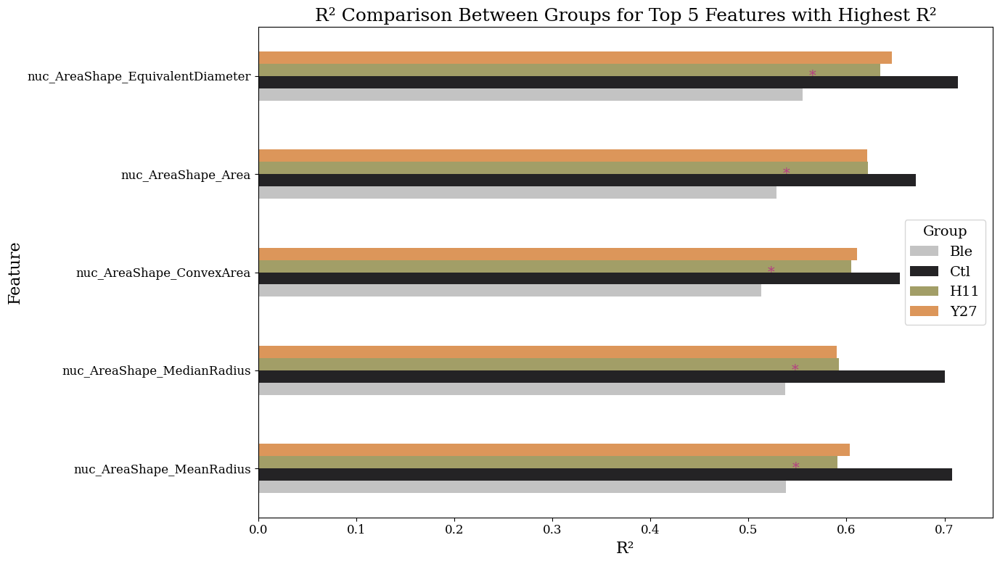

In [ ]:

######## Plot top features with highest R² scores for each group #########

# Get the top 5 features with the highest R-squared values for each group
top_r_squared_results = mlr_results_df.groupby('Group').apply(lambda x: x.nlargest(5, 'R²')).reset_index(drop=True)

# Identify features with the highest R-squared for at least one group
features_with_highest_r_squared = top_r_squared_results['Feature'].unique()

# Filter the original results_df to include only these features
filtered_r_squared_results = mlr_results_df[mlr_results_df['Feature'].isin(features_with_highest_r_squared)]

# Pivot the DataFrame to get the values for each group as columns
pivoted_r_squared_results = filtered_r_squared_results.pivot_table(index='Feature', columns='Group', values='R²')

# Fill missing values with zeros to ensure all groups are plotted
pivoted_r_squared_results = pivoted_r_squared_results.fillna(0)
print(pivoted_r_squared_results)

# sort by R-squared
pivoted_r_squared_results = pivoted_r_squared_results.sort_values(by='H11', ascending=True)

# Plot the grouped horizontal bar plot for R-squared values
ax = pivoted_r_squared_results.plot(kind='barh', stacked=False, figsize=(14, 8), color=[group_colors.get(col, '#333333') for col in pivoted_r_squared_results.columns])

# Add labels and title
plt.title('R² Comparison Between Groups for Top 5 Features with Highest R²')
plt.xlabel('R²')
plt.ylabel('Feature')
plt.legend(title='Group')
plt.tight_layout()

# Annotate significant p-values with asterisks
significance_threshold = 0.05
for feature in pivoted_r_squared_results.index:
    for group in pivoted_r_squared_results.columns:
        if group != 'Ctl':  # Compare each group to the control
             for result in mlr_results_perm_df[mlr_results_perm_df['Feature'] == feature].itertuples():
                if result._3 == group and result._5 < significance_threshold:  # result._3 is Treatment Group, result._5 is P-Value
                    x = pivoted_r_squared_results.loc[feature, group]
                    y = pivoted_r_squared_results.index.get_loc(feature)
                    ax.text(x + 0.01, y, '*', color='#b63d83', fontsize=14, ha='center', va='center')

# Save the figure
filename = f"Bar_MLR_significance_top5.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()

## Scatter plots of top feature pairs

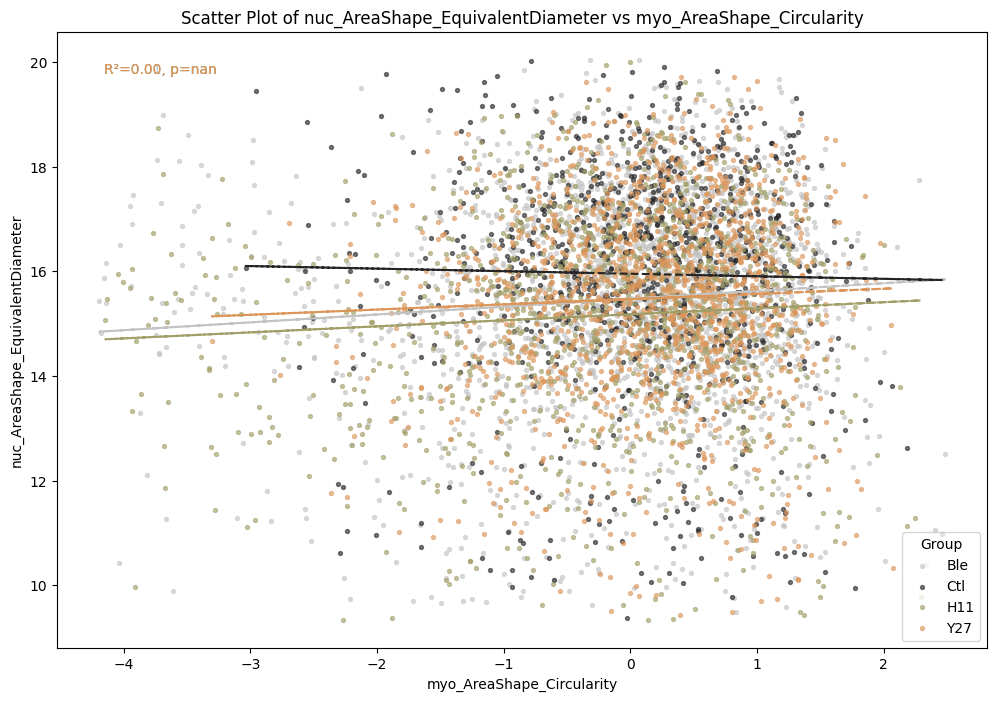

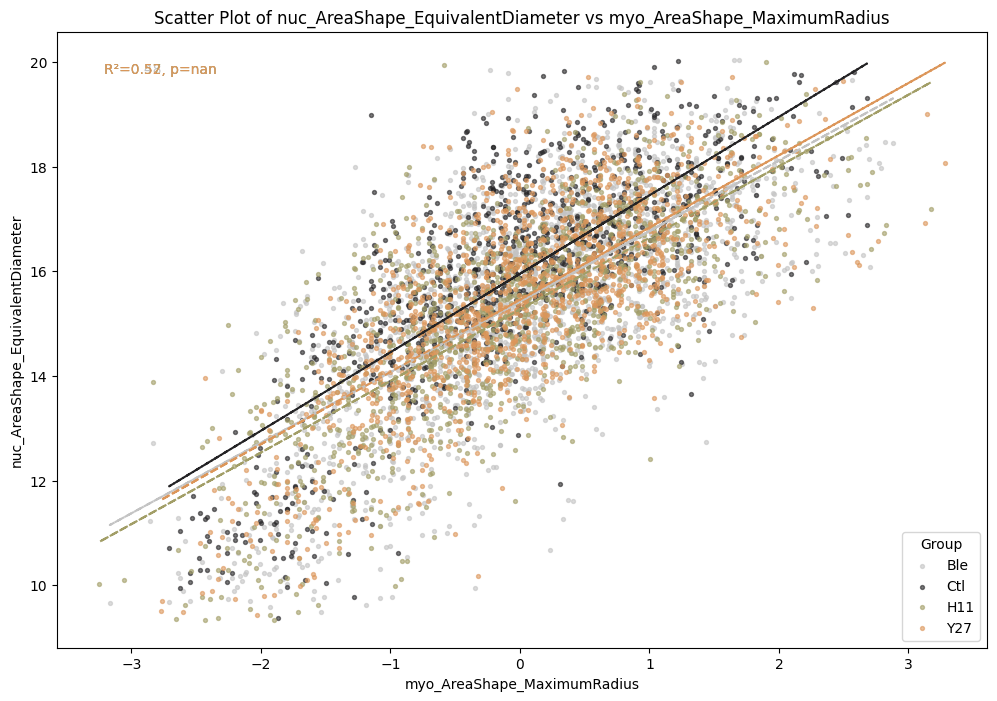

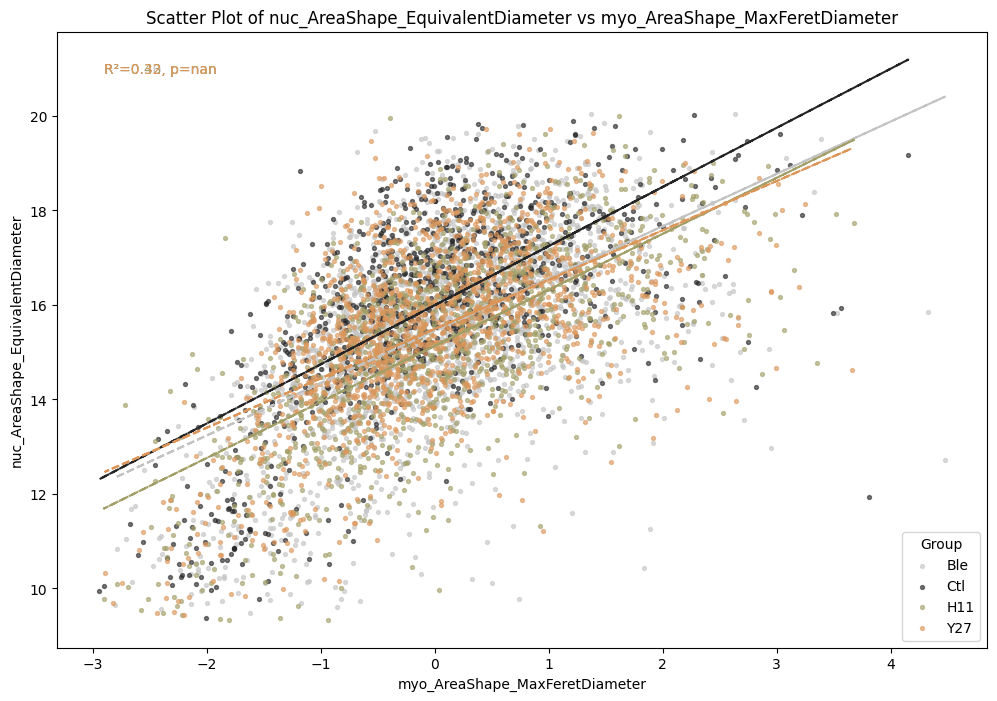

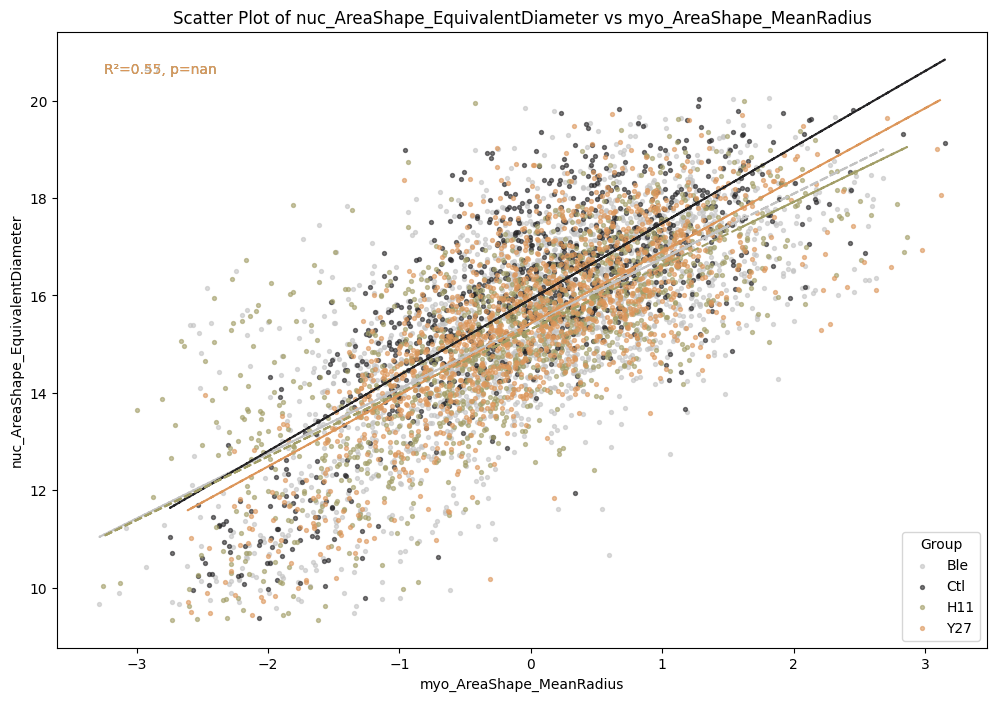

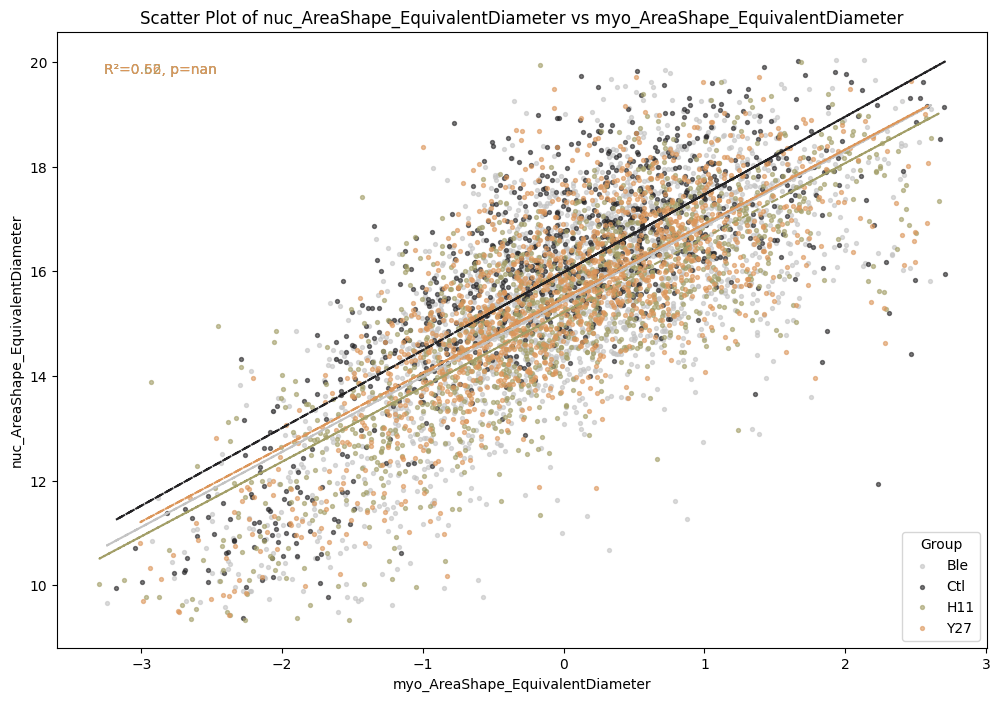

...

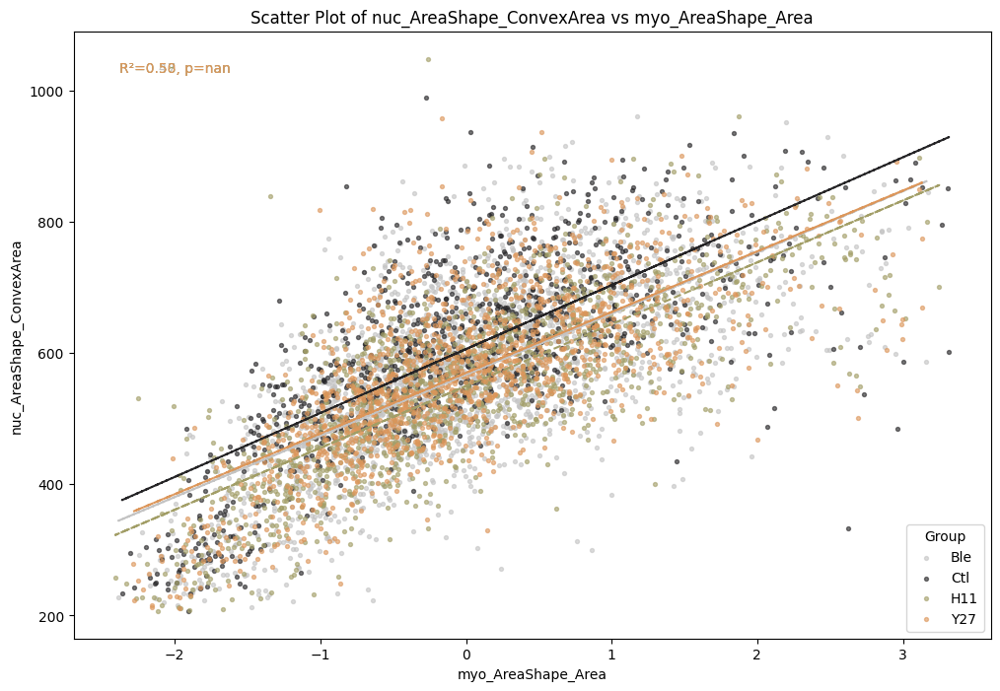

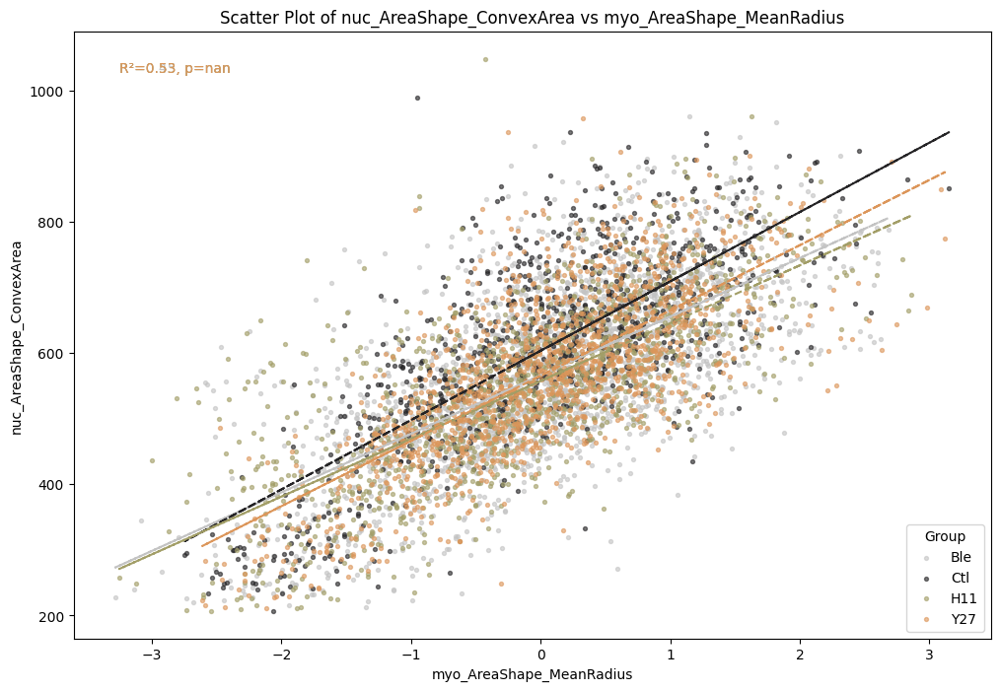

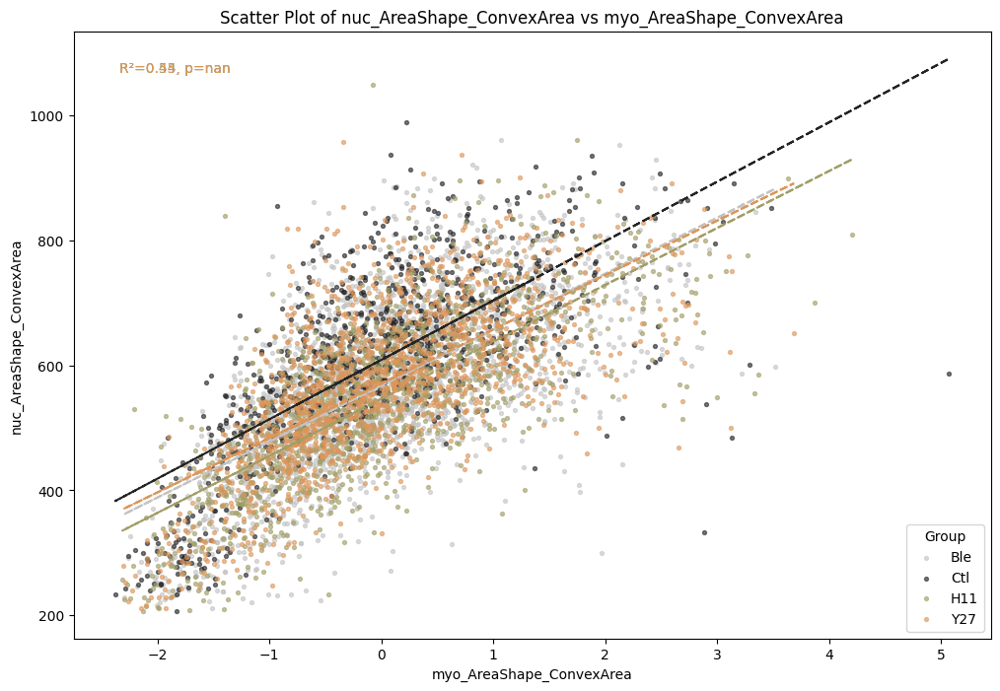

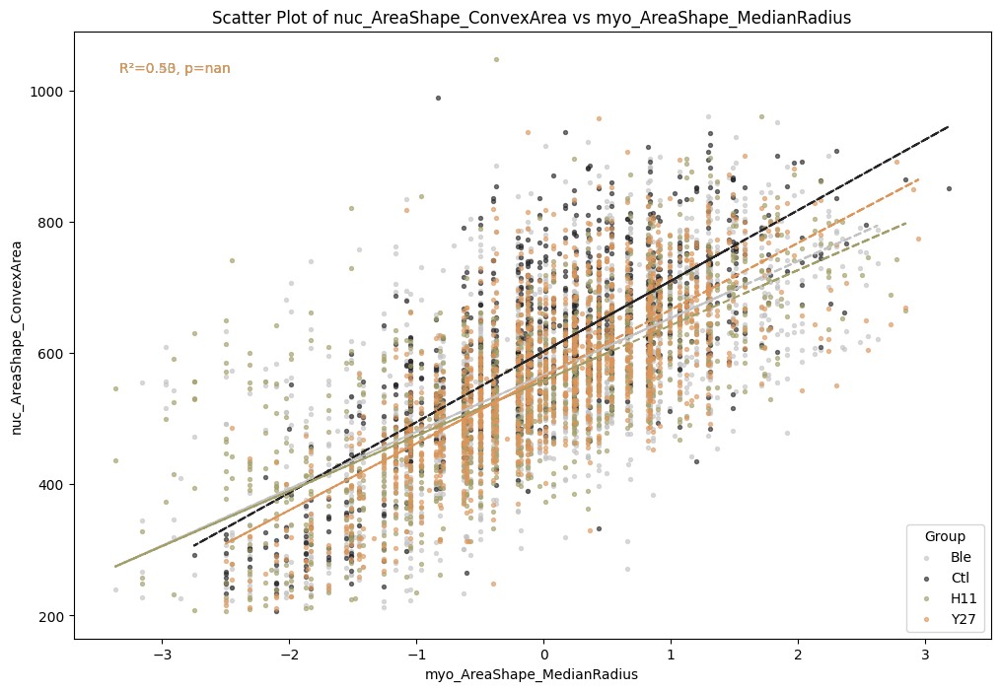

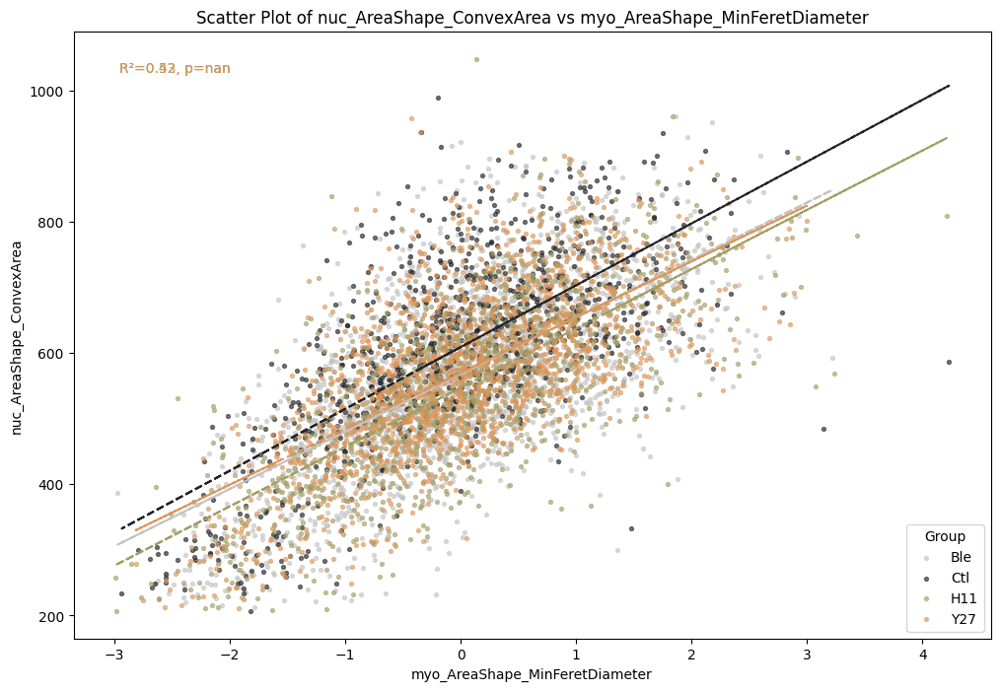

In [ ]:
# going back to the original data, scatter plots of the three features with the highest R² scores for at least one group vs each of the myo features that were determined by the MLR model to be the most predictive

# Get the top 3 features with the highest R-squared values for at least one group
top3_r_squared_results = mlr_results_df.groupby('Group').apply(lambda x: x.nlargest(3, 'R²')).reset_index(drop=True)

# Identify features with the highest R-squared for at least one group
features_top3_r_squared = top3_r_squared_results['Feature'].unique()

# Filter the original results_df to include only these features
filtered_top3_r_squared_results = mlr_results_df[mlr_results_df['Feature'].isin(features_top3_r_squared)]

# original data
# Extract nuc and myo features from the original data
nuc_features = df_cleaned.filter(like='nuc_')
myo_features = df_cleaned.filter(like='myo_')

# Normalize the myo features    
scaler = StandardScaler()
myo_features_normalized = scaler.fit_transform(myo_features)

# Add normalized myo features back to the dataframe
df_cleaned_normalized = df_cleaned.copy()
df_cleaned_normalized[myo_features.columns] = myo_features_normalized

# Extract unique treatment groups
groups = df_cleaned['group'].unique()

# Create scatter plots for each nuc feature against each unique myo feature, colored by group
for nuc_feature in features_top3_r_squared:
    # Get the myo features that are important predictors for this nuc feature from the MLR model results
    important_myo_features = filtered_top3_r_squared_results[filtered_top3_r_squared_results['Feature'] == nuc_feature]['Top Predictive Features'].explode().unique()
    # Ensure important_myo_features are correctly formatted
    important_myo_features = [feature.strip() for feature in important_myo_features if feature.strip() in myo_features.columns]
    
    # Plot each important myo feature against the nuc feature
    for myo_feature in important_myo_features:
        plt.figure(figsize=(12, 8))
        for group in groups:
            group_data = df_cleaned_normalized[df_cleaned_normalized['group'] == group]
            plt.scatter(group_data[myo_feature], 
                        group_data[nuc_feature], 
                        color=group_colors[group], 
                        label=group, 
                        alpha=0.6, 
                        s=8)
            # Fit linear regression model
            X = sm.add_constant(group_data[myo_feature])
            y = group_data[nuc_feature]
            model = sm.OLS(y, X).fit()
            
            # Plot regression line
            plt.plot(group_data[myo_feature], 
                     model.predict(X), 
                     color=group_colors[group], 
                     linestyle='--')
            
            # Annotate with R-squared and p-value
            if group != 'Ctl':
                ctl_data = df_cleaned_normalized[df_cleaned_normalized['group'] == 'Ctl']
                X_ctl = sm.add_constant(ctl_data[myo_feature])
                y_ctl = ctl_data[nuc_feature]
                model_ctl = sm.OLS(y_ctl, X_ctl).fit()
                
                # Perform t-test to compare slopes
                t_test = model.compare_f_test(model_ctl)
                p_value = t_test[1]
                
                plt.annotate(f'R²={model.rsquared:.2f}, p={p_value:.3f}', 
                             xy=(0.05, 0.95), 
                             xycoords='axes fraction', 
                             fontsize=10, 
                             color=group_colors[group],
                             ha='left', 
                             va='top')
        
        plt.title(f'Scatter Plot of {nuc_feature} vs {myo_feature}')
        plt.xlabel(myo_feature)
        plt.ylabel(nuc_feature)
        plt.legend(title='Group', loc = 'lower right')
        plt.grid(False)
        plt.show()

## Nuclear Equivalent Diameter

In [ ]:
# closer look at the top nuc feature: equivalent diameter

# Filter the results_df for the nuc feature of interest
nuc_feature = 'nuc_AreaShape_EquivalentDiameter'
filtered_results_df = mlr_results_df[mlr_results_df['Feature'] == nuc_feature]

# Initialize a dictionary to store the contributions
mlr_contributions_dict = {}

# Aggregate the feature contributions
for index, row in filtered_results_df.iterrows():
    group = row['Group']
    feature_contributions = row['Feature Contributions']
    for feature, contribution in feature_contributions.items():
        if feature not in mlr_contributions_dict:
            mlr_contributions_dict[feature] = {}
        mlr_contributions_dict[feature][group] = contribution

# Convert the dictionary to a DataFrame
mlr_contributions_df = pd.DataFrame(mlr_contributions_dict).transpose().fillna(0)

# Display the table using tabulate
print(tabulate(mlr_contributions_df, headers='keys', tablefmt='pretty'))

+--------------------------------------------------+---------------------+---------------------+---------------------+----------------------+
|                                                  |         Ctl         |         Y27         |         H11         |         Ble          |
+--------------------------------------------------+---------------------+---------------------+---------------------+----------------------+
|            myo_AreaShape_Circularity             | 0.21348999337526045 | 0.2765125589864147  | 0.17150732967173185 |  0.2920130111704745  |
|           myo_AreaShape_MaximumRadius            | 0.17502134201527664 |         0.0         | 0.21596593009063522 |         0.0          |
|          myo_AreaShape_MaxFeretDiameter          | 0.17131633027801652 | 0.15499246993176344 | 0.19107011496976758 | 0.15721580063089152  |
|             myo_AreaShape_MeanRadius             | 0.16812412156086307 | 0.13438742726248837 | 0.18194327391825033 |  0.181454153517367   |
|     

## Top 10 most predictive cell features - bar plot

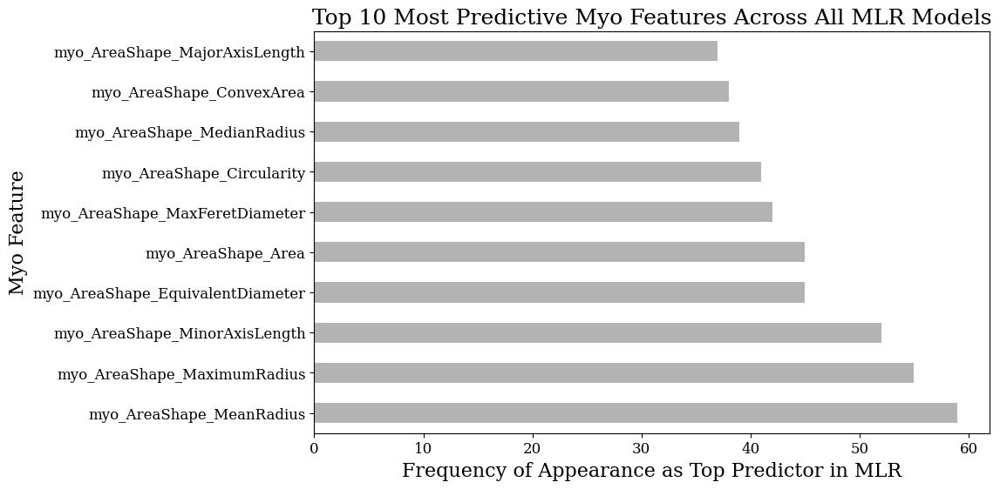

In [ ]:
# Analyze the coefficients from the Ridge models for each group and feature.
# Identify the top myo_features that are consistently influential in predicting various nuclear features.

# Explode the top features column to count frequency of important features
top_features_summary = mlr_results_df.explode('Top Predictive Features')['Top Predictive Features'].value_counts()

# Plot the top 10 most predictive myo_features across all models
top_features_summary.head(10).plot(kind='barh', figsize=(10, 6), color='#B3B3B3')
plt.title("Top 10 Most Predictive Myo Features Across All MLR Models")
plt.xlabel("Frequency of Appearance as Top Predictor in MLR")
plt.ylabel("Myo Feature")

# Save the figure
filename = f"Bar_MLR_cell_contribution.png"
plt.savefig(os.path.join(save_dir, filename))

plt.show()


# Random Forest - non-linear model

In [ ]:
# random forest regression analysis to predict nuclear features from cell features, compare the results with MLR

# Extract nuc and myo features 
nuc_features = df_cleaned.filter(like='nuc_')
myo_features = df_cleaned.filter(like='myo_')

# exclude features that are irrelevant using regex
myo_features_exclued = myo_features.filter(regex='Moment_')
nuc_features_exclued = nuc_features.filter(regex='Moment_')

# drop the excluded features
myo_features = myo_features.drop(columns=myo_features_exclued.columns)
nuc_features = nuc_features.drop(columns=nuc_features_exclued.columns)

# Normalize the myo features
scaler = StandardScaler()
myo_features_normalized = scaler.fit_transform(myo_features)

# Add normalized myo features back to the dataframe
df_features_normalized = df_cleaned.copy()
df_features_normalized[myo_features.columns] = myo_features_normalized

# Extract unique treatment groups
groups = df_features['group'].unique()

# list of results (list for easy DF creation)
rf_results_all = []

for group in groups:
    # filter
    df_group = df_features_normalized[df_features_normalized['group'] == group]

    # Iterate over each nuc feature
    for nuc_feature in nuc_features.columns:
        # Define the target variable as the current nuc feature
        y = df_group[nuc_feature]
        
         # Combine normalized myo features into a single dataframe
        X = df_group[myo_features.columns]

        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # Train the Random Forest model
        rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
        rf_model.fit(X_train, y_train)

        # Predict on the test set
        y_pred = rf_model.predict(X_test)

        # Calculate metrics
        rf_r2 = r2_score(y_test, y_pred)
        rf_mae = mean_absolute_error(y_test, y_pred)
        rf_mse = mean_squared_error(y_test, y_pred)
        rf_rmse = np.sqrt(rf_mse)
        importances = rf_model.feature_importances_
        top_features = pd.Series(importances, index=X.columns).nlargest(5).to_dict()
        rf_cv_scores = cross_val_score(rf_model, X, y, cv=5, scoring='r2').mean()

        # Store the results
        rf_results_all.append({
            'Group': group,
            'Feature': nuc_feature,
            'R²': rf_r2,
            'MAE': rf_mae,
            'MSE': rf_mse,
            'RMSE': rf_rmse,
            'Top Features': top_features,
            'CV R² Score': rf_cv_scores
        })

# Convert results to DataFrame
rf_results_df = pd.DataFrame(rf_results_all)

# get path for original data 
original_file_path = os.path.dirname(file_path)

# create file path for output and save the results
output_path = os.path.join(original_file_path, 'rf_results.csv')
rf_results_df.to_csv(output_path, index=False)

# Extract feature importances from the last trained model (for demonstration purposes)
feature_importances = rf_model.feature_importances_

# Create a DataFrame for feature importances
feature_importances_df = pd.DataFrame({
    'Feature': myo_features.columns,
    'Importance': feature_importances
}).sort_values(by='Importance', ascending=False)

# Display the feature importances using tabulate
print(tabulate(feature_importances_df, headers='keys', tablefmt='pretty'))

# print hoe many cell features are used in the model
cell_feature_count = myo_features.shape[1]

# print how many myo features are used in the model
myo_feature_count = myo_features.shape[1]
print(f"Number of myo features used in the model: {myo_feature_count}")

+----+----------------------------------+----------------------+
|    |             Feature              |      Importance      |
+----+----------------------------------+----------------------+
| 15 |   myo_AreaShape_MaximumRadius    | 0.11573386681465038  |
| 9  |  myo_AreaShape_MinorAxisLength   |  0.0867199368708731  |
| 4  |       myo_AreaShape_Extent       | 0.08432107568569353  |
| 7  |     myo_AreaShape_MeanRadius     |  0.0798111023255894  |
| 11 |    myo_AreaShape_Orientation     | 0.07655920348036044  |
| 5  |      myo_AreaShape_Solidity      | 0.06822413851092461  |
| 2  |  myo_AreaShape_MinFeretDiameter  | 0.06451523970992579  |
| 3  |  myo_AreaShape_MaxFeretDiameter  | 0.04838185140910822  |
| 8  |    myo_AreaShape_Eccentricity    | 0.04547413059871128  |
| 12 |    myo_AreaShape_Compactness     | 0.04503304528522336  |
| 17 |    myo_AreaShape_Circularity     | 0.04484164414355781  |
| 1  |     myo_AreaShape_Perimeter      | 0.044401320432004794 |
| 16 |    myo_AreaShape_A

## bar plot RF results by group

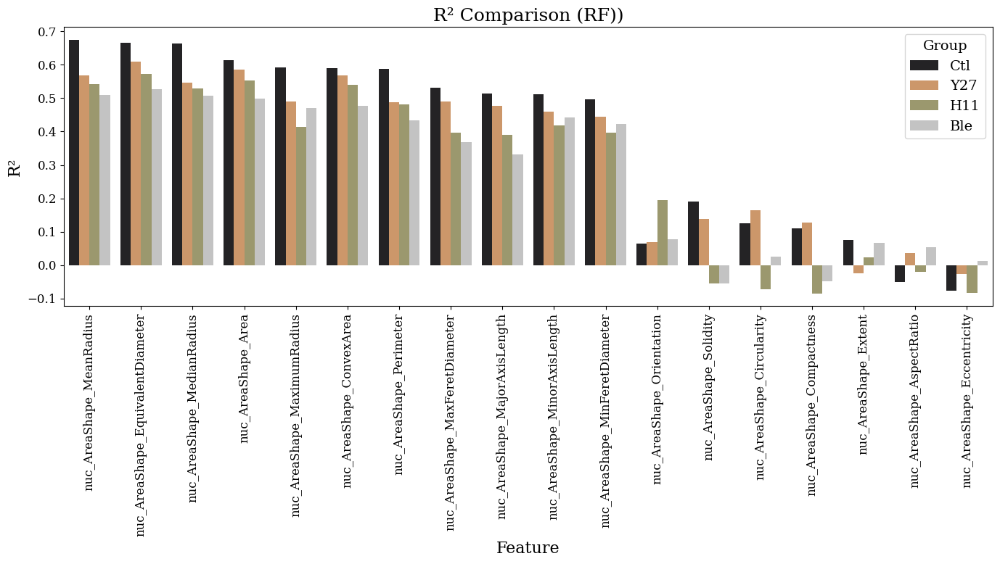

In [ ]:
# plot RF results for each group

# Define the color palette for each treatment group (colorblind-friendly)
group_colors = {
    'Ble': '#C3C3C3',  # Silver
    'Ctl': '#242325',  # Raisin Black
    'H11': '#A29E67',  # Moss Green
    'Y27': '#DC965A'   # Persian Orange
}

# Sort the DataFrame by 'R² Score' in descending order
rf_sorted_df = rf_results_df.sort_values(by='R²', ascending=False)

# Melt the DataFrame to long format for seaborn
rf_melted_df = rf_sorted_df.melt(id_vars=['Group', 'Feature'], value_vars=['R²'], var_name='Metric', value_name='Value')

# Create the plot
plt.figure(figsize=(14, 8))
sns.barplot(data=rf_melted_df, x='Feature', y='Value', hue='Group', palette=group_colors)
plt.title('R² Comparison (RF))')
plt.xlabel('Feature')
plt.ylabel('R²')
plt.xticks(rotation=90)
plt.legend(title='Group')
plt.tight_layout()

# Save the figure
filename = f"Bar_RF_comparison.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()

## Plot mean R² accross features

        Mean R²  Mean Cross-Val R²
Group                             
Ble    0.284577           0.266833
Ctl    0.382037           0.343050
H11    0.285445           0.219503
Y27    0.344865           0.291876


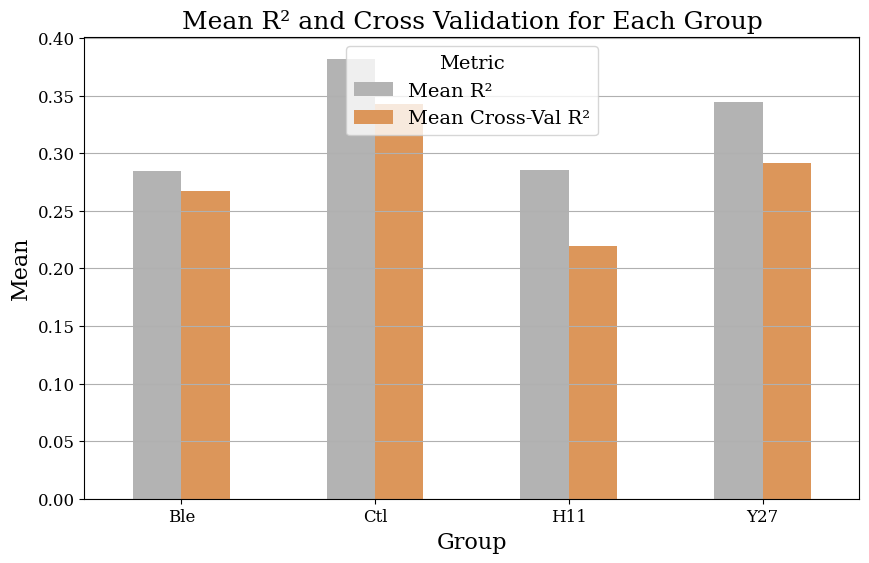

In [ ]:
# Generalizations accross all features
# Calculate the mean R² scores for each group
rf_mean_r2 = rf_results_df.groupby('Group')['R²'].mean()

# Calculate mean cross-validated R² scores for each group
rf_mean_cv_scores = rf_results_df.groupby('Group')['CV R² Score'].mean()

# Create a DataFrame from the mean scores
rf_mean_scores_df = pd.concat([rf_mean_r2, rf_mean_cv_scores], axis=1)

# Rename the columns
rf_mean_scores_df.columns = ['Mean R²', 'Mean Cross-Val R²']

# Save the mean scores to a CSV file
output_path = os.path.join(original_file_path, 'rf_means_by_group.csv')
rf_mean_scores_df.to_csv(output_path)

# Print the mean scores
print(rf_mean_scores_df)

# Plot the mean R² scores and mean cross validation R² for each group
plt.figure(figsize=(10, 6))

# Create the bar plot
rf_mean_scores_df[['Mean R²', 'Mean Cross-Val R²']].plot(kind='bar', ax=plt.gca(), color=['#B3B3B3', '#DC965A'])

# Add labels and title
plt.title('Mean R² and Cross Validation for Each Group')
plt.ylabel('Mean')
plt.xlabel('Group')
plt.xticks(rotation=0)
plt.legend(title='Metric', loc='upper center')
plt.grid(axis='y')

# Save the figure
filename = f"Bar_RF_means.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()

## Permutation Test

In [ ]:
# Permutation test to determine if the R² scores are significantly different between groups

# Get unique features
features = rf_results_df['Feature'].unique()

# Dictionary to store the permutation test results
permutation_rf_results = []

# Function to perform permutation test
def permutation_test(data, group_col, feature_col, group1, group2, n_permutations=1000):
    # Initialize an empty list to store the permutation test results
    perm_results = []
    
    # Extract the R² scores for the current feature
    r2_scores = data[data['Feature'] == feature_col]['R²']

    # Calculate the observed difference in R² scores between groups
    observed_diff = r2_scores[data[group_col] == group1].mean() - r2_scores[data[group_col] == group2].mean()
    
    # Iterate over the number of permutations
    for _ in range(n_permutations):
        # Shuffle the group labels
        shuffled_groups = data[group_col].sample(frac=1, replace=False).reset_index(drop=True)
        
        # Calculate the difference in R² scores between the shuffled groups
        shuffled_diff = r2_scores[shuffled_groups == group1].mean() - r2_scores[shuffled_groups == group2].mean()
        
        # Append the shuffled difference to the results list
        perm_results.append(shuffled_diff)
    
    # Calculate the p-value (look into how this p val is being calculated  )
    p_value = (np.abs(perm_results) >= np.abs(observed_diff)).mean()
    
    return observed_diff, p_value

# Perform permutation test for each feature and each pairwise comparison with the control group
control_group = 'Ctl'
treatment_groups = [group for group in rf_results_df['Group'].unique() if group != control_group]

for feature in features:
    for treatment_group in treatment_groups:
        # Perform the permutation test
        observed_diff, p_value = permutation_test(rf_results_df, 'Group', feature, control_group, treatment_group)
        
        # Store the results in the list
        permutation_rf_results.append({
            'Feature': feature,
            'Control Group': control_group,
            'Treatment Group': treatment_group,
            'Observed Difference': observed_diff,
            'P-Value': p_value
        })

# Convert the results to a DataFrame
rf_results_perm_df = pd.DataFrame(permutation_rf_results)

# create file path for output and save the results
output_path = os.path.join(original_file_path, 'RF_perm_results.csv')
rf_results_perm_df.to_csv(output_path, index=False)

# Print results
for feature, results in rf_results_perm_df.groupby('Feature'):
    print(f"Feature: {feature}")
    for _, result in results.iterrows():
        print(f"Control Group: {result['Control Group']}, Treatment Group: {result['Treatment Group']}")
        print(f"Observed Difference: {result['Observed Difference']:.4f}")
        print(f"P-Value: {result['P-Value']:.4f}")
    print()

Feature: nuc_AreaShape_Area
Control Group: Ctl, Treatment Group: Ble
Observed Difference: 0.1170
P-Value: 0.0300
Control Group: Ctl, Treatment Group: H11
Observed Difference: 0.0616
P-Value: 0.1920
Control Group: Ctl, Treatment Group: Y27
Observed Difference: 0.0290
P-Value: 0.3910

Feature: nuc_AreaShape_AspectRatio
Control Group: Ctl, Treatment Group: Ble
Observed Difference: -0.1061
P-Value: 0.0370
Control Group: Ctl, Treatment Group: H11
Observed Difference: -0.0311
P-Value: 0.3500
Control Group: Ctl, Treatment Group: Y27
Observed Difference: -0.0869
P-Value: 0.1050

Feature: nuc_AreaShape_Circularity
Control Group: Ctl, Treatment Group: Ble
Observed Difference: 0.0988
P-Value: 0.2720
Control Group: Ctl, Treatment Group: H11
Observed Difference: 0.1964
P-Value: 0.0770
Control Group: Ctl, Treatment Group: Y27
Observed Difference: -0.0392
P-Value: 0.3870

Feature: nuc_AreaShape_Compactness
Control Group: Ctl, Treatment Group: Ble
Observed Difference: 0.1571
P-Value: 0.2060
Control Gr

## top nuc feature R² (from MLR, so we can compare)

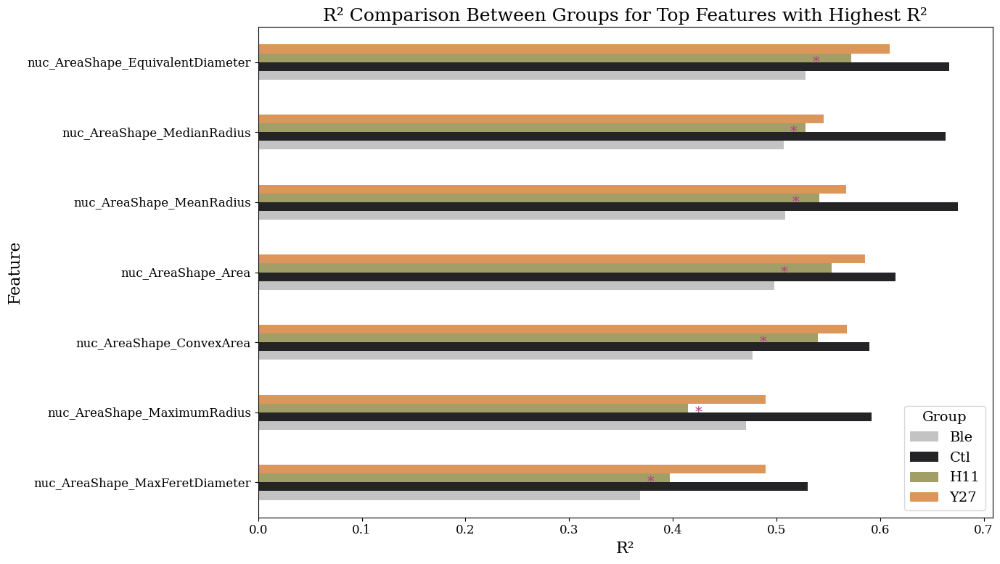

In [ ]:
######## Plot top features with highest R² scores for each group #########

# Get the top features from MLR results
top_mlr_features = ['nuc_AreaShape_MaxFeretDiameter',
                    'nuc_AreaShape_MaximumRadius',
                    'nuc_AreaShape_ConvexArea',
                    'nuc_AreaShape_Area',
                    'nuc_AreaShape_MeanRadius',
                    'nuc_AreaShape_MedianRadius',
                    'nuc_AreaShape_EquivalentDiameter'
]

# Filter the original results_df to include only these features
filtered_rf_r_squared = rf_results_df[rf_results_df['Feature'].isin(top_mlr_features)]

# Pivot the DataFrame to get the values for each group as columns
pivoted_rf_r_squared = filtered_rf_r_squared.pivot_table(index='Feature', columns='Group', values='R²')

# Fill missing values with zeros to ensure all groups are plotted
pivoted_rf_r_squared = pivoted_rf_r_squared.fillna(0)

# Ensure the features are in the order specified in top_mlr_features
pivoted_rf_r_squared = pivoted_rf_r_squared.reindex(top_mlr_features)

# Plot the grouped horizontal bar plot for R-squared values
ax = pivoted_rf_r_squared.plot(kind='barh', stacked=False, figsize=(14, 8), color=[group_colors.get(col, '#333333') for col in pivoted_rf_r_squared.columns])

# Add labels and title
plt.title('R² Comparison Between Groups for Top Features with Highest R²')
plt.xlabel('R²')
plt.ylabel('Feature')
plt.legend(title='Group')
plt.tight_layout()

# Annotate significant p-values with asterisks
significance_threshold = 0.05
for feature in pivoted_rf_r_squared.index:
    for group in pivoted_rf_r_squared.columns:
        if group != 'Ctl':  # Compare each group to the control
             for result in rf_results_perm_df[rf_results_perm_df['Feature'] == feature].itertuples():
                if result._3 == group and result._5 < significance_threshold:  # result._3 is Treatment Group, result._5 is P-Value
                    x = pivoted_rf_r_squared.loc[feature, group]
                    y = pivoted_rf_r_squared.index.get_loc(feature)
                    ax.text(x + 0.01, y, '*', color='#b63d83', fontsize=14, ha='center', va='center')

# Save the figure
filename = f"Bar_RF_significance.png"
plt.savefig(os.path.join(save_dir, filename))

# Show the plot
plt.show()

## table comparing MLR and RF results

In [ ]:
# compare OLS MLR and RF results: R² scores

# Rename the "Dependent Feature" column in the OLS DataFrame to "Feature"
regression_results_df.rename(columns={'Dependent Feature': 'Feature'}, inplace=True)

# Filter to get the highest R² value for each group and feature
highest_r2_ols_df = regression_results_df.loc[regression_results_df.groupby(['Group', 'Feature'])['R²'].idxmax()]

# Merge the OLS, MLR, and RF results DataFrames on 'Group' and 'Feature'
merged_results_df = pd.merge(highest_r2_ols_df, mlr_results_df, on=['Group', 'Feature'], suffixes=('_OLS', '_MLR'))
merged_results_df = pd.merge(merged_results_df, rf_results_df, on=['Group', 'Feature'])
merged_results_df.rename(columns={'R²': 'R²_RF'}, inplace=True)

# Calculate the differences in R² scores
merged_results_df['R² Difference (OLS-MLR)'] = merged_results_df['R²_OLS'] - merged_results_df['R²_MLR']
merged_results_df['R² Difference (OLS-RF)'] = merged_results_df['R²_OLS'] - merged_results_df['R²_RF']
merged_results_df['R² Difference (MLR-RF)'] = merged_results_df['R²_MLR'] - merged_results_df['R²_RF']

# Make a pretty table with just the R² scores and differences
print(tabulate(merged_results_df[['Group', 'Feature', 'R²_OLS', 'R²_MLR', 'R²_RF', 'R² Difference (OLS-MLR)', 'R² Difference (OLS-RF)', 'R² Difference (MLR-RF)']], headers='keys', tablefmt='pretty'))

# Sort the table by Feature
merged_sorted_df = merged_results_df.sort_values(by=['Feature'], ascending=[True])

# Display the sorted DataFrame using Plotly
fig = go.Figure(data=[go.Table(
    header=dict(values=list(merged_sorted_df.columns),
                fill_color='paleturquoise',
                align='left'),
    cells=dict(values=[merged_sorted_df[col] for col in merged_sorted_df.columns],
               fill_color='lavender',
               align='left'))
])

# save the table as a csv file
output_path = os.path.join(original_file_path, 'merged_results.csv')
merged_results_df.to_csv(output_path, index=False)

fig.show()


NameError: name 'regression_results_df' is not defined

# Basic Statistics

Summary stats for the main data set (feature masurements)

In [ ]:
# check the data again for outliers - the data is the features of interest, after converting to microns and without normalization

# Verify that the data does not contain outliers
print("Summary statistics before plotting:")
print(df_features.describe())

# Check for any values beyond the expected range
for col in df_features.columns:
    if col != 'group':
        # Calculate Q1 (25th percentile) and Q3 (75th percentile)
        Q1 = df_features[col].quantile(0.25)
        Q3 = df_features[col].quantile(0.75)

        # Calculate the IQR (Interquartile Range)
        IQR = Q3 - Q1

        # Define the lower and upper bounds for outliers
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Identify outliers
        outliers = df_features[(df_features[col] < lower_bound) | (df_features[col] > upper_bound)]

        # Count the number of outliers
        num_outliers = outliers.shape[0]

        if num_outliers > 0:
            print(f"Potential outliers detected in column {col}: {num_outliers} outliers")
            print(outliers)

Summary statistics before plotting:
       ImageNumber  ObjectNumber  myo_AreaShape_SpatialMoment_1_1  \
count  6124.000000   6124.000000                     6.124000e+03   
mean     94.941215     33.614468                     1.960299e+07   
std      62.459246     27.648853                     2.918467e+07   
min       1.000000      1.000000                     0.000000e+00   
25%      37.000000     12.000000                     8.532728e+06   
50%      92.000000     27.000000                     1.486307e+07   
75%     152.000000     48.000000                     2.429531e+07   
max     203.000000    147.000000                     1.531368e+09   

       nuc_AreaShape_MedianRadius  myo_AreaShape_HuMoment_1  \
count                 6124.000000               6124.000000   
mean                     2.215191                  0.008140   
std                      0.391542                  0.062683   
min                      0.345268                  0.000000   
25%                      2.

TypeError: unsupported operand type(s) for -: 'str' and 'str'

# Pearson's correlation analysis

## Heatmaps 

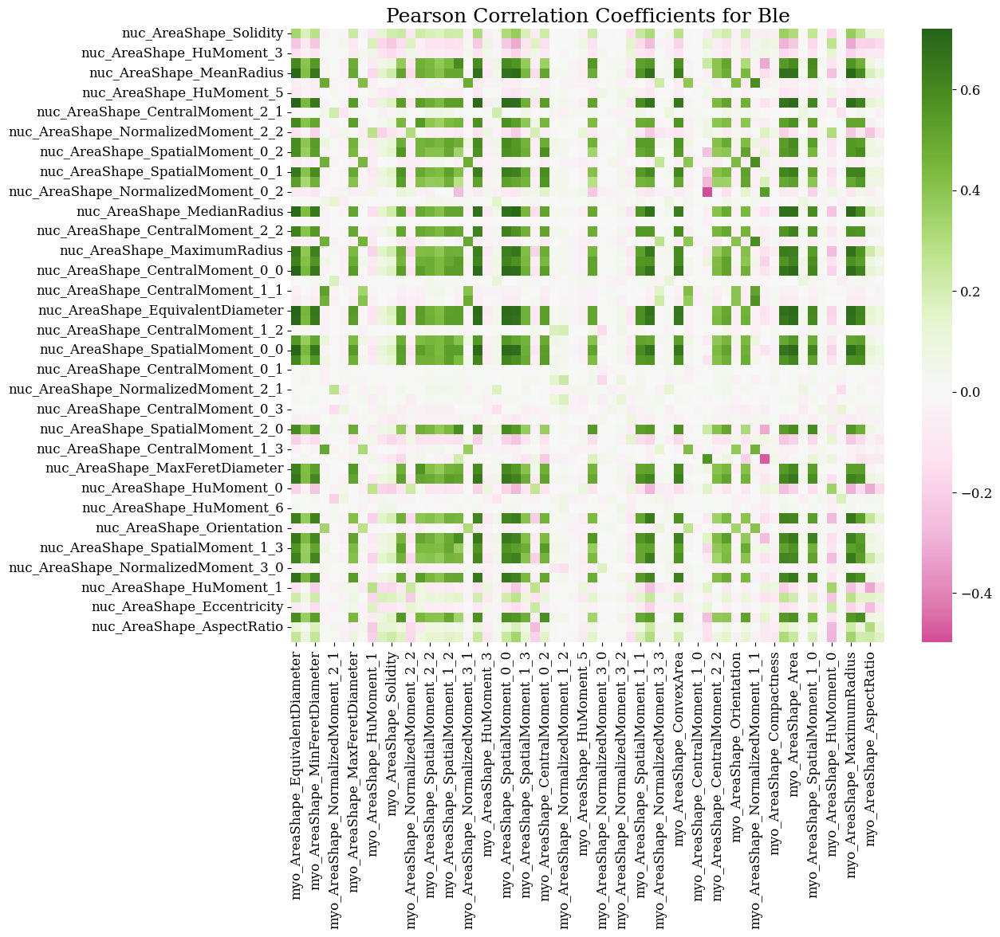

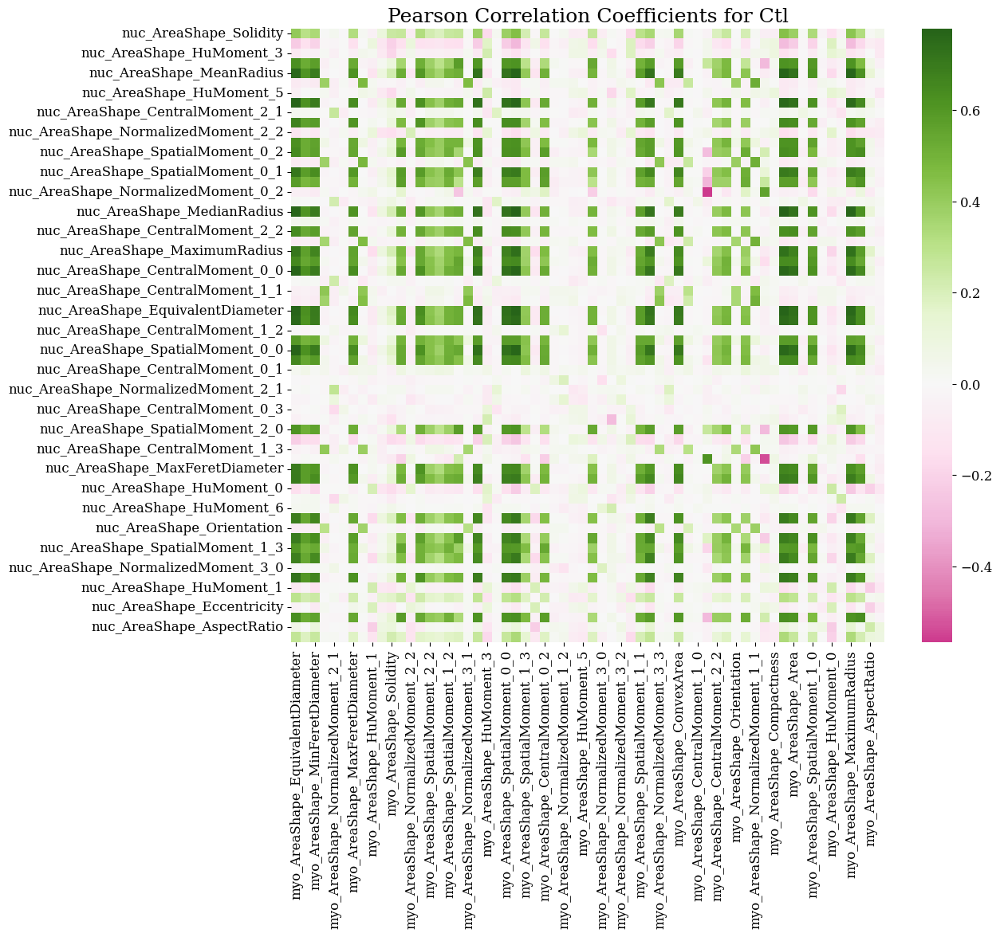

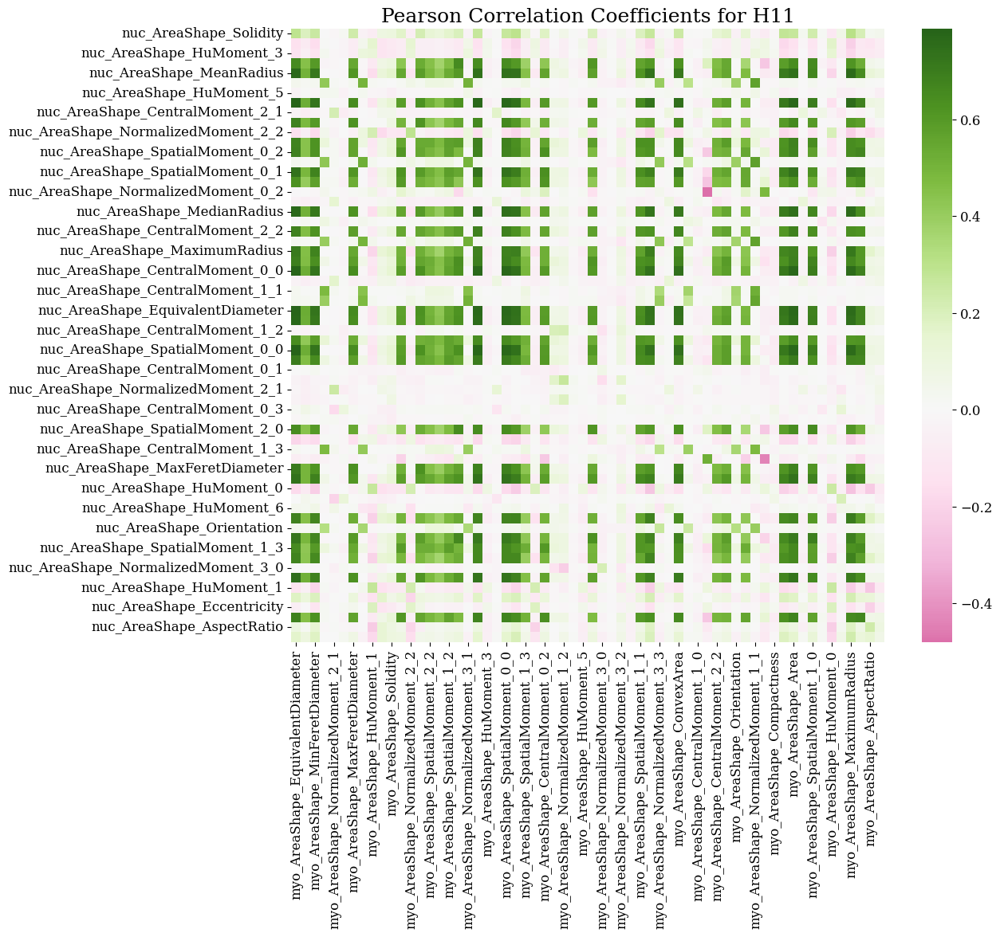

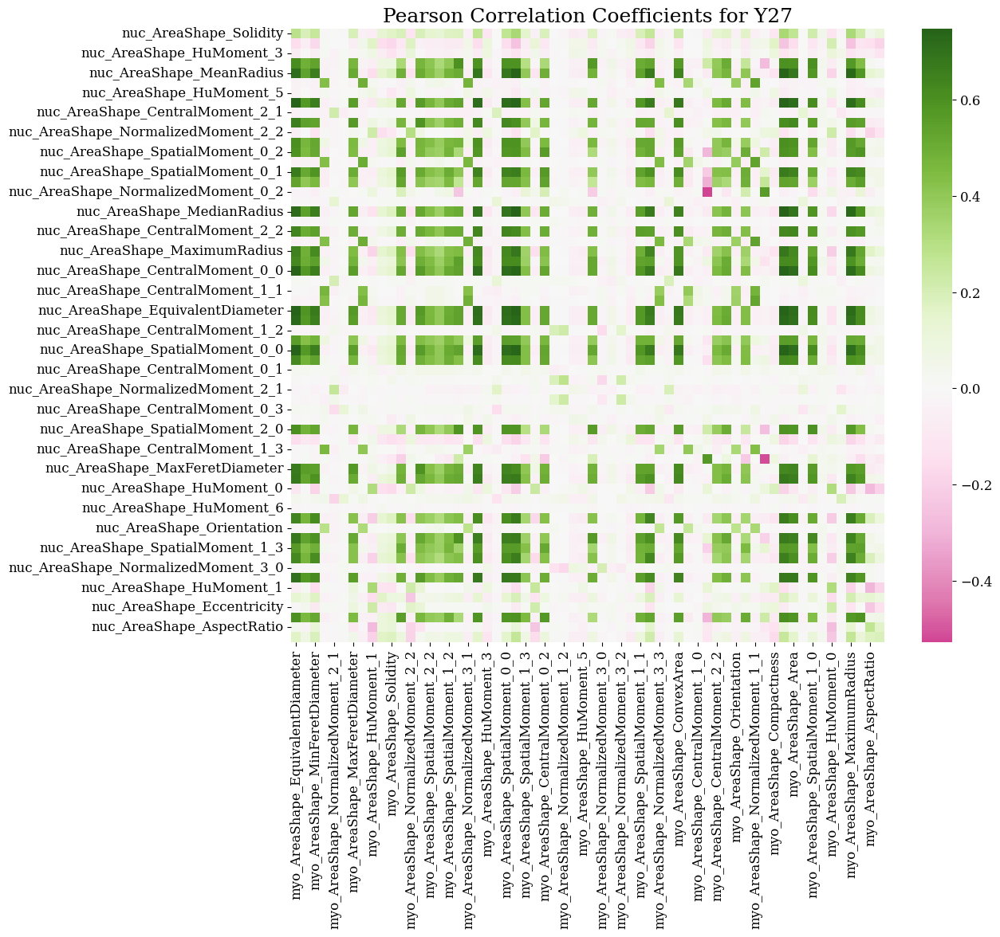

In [ ]:
# Get unique groups
groups = df_cleaned['group'].unique()

nuc_features = [col for col in df_cleaned.columns if 'nuc_AreaShape' in col]
cell_features = [col for col in df_cleaned.columns if 'myo_AreaShape' in col]

# Iterate over each group to calculate and plot the correlation matrix
for group in groups:
    # Filter the dataframe for the current group
    group_df = df_cleaned[df_cleaned['group'] == group]
    
    # Calculate the Pearson correlation coefficient matrix for the current group
    correlation_matrix = group_df[nuc_features + cell_features].corr().loc[nuc_features, cell_features]
    
    # Plot the heatmap
    plt.figure(figsize=(12, 10))
    sns.heatmap(correlation_matrix, annot=False, cmap="PiYG", center=0)
    plt.title(f'Pearson Correlation Coefficients for {group}')

       # Save the figure
    filename = f"Heatmap_PCC_{group}.png"
    plt.savefig(os.path.join(save_dir, filename))

    plt.show()


## Heatmaps - 5 select features

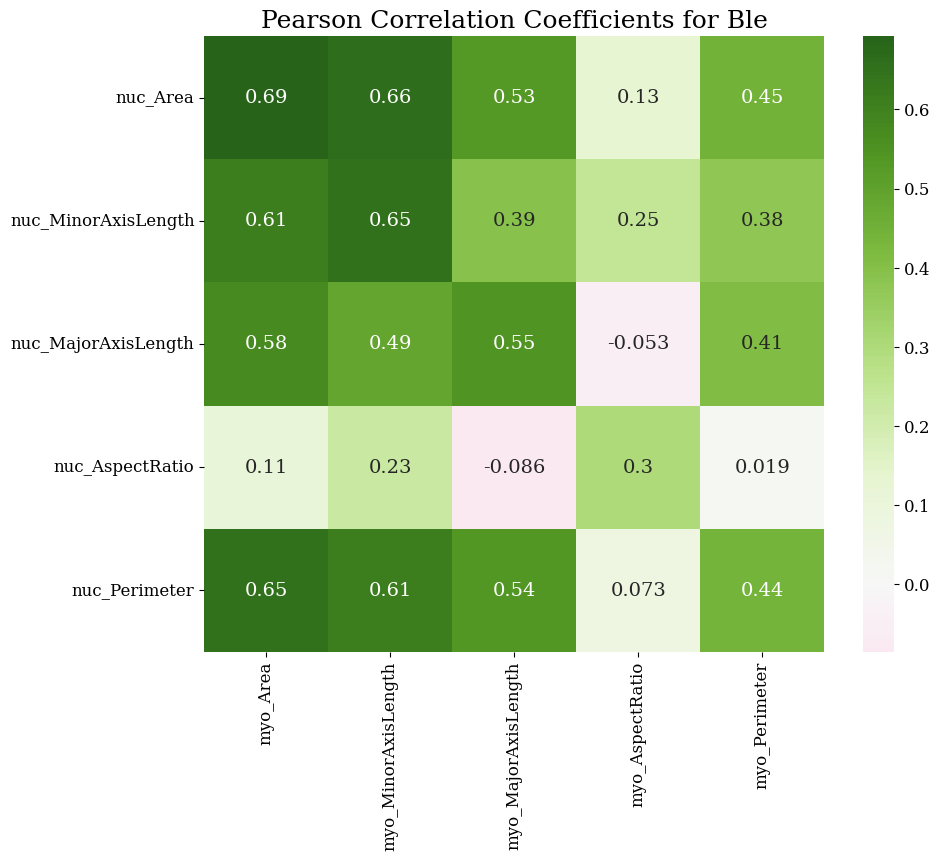

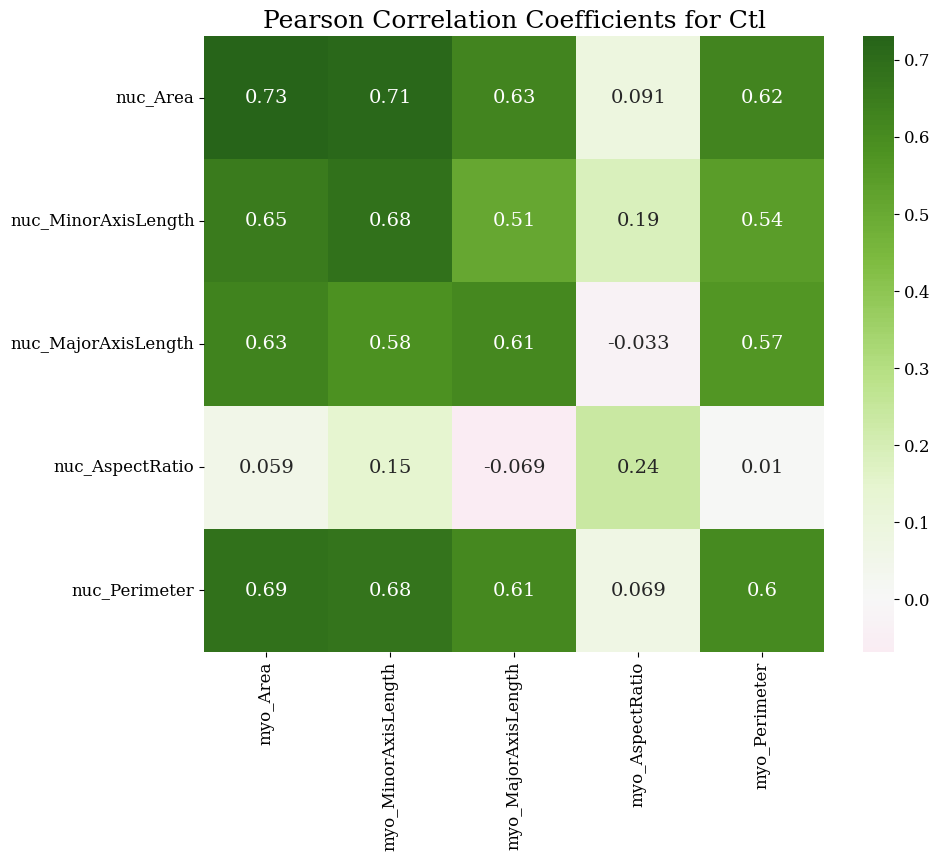

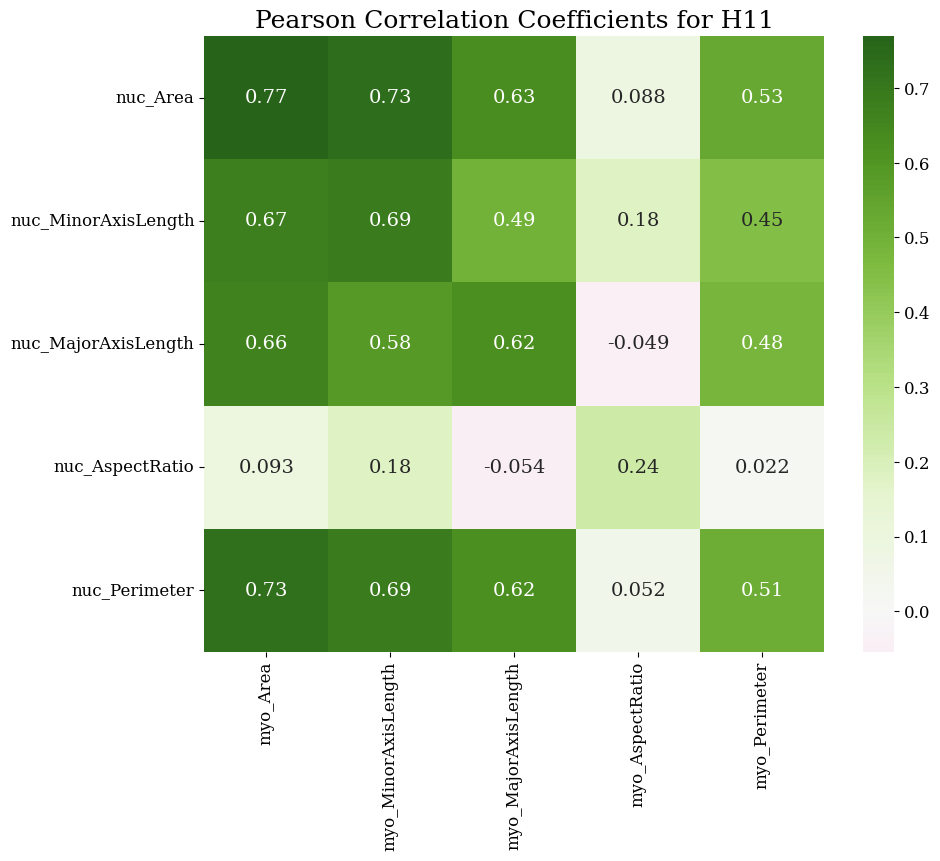

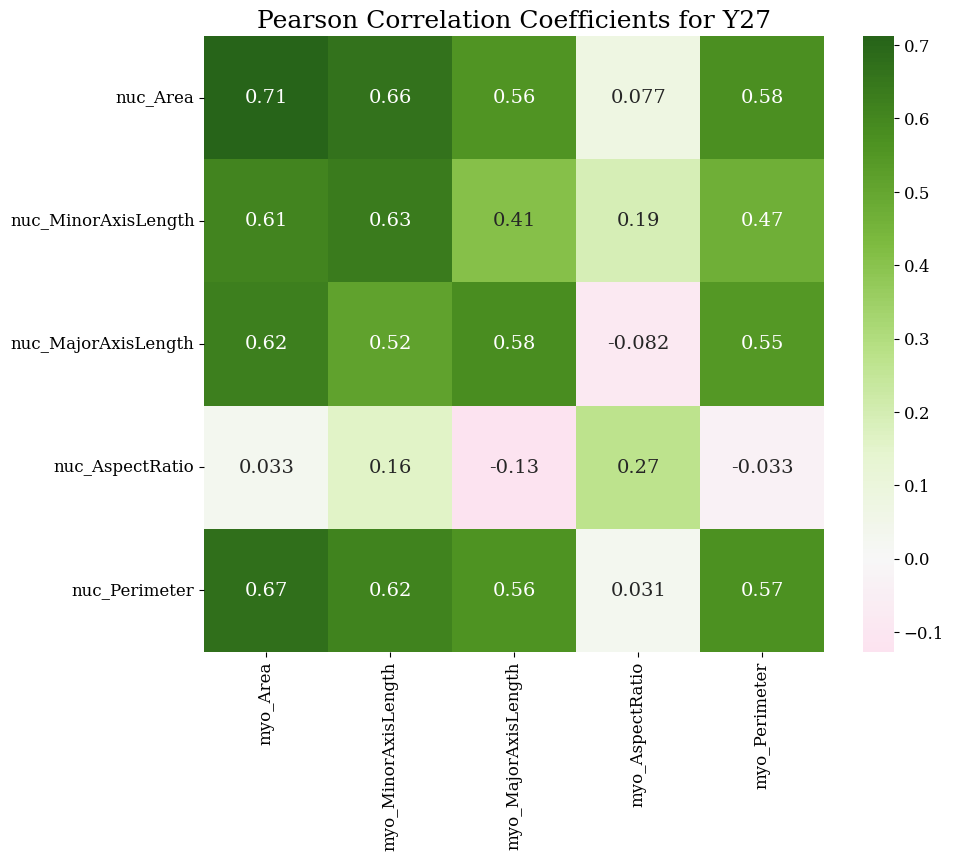

Nuc_Feature   nuc_Area                                      \
Cell_Feature  myo_Area myo_AspectRatio myo_MajorAxisLength   
Group                                                        
Ble           0.692828        0.129309            0.530215   
Ctl           0.730574        0.090834            0.625957   
H11           0.769370        0.087571            0.627482   
Y27           0.712359        0.077154            0.559438   

Nuc_Feature                                    nuc_AspectRatio  \
Cell_Feature myo_MinorAxisLength myo_Perimeter        myo_Area   
Group                                                            
Ble                     0.664404      0.447894        0.111422   
Ctl                     0.713344      0.624625        0.059210   
H11                     0.732293      0.528647        0.093003   
Y27                     0.663736      0.577025        0.032589   

Nuc_Feature                                                           \
Cell_Feature myo_AspectRatio myo_MajorAxisLength myo_MinorAxisLength   
Group                                                                  
Ble                 0.301667           -0.085548            0.227353   
Ctl                 0.237182           -0.068661            0.146328   
H11                 0.235802           -0.054263            0.179797   
Y27                 0.269832           -0.127296            0.157449   

Nuc_Feature                nuc_MajorAxisLength                  \
Cell_Feature myo_Perimeter            myo_Area myo_AspectRatio   
Group                                                            
Ble               0.019022            0.575915       -0.052916   
Ctl               0.010139            0.632437       -0.032923   
H11               0.021680            0.660803       -0.049276   
Y27              -0.033491            0.624659       -0.082326   

Nuc_Feature                                                         \
Cell_Feature myo_MajorAxisLength myo_MinorAxisLength myo_Perimeter   
Group                                                                
Ble                     0.546625            0.487811      0.408184   
Ctl                     0.609643            0.582246      0.567167   
H11                     0.618988            0.584626      0.484175   
Y27                     0.584270            0.515467      0.548255   

Nuc_Feature  nuc_MinorAxisLength                                      \
Cell_Feature            myo_Area myo_AspectRatio myo_MajorAxisLength   
Group                                                                  
Ble                     0.612625        0.245474            0.393755   
Ctl                     0.652088        0.187000            0.510823   
H11                     0.673168        0.180305            0.494535   
Y27                     0.607771        0.193304            0.409329   

Nuc_Feature                                    nuc_Perimeter                  \
Cell_Feature myo_MinorAxisLength myo_Perimeter      myo_Area myo_AspectRatio   
Group                                                                          
Ble                     0.648523      0.375114      0.651605        0.073268   
Ctl                     0.684414      0.544892      0.686161        0.069158   
H11                     0.687737      0.447898      0.727610        0.052482   
Y27                     0.633718      0.471120      0.674633        0.031042   

Nuc_Feature                                                         
Cell_Feature myo_MajorAxisLength myo_MinorAxisLength myo_Perimeter  
Group                                                               
Ble                     0.537832            0.611009      0.441084  
Ctl                     0.612187            0.675744      0.604032  
H11                     0.618331            0.686109      0.510663  
Y27                     0.562323            0.616791      0.570412

<Figure size 640x480 with 0 Axes>

In [ ]:
# Histograms of a smaller set of features
# 
# # function to rename features
def rename_feature(feature):
    parts = feature.split('_')
    return f"{parts[0][:3]}_{parts[-1]}"

# important features
cell_features = ['myo_AreaShape_Area', 'myo_AreaShape_MinorAxisLength', 'myo_AreaShape_MajorAxisLength', 'myo_AreaShape_AspectRatio', 'myo_AreaShape_Perimeter']
nuc_features = ['nuc_AreaShape_Area', 'nuc_AreaShape_MinorAxisLength', 'nuc_AreaShape_MajorAxisLength', 'nuc_AreaShape_AspectRatio', 'nuc_AreaShape_Perimeter']

# Rename the features
cell_features_renamed = [rename_feature(feature) for feature in cell_features]
nuc_features_renamed = [rename_feature(feature) for feature in nuc_features]

# Create a mapping from old feature names to new feature names
feature_mapping = {**dict(zip(cell_features, cell_features_renamed)), **dict(zip(nuc_features, nuc_features_renamed))}

# Rename the columns in the original DataFrame
df_features_renamed = df_cleaned.rename(columns=feature_mapping)

# Get unique groups
groups = df_cleaned['group'].unique()

# Initialize an empty DataFrame to store the correlation coefficients
correlation_table = pd.DataFrame()

# Iterate over each group to calculate and plot the correlation matrix for important features
for group in groups:
    # Filter the dataframe for the current group
    group_df = df_features_renamed[df_features_renamed['group'] == group]
    
    # Calculate the Pearson correlation coefficient matrix for the important features
    correlation_matrix = group_df[cell_features_renamed + nuc_features_renamed].corr()
    
    # Subset the correlation matrix to show only nuc features on the y-axis and cell features on the x-axis
    correlation_matrix_subset = correlation_matrix.loc[nuc_features_renamed, cell_features_renamed]
    
    # Plot the heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix_subset, annot=True, cmap="PiYG", center=0)
    plt.title(f'Pearson Correlation Coefficients for {group}')

    # Save the figure
    filename = f"heatmap_PCC_5features_{group}.png"
    plt.savefig(os.path.join(save_dir, filename))
    
    plt.show()

    # Flatten the correlation matrix and add the group name as a column
    correlation_flat = correlation_matrix_subset.stack().reset_index()
    correlation_flat.columns = ['Nuc_Feature', 'Cell_Feature', 'Correlation']
    correlation_flat['Group'] = group
    
    # Append the flattened correlation matrix to the correlation table
    correlation_table = pd.concat([correlation_table, correlation_flat], ignore_index=True)

# Pivot the table to have groups as rows and feature pairs as columns
correlation_table_pivot = correlation_table.pivot_table(index='Group', columns=['Nuc_Feature', 'Cell_Feature'], values='Correlation')

# Save the pivot table to a CSV file
output_path = os.path.join(original_file_path, 'correlation_table_byGroup.csv')
correlation_table_pivot.to_csv(output_path, index=False)

# Save the figure
filename = f"heatmap_PCC_5features_{group}.png"
plt.savefig(os.path.join(save_dir, filename))

# Display the table
correlation_table_pivot

## correlation table with p-values

In [ ]:
# taking in the correlation table from above, calculate the p-values to compare each group against the control

# Convert correlation coefficients to z-scores using Fisher's z-transformation
correlation_table['Z'] = 0.5 * np.log((1 + correlation_table['Correlation']) / (1 - correlation_table['Correlation']))

# Calculate the standard error of the z-scores
n = df_features_renamed.shape[0]
correlation_table['SE'] = 1 / np.sqrt(n - 3)

# Calculate z-value for the difference between each group and the control: describes the difference in correlation coefficients
control_group = 'Ctl'
correlation_table['Z_diff'] = 0

# Get the control group's Z-scores and SE
control_z = correlation_table[correlation_table['Group'] == control_group]['Z']
control_se = correlation_table[correlation_table['Group'] == control_group]['SE']

for group in groups:
    if group != control_group:
        group_z = correlation_table[correlation_table['Group'] == group]['Z']
        group_se = correlation_table[correlation_table['Group'] == group]['SE']
        z_diff = (group_z.values - control_z.values) / np.sqrt(group_se.values**2 + control_se.values**2)
        correlation_table.loc[correlation_table['Group'] == group, 'Z_diff'] = z_diff

# Calculate p-values
correlation_table['P-Value'] = 2 * (1 - norm.cdf(np.abs(correlation_table['Z_diff'])))
correlation_table['P-Value'] = correlation_table['P-Value'].clip(upper=1)  # Ensure p-values are not greater than 1

# Save the table to a CSV file
output_path = os.path.join(original_file_path, 'correlation_p_values.csv')
correlation_table.to_csv(output_path, index=False)

# Display the table
correlation_table


,Nuc_Feature,Cell_Feature,Correlation,Group,Z,SE,Z_diff,P-Value
0,nuc_Area,myo_Area,0.692828,Ble,0.853374,0.01312,-4.127315,3.670238e-05
1,nuc_Area,myo_MinorAxisLength,0.664404,Ble,0.800656,0.01312,-5.028437,4.944940e-07
2,nuc_Area,myo_MajorAxisLength,0.530215,Ble,0.590445,0.01312,-7.776621,7.549517e-15
3,nuc_Area,myo_AspectRatio,0.129309,Ble,0.130037,0.01312,2.099289,3.579142e-02
4,nuc_Area,myo_Perimeter,0.447894,Ble,0.482063,0.01312,-13.499773,0.000000e+00
...,...,...,...,...,...,...,...,...
95,nuc_Perimeter,myo_Area,0.674633,Y27,0.819198,0.01312,-1.156902,2.473125e-01
96,nuc_Perimeter,myo_MinorAxisLength,0.616791,Y27,0.719808,0.01312,-5.466465,4.590985e-08
97,nuc_Perimeter,myo_MajorAxisLength,0.562323,Y27,0.636224,0.01312,-4.106002,4.025667e-05
98,nuc_Perimeter,myo_AspectRatio,0.031042,Y27,0.031052,0.01312,-2.059616,3.943531e-02


## scatter plots Corr Coef for each feature by group

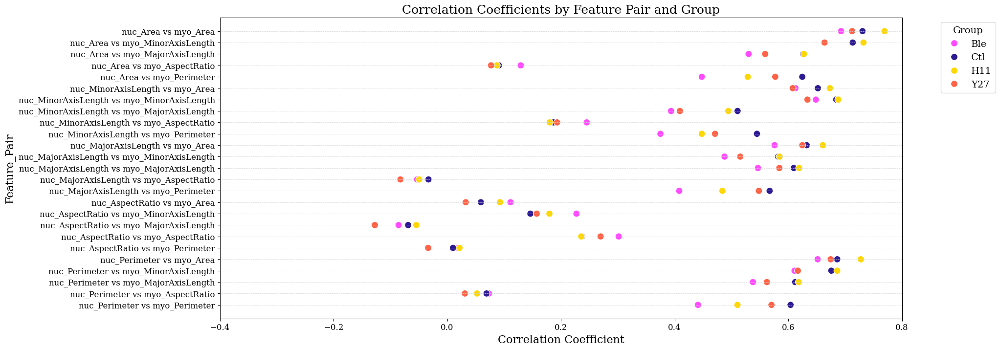

In [ ]:
# Scatter plot of feature pairs vs correlation coeffs (full set of features)


# Create a new column for feature pairs
correlation_table['Feature_Pair'] = correlation_table['Nuc_Feature'] + ' vs ' + correlation_table['Cell_Feature']

# Remove duplicate feature pairs
correlation_table = correlation_table.drop_duplicates(subset=['Feature_Pair', 'Group'])

# Define the color palette for each treatment group (colorblind-friendly)
group_colors = {
    'Ble': '#FF4BFF',  # Purple
    'Ctl': '#2D1B94',  # Dark blue
    'H11': '#FFD700',  # Gold
    'Y27': '#FF6347'   # Tomato
}

# Create the scatter plot
plt.figure(figsize=(18, 8))
ax = sns.scatterplot(
    data=correlation_table,
    x='Correlation',
    y='Feature_Pair',
    hue='Group',
    palette=group_colors,
    s=100,
    zorder=2
)

# Customize the plot
plt.title('Correlation Coefficients by Feature Pair and Group')
plt.xlabel('Correlation Coefficient')
plt.legend(title='Group', bbox_to_anchor=(1.05, 1), loc='upper left')

# Add horizontal spans for specific feature pairs
feature_pairs_to_grey = [
    'Nuc_Perimeter', 'Nuc_Major', 'Nuc_Area'
]

# Get the unique feature pairs in the order they appear on the y-axis
unique_feature_pairs = correlation_table['Feature_Pair'].unique()

# Add grey spans for the specified feature pairs
for feature in feature_pairs_to_grey:
    for i, feature_pair in enumerate(unique_feature_pairs):
        if feature in feature_pair:
            ax.axhspan(i - 0.5, i + 0.5, color='lightgrey', alpha=0.5)

# Add horizontal lines between discrete variables on the y-axis
y_ticks = ax.get_yticks()
for y in y_ticks:
    ax.axhline(y=y, color='lightgrey', linestyle='--', linewidth=0.5)

# Adjust the x-axis limits to spread out the points
plt.xlim(-0.40, 0.8)

# Save the figure
filename = f"Scat_PCC_CorrCoef.png"
plt.savefig(os.path.join(save_dir, filename))

# Display the plot
plt.show()      

## Table - corr coef sig diff from control

are there any corr's that are statistically sig different from control?




In [ ]:
# is there a significant difference in correlation coefficients between treatment groups

# Function to convert correlation coefficient to Fisher's Z-score
def fisher_z(r):
    return np.arctanh(r)

# Function to perform Fisher's Z-test
def fisher_z_test(r1, r2, n1, n2):
    z1 = fisher_z(r1)
    z2 = fisher_z(r2)
    se_diff = np.sqrt(1/(n1-3) + 1/(n2-3))
    z = (z1 - z2) / se_diff
    p_value = 2 * (1 - norm.cdf(abs(z)))
    return p_value

# sample sizes for each treatment group 
n1 = len(df_features[df_features['group'] == 'Ble'])
n2 = len(df_features[df_features['group'] == 'Ctl'])
n3 = len(df_features[df_features['group'] == 'H11'])
n4 = len(df_features[df_features['group'] == 'Y27'])

# Initialize a dictionary to store significant p-values for each feature pair
all_p_values = {
    "group1": [],
    "group2": [], 
    "nuc_feature": [],
    "cell_feature": [],
    "p_value": []
}

# List of groups
groups = correlation_table['Group'].unique()

# Significance threshold
alpha = 0.05

# Iterate over each feature pair
for (nuc_feature, cell_feature), group_df in correlation_table.groupby(['Nuc_Feature', 'Cell_Feature']):
    for i in range(len(groups)):
        for j in range(i + 1, len(groups)):
            group1 = groups[i]
            group2 = groups[j]
            
            # Extract correlation coefficients for the feature pair
            r1 = group_df[group_df['Group'] == group1]['Correlation'].values[0]
            r2 = group_df[group_df['Group'] == group2]['Correlation'].values[0]

            # Perform Fisher's Z-test
            p_value = fisher_z_test(r1, r2, n1, n2)
            
            # Store the p-value if it is significant
            if p_value < alpha:
                all_p_values['group1'].append(group1)
                all_p_values['group2'].append (group2)
                all_p_values['nuc_feature'].append(nuc_feature) 
                all_p_values['cell_feature'].append(cell_feature)
                all_p_values['p_value'].append(p_value)

# Convert the dictionary to a DataFrame
df_p_values = pd.DataFrame(all_p_values)

# Sort the DataFrame alphabetically by 'group1'
df_p_values = df_p_values.sort_values(by=['group1', 'group2', 'nuc_feature', 'cell_feature'])

# Convert p-values to standard notation
df_p_values['p_value'] = df_p_values['p_value'].apply(lambda x: f"{x:.4f}")

#print(df_p_values)
# Create a pivot table
pivot_table = df_p_values.pivot_table(
    index=['nuc_feature', 'cell_feature'],
    columns=['group1', 'group2'],
    values='p_value',
    aggfunc='first'
)

# Display the pivot table
print(pivot_table)


group1                                      Ble                     Ctl  \
group2                                      Ctl     H11     Y27     H11   
nuc_feature         cell_feature                                          
nuc_Area            myo_Area             0.0409  0.0000     NaN  0.0177   
                    myo_MajorAxisLength  0.0001  0.0001     NaN     NaN   
                    myo_MinorAxisLength  0.0127  0.0004     NaN     NaN   
                    myo_Perimeter        0.0000  0.0046  0.0000  0.0001   
nuc_AspectRatio     myo_Area                NaN     NaN  0.0342     NaN   
                    myo_MajorAxisLength     NaN     NaN     NaN     NaN   
                    myo_MinorAxisLength  0.0249     NaN     NaN     NaN   
nuc_MajorAxisLength myo_Area             0.0173  0.0002  0.0417     NaN   
                    myo_MajorAxisLength  0.0114  0.0034     NaN     NaN   
                    myo_MinorAxisLength  0.0004  0.0003     NaN     NaN   
                    myo_P

## plot corr coef difference from control 

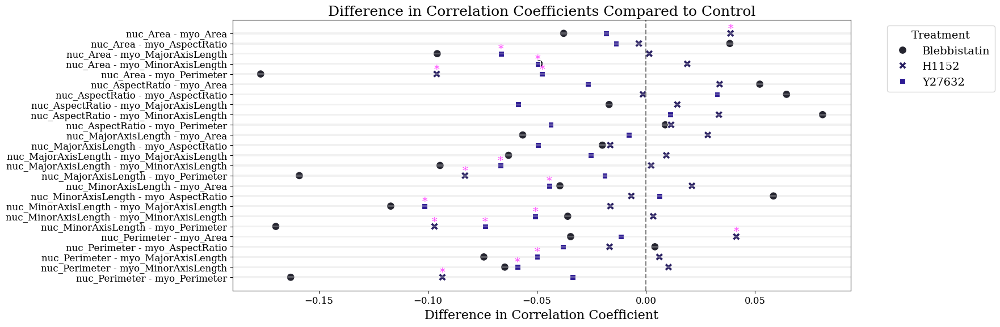

In [ ]:
# Plot differences in correlation coefficient from control group

# Calculate the difference between the correlation coefficients of each group and the DLM8_DMSO group
control_group = 'Ctl'
diffs = []

for (nuc_feature, cell_feature), group_df in correlation_table.groupby(['Nuc_Feature', 'Cell_Feature']):
    control_corr = group_df[group_df['Group'] == control_group]['Correlation'].values[0]
    for group in groups:
        if group != control_group:
            diff = group_df[group_df['Group'] == group]['Correlation'].values[0] - control_corr
            diffs.append({
                'Group': group,
                'Nuc_Feature': nuc_feature,
                'Cell_Feature': cell_feature,
                'Difference': diff,
                'Significant': any(
                    (df_p_values['group1'] == control_group) &
                    (df_p_values['group2'] == group) &
                    (df_p_values['nuc_feature'] == nuc_feature) &
                    (df_p_values['cell_feature'] == cell_feature)
                )
            })

# Convert the list of differences to a DataFrame
diffs_df = pd.DataFrame(diffs)

# Create a new column for the feature pair
diffs_df['Feature_Pair'] = diffs_df['Nuc_Feature'] + ' - ' + diffs_df['Cell_Feature']

# Map old group names to new group names
group_name_mapping = {
    'Ble': 'Blebbistatin',
    'Ctl': 'Control',
    'H11': 'H1152',
    'Y27': 'Y27632'
}

# Replace old group names with new group names
diffs_df['Group'] = diffs_df['Group'].replace(group_name_mapping)

# Plot the differences using seaborn
plt.figure(figsize=(18, 6))
scatter_plot = sns.scatterplot(
    data=diffs_df,
    x='Difference',
    y='Feature_Pair',
    hue='Group',
    palette=sns.dark_palette("#2D1B94", n_colors=len(diffs_df['Group'].unique())),
    style='Group',
    s=100
)
plt.axvline(0, color='grey', linestyle='--')
plt.title('Difference in Correlation Coefficients Compared to Control')
plt.xlabel('Difference in Correlation Coefficient')
plt.ylabel('')
plt.legend(title='Treatment', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add horizontal light grey bands between the y-axis ticks
ax = plt.gca()
y_ticks = ax.get_yticks()
for i in range(len(y_ticks) - 0):
    ax.axhspan(y_ticks[i] - 0.1, y_ticks[i] + 0.1, facecolor='lightgrey', alpha=0.3)

# Add asterisks for significant differences
for i in range(diffs_df.shape[0]):
    if diffs_df.iloc[i]['Significant']:
        scatter_plot.text(
            diffs_df.iloc[i]['Difference'],
            diffs_df.iloc[i]['Feature_Pair'],
            '*',
            color='#FF4BFF',
            ha='center',
            va='bottom',
            fontsize=14
        )

plt.tight_layout()

# Save the figure
filename = f"Scat_PCC_ComparedToControl.png"
plt.savefig(os.path.join(save_dir, filename))

plt.show()

## scatter plots of feature pairs

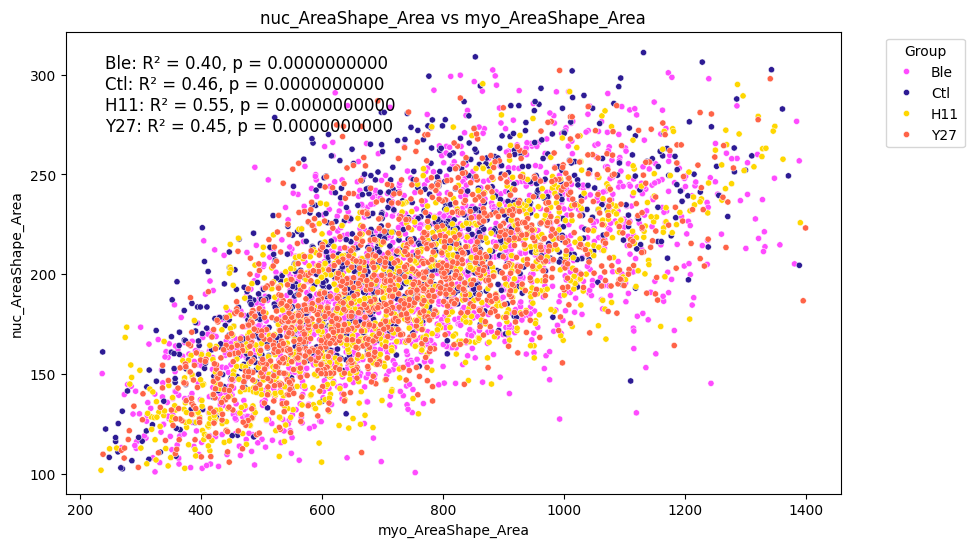

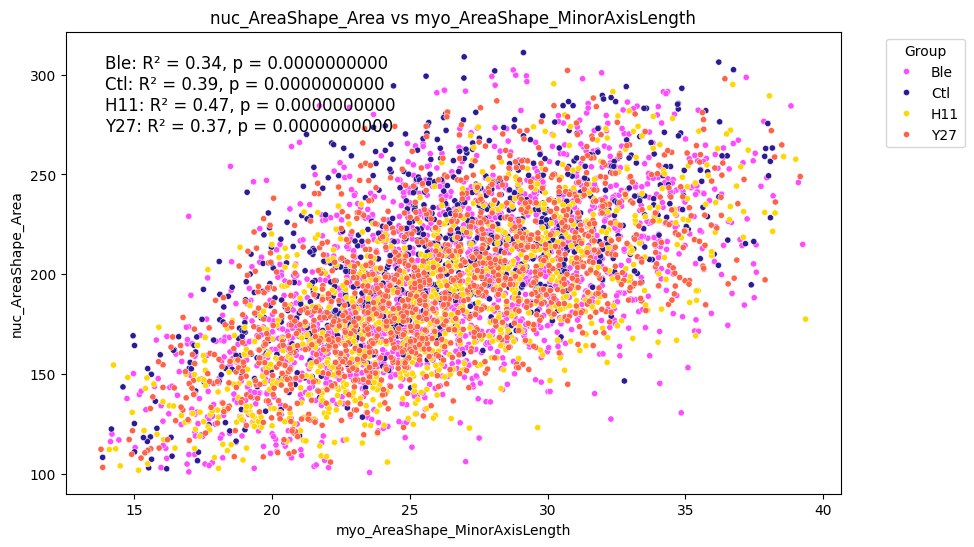

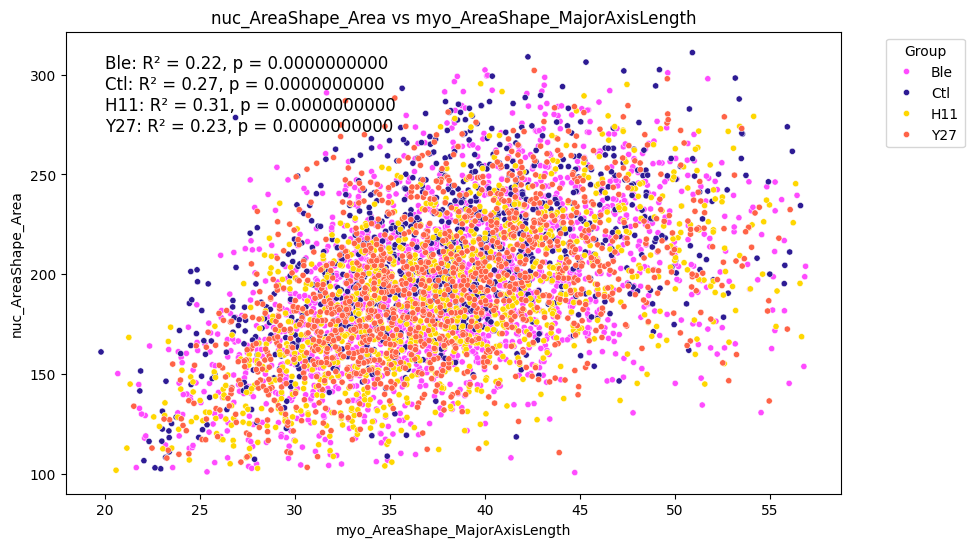

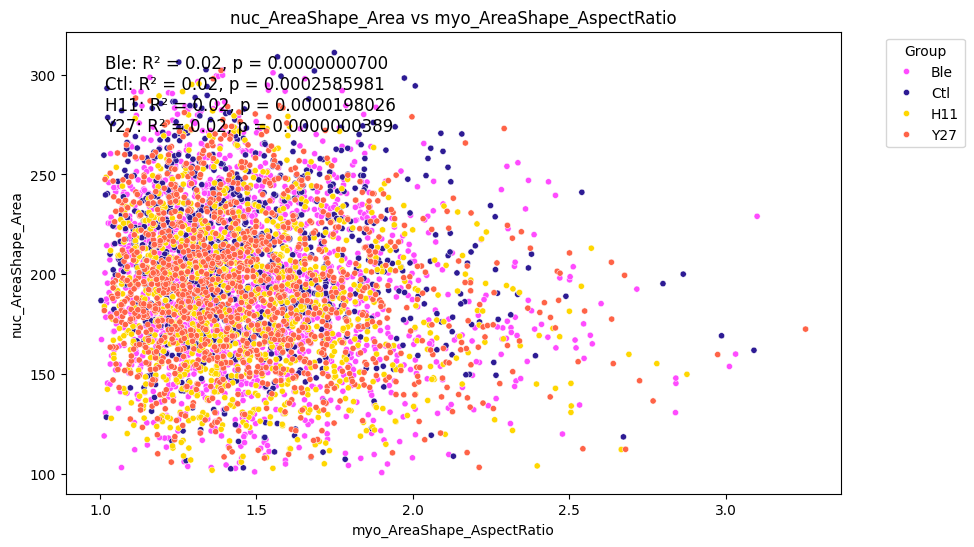

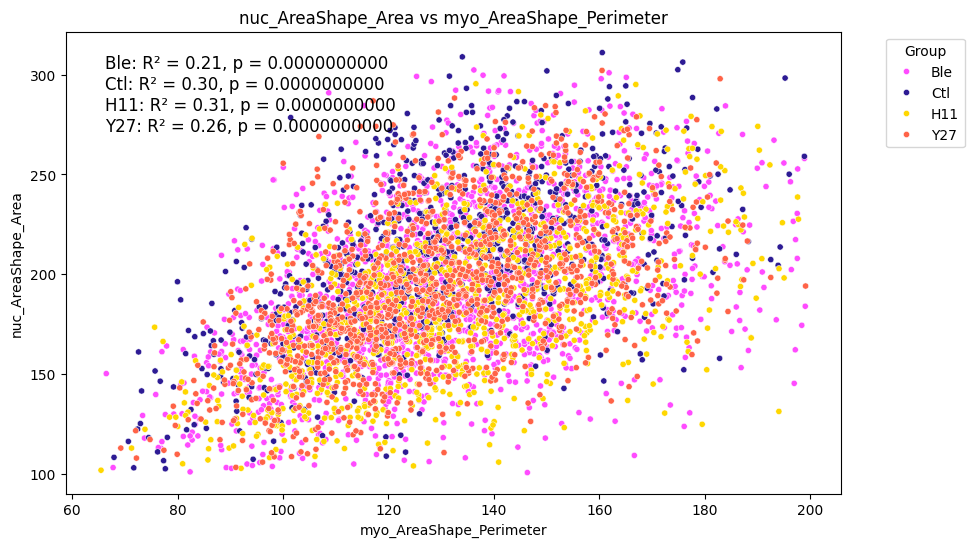

...

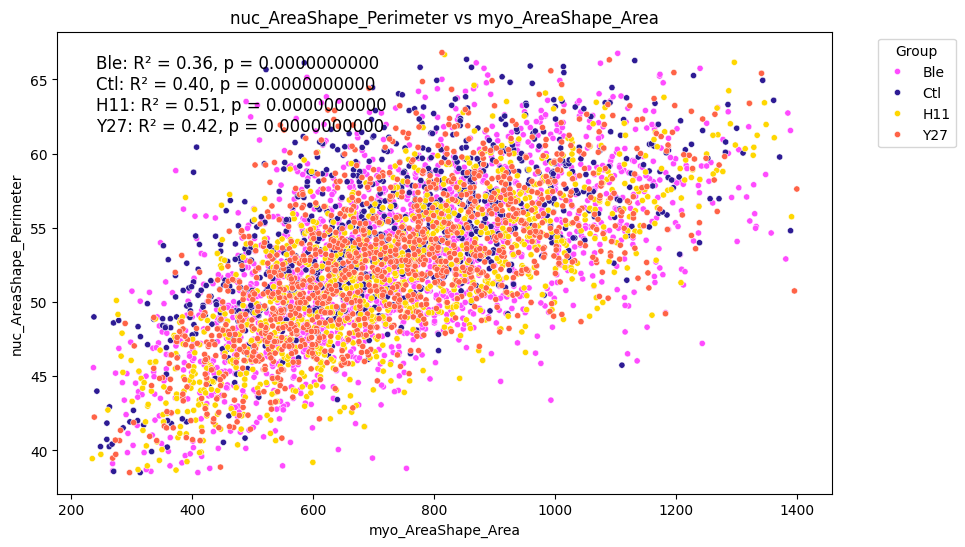

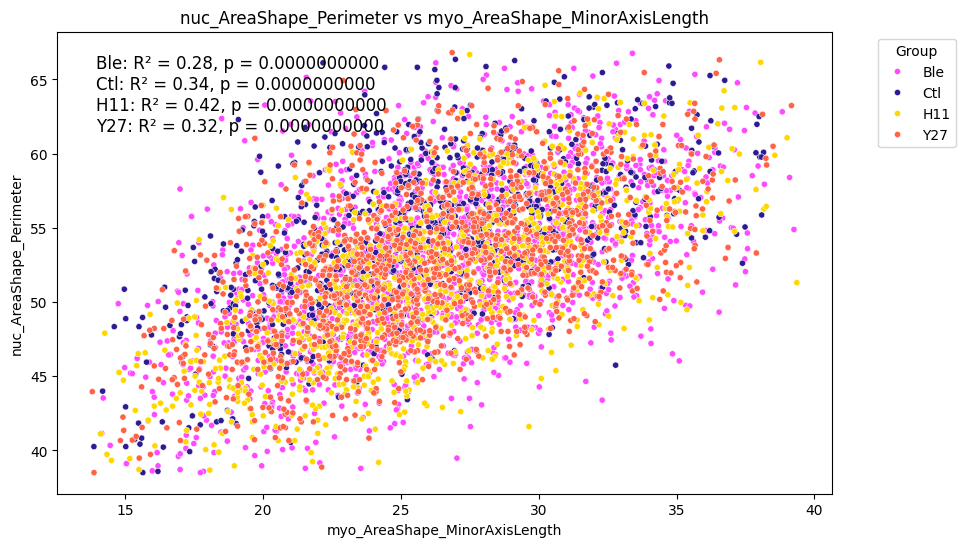

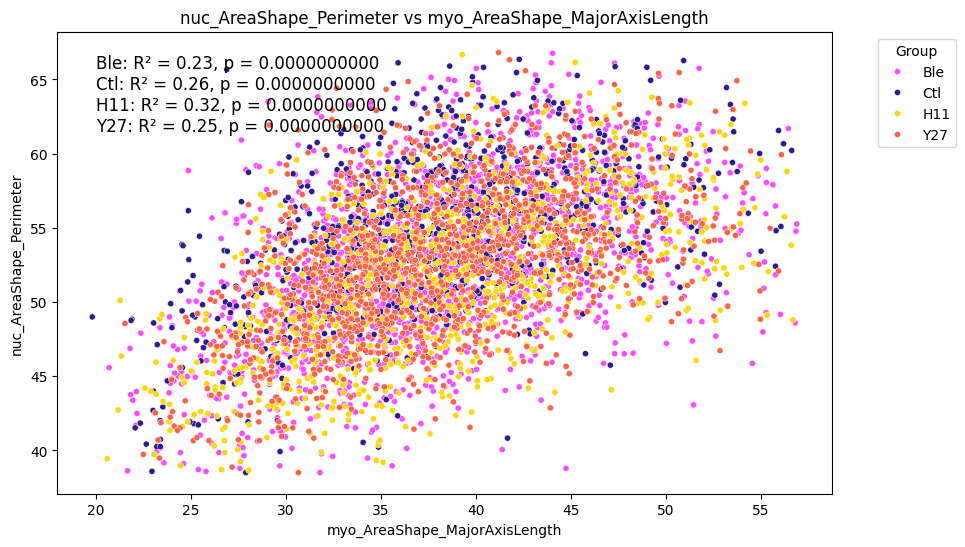

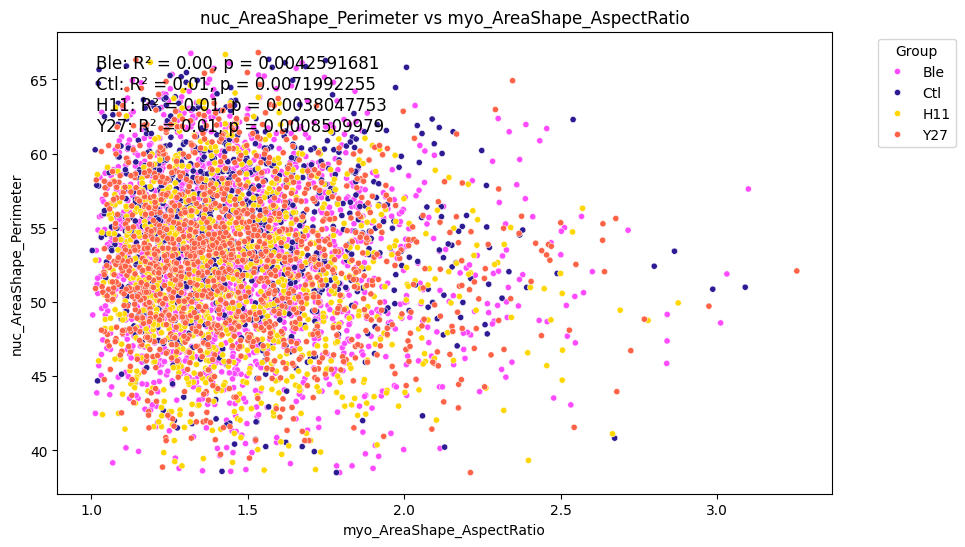

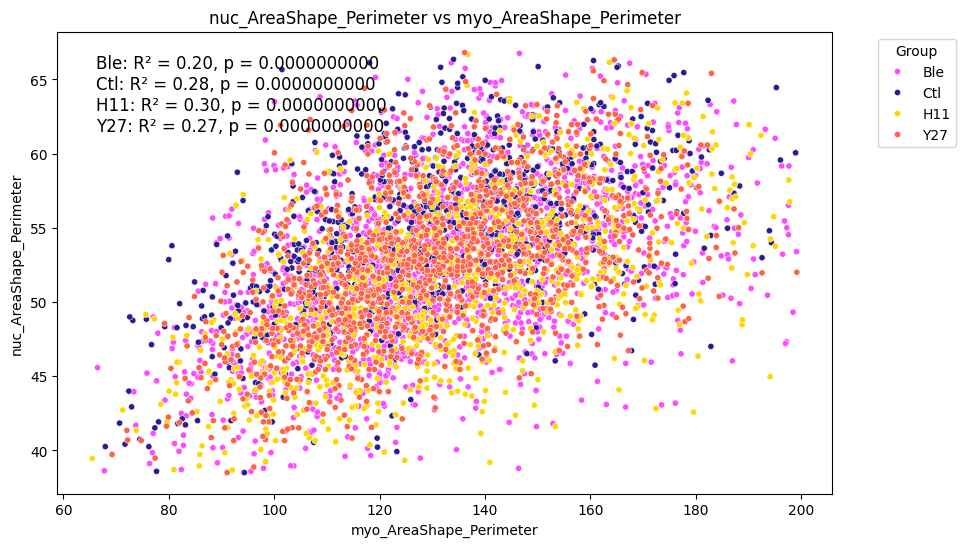

In [ ]:
# Scatter plots for each feature pair

# Create scatter plots for each feature pair
for nuc_feature in nuc_features:
    for cell_feature in cell_features:
        plt.figure(figsize=(10, 6))
        sns.scatterplot(
            data=normalized_df,
            x=cell_feature,
            y=nuc_feature,
            hue='group',
            palette=group_colors,
            s=20
        )
        
        # Calculate R-squared and p-value for each group
        text_str = ""
        for group in normalized_df['group'].unique():
            group_data = normalized_df[normalized_df['group'] == group]
            r_value, p_value = pearsonr(group_data[cell_feature], group_data[nuc_feature])
            r_squared = r_value ** 2
            text_str += f'{group}: R² = {r_squared:.2f}, p = {p_value:.10f}\n'
        
        # Add R-squared and p-value to the plot
        plt.text(0.05, 0.95, text_str,
                 transform=plt.gca().transAxes, fontsize=12, verticalalignment='top')
        
        plt.title(f'{nuc_feature} vs {cell_feature}')
        plt.xlabel(cell_feature)
        plt.ylabel(nuc_feature)
        plt.legend(title='Group', bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.show()

